In [25]:
import tensorflow as tf
import pandas as pd
import numpy as np
import pylast
import json

# Data Preprocessing

In [27]:
raw_features = []
for i in range(100):
    file = pd.read_csv("Spotify_API/dfs_first_100_playlists_features/df_playlist_features_"+str(i)+".csv")
    raw_features.append(file)
raw_features[0]


,Unnamed: 0,track_name,artist,id,acousticness,danceability,speechiness,instrumentalness,liveness,energy,valence,duration_ms,key,mode,loudness,tempo,time_signature
0,0,Lose Control (feat. Ciara & Fat Man Scoop),Missy Elliott,0UaMYEvWZi0ZqiDOoHU3YI,0.031100,0.904,0.1210,0.006970,0.0471,0.813,0.810,226864.0,4.0,0.0,-7.105,125.461,4.0
1,1,Toxic,Britney Spears,6I9VzXrHxO9rA9A5euc8Ak,0.024900,0.774,0.1140,0.025000,0.2420,0.838,0.924,198800.0,5.0,0.0,-3.914,143.040,4.0
2,2,Crazy In Love,BeyoncÃ©,0WqIKmW4BTrj3eJFmnCKMv,0.002380,0.664,0.2100,0.000000,0.0598,0.758,0.701,235933.0,2.0,0.0,-6.583,99.259,4.0
3,3,Rock Your Body,Justin Timberlake,1AWQoqb9bSvzTjaLralEkT,0.202000,0.891,0.1400,0.000234,0.0521,0.714,0.818,267267.0,4.0,0.0,-6.055,100.972,4.0
4,4,It Wasn't Me,Shaggy,1lzr43nnXAijIGYnCT8M8H,0.056100,0.853,0.0713,0.000000,0.3130,0.606,0.654,227600.0,0.0,1.0,-4.596,94.759,4.0
5,5,Yeah!,Usher,0XUfyU2QviPAs6bxSpXYG4,0.021200,0.881,0.1680,0.000000,0.0377,0.788,0.592,250373.0,2.0,1.0,-4.669,104.997,4.0
6,6,My Boo,Usher,68vgtRHr7iZHpzGpon6Jlo,0.257000,0.662,0.1180,0.000000,0.0465,0.507,0.676,223440.0,5.0,1.0,-8.238,86.412,4.0
7,7,Buttons,The Pussycat Dolls,3BxWKCI06eQ5Od8TY2JBeA,0.158000,0.544,0.3200,0.000000,0.2680,0.823,0.434,225560.0,2.0,1.0,-4.318,210.750,4.0
8,8,Say My Name,Destiny's Child,7H6ev70Weq6DdpZyyTmUXk,0.273000,0.713,0.1020,0.000000,0.1490,0.678,0.734,271333.0,5.0,0.0,-3.525,138.009,4.0
9,9,Hey Ya! - Radio Mix / Club Mix,OutKast,2PpruBYCo4H7WOBJ7Q2EwM,0.103000,0.728,0.0665,0.000532,0.1750,0.974,0.965,235213.0,4.0,0.0,-2.261,79.526,4.0


Last.fm tags into response labels

In [10]:
username = ""
password_hash = pylast.md5("")

API_KEY = ""
API_SECRET = ""


network = pylast.LastFMNetwork(api_key=API_KEY, api_secret=API_SECRET,
                               username=username, password_hash=password_hash)

#unique tags threshold
threshold = 3000
#threshold = 1000
unique_tags = []
with open("last.fm/lastfm_unique_tags.txt", 'r') as f:
    for line in f:
        tag_freq = line.split('\t')
        if int(tag_freq[1]) > threshold:
            unique_tags.append(tag_freq[0])
        else:
            break

#get tags with weights (high frequency ones) from unique track
def get_tags_from_track(artist_name, track_name):
    try:
        track = network.get_track(artist_name, track_name)
        tags = track.get_top_tags()
        tags_with_weights = []
        for tag_item in tags:
            if str(tag_item.item) in unique_tags:
                tags_with_weights.append((str(tag_item.item), int(tag_item.weight)))
        return tags_with_weights
    except:
        return None            
            


In [4]:
#create all zero value dictionary

def get_zero_dict():
    zeros_dict = {}
    for tag in unique_tags:
        zeros_dict.update({tag: 0.0})
    return zeros_dict

In [5]:
#import songs result data

playlists_tags = []
for playlist in raw_features:
    tracks = list(playlist['track_name'])
    artists = list(playlist['artist'])
    artist_tracks = list(zip(artists, tracks))
    
    #playlist_tags = {}
    playlist_tags = get_zero_dict()
    for artist_track in artist_tracks:
        n = len(artist_tracks)
        track_with_tags = get_tags_from_track(artist_track[0],artist_track[1])
        if track_with_tags is not None and len(track_with_tags) != 0:
            for pair in track_with_tags:
                #if pair[0] not in list(playlist_tags.keys()):
                    #playlist_tags.update({pair[0]: pair[1]/(100.0*n)})
                playlist_tags.update({pair[0]: playlist_tags.get(pair[0])+pair[1]/(100.0*n)})
                #playlist_tags.update({pair[0]: playlist_tags.get(pair[0])+pair[1]})
    """
    for tag in unique_tags:
        if tag not in list(playlist_tags.keys()):
            playlist_tags.update({tag: 0.0})
    """
    print(playlist_tags)
    playlists_tags.append(playlist_tags)

#print(playlists_tags)


{'rock': 1024.0, 'pop': 2843.0, 'alternative': 561.0, 'indie': 198.0, 'electronic': 257.0, 'female vocalists': 904.0, 'favorites': 213.0, 'Love': 419.0, 'dance': 1231.0, '00s': 424.0, 'alternative rock': 179.0, 'jazz': 2.0, 'beautiful': 31.0, 'singer-songwriter': 79.0, 'metal': 2.0, 'chillout': 51.0, 'male vocalists': 190.0, 'Awesome': 96.0, 'classic rock': 4.0, 'soul': 305.0, 'indie rock': 106.0, 'Mellow': 33.0, 'electronica': 14.0, '80s': 5.0, 'folk': 8.0, 'british': 51.0, '90s': 79.0, 'chill': 42.0, 'american': 274.0, 'instrumental': 0.0, 'punk': 203.0, 'oldies': 0.0, 'seen live': 28.0, 'blues': 5.0, 'hard rock': 22.0, 'cool': 92.0, 'Favorite': 64.0, 'ambient': 0.0, 'acoustic': 13.0, 'experimental': 3.0, 'Favourites': 31.0, 'female vocalist': 114.0, 'guitar': 6.0, 'Hip-Hop': 1017.0, '70s': 0.0, 'party': 266.0, 'country': 20.0, 'easy listening': 20.0, 'sexy': 261.0, 'catchy': 302.0, 'funk': 120.0, 'favourite': 36.0, 'electro': 15.0, 'heavy metal': 12.0, 'Progressive rock': 0.0, '60s'

{'rock': 767.0, 'pop': 598.0, 'alternative': 883.0, 'indie': 1581.0, 'electronic': 61.0, 'female vocalists': 105.0, 'favorites': 119.0, 'Love': 179.0, 'dance': 48.0, '00s': 117.0, 'alternative rock': 606.0, 'jazz': 55.0, 'beautiful': 103.0, 'singer-songwriter': 61.0, 'metal': 2.0, 'chillout': 145.0, 'male vocalists': 77.0, 'Awesome': 78.0, 'classic rock': 24.0, 'soul': 208.0, 'indie rock': 905.0, 'Mellow': 215.0, 'electronica': 65.0, '80s': 556.0, 'folk': 134.0, 'british': 260.0, '90s': 184.0, 'chill': 177.0, 'american': 801.0, 'instrumental': 27.0, 'punk': 241.0, 'oldies': 13.0, 'seen live': 38.0, 'blues': 0.0, 'hard rock': 20.0, 'cool': 34.0, 'Favorite': 97.0, 'ambient': 43.0, 'acoustic': 34.0, 'experimental': 199.0, 'Favourites': 38.0, 'female vocalist': 12.0, 'guitar': 9.0, 'Hip-Hop': 107.0, '70s': 52.0, 'party': 33.0, 'country': 20.0, 'easy listening': 14.0, 'sexy': 46.0, 'catchy': 180.0, 'funk': 7.0, 'favourite': 7.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 3.0, '

{'rock': 679.0, 'pop': 443.0, 'alternative': 498.0, 'indie': 408.0, 'electronic': 120.0, 'female vocalists': 86.0, 'favorites': 33.0, 'Love': 27.0, 'dance': 73.0, '00s': 21.0, 'alternative rock': 361.0, 'jazz': 0.0, 'beautiful': 9.0, 'singer-songwriter': 2.0, 'metal': 9.0, 'chillout': 4.0, 'male vocalists': 41.0, 'Awesome': 20.0, 'classic rock': 128.0, 'soul': 154.0, 'indie rock': 174.0, 'Mellow': 2.0, 'electronica': 42.0, '80s': 15.0, 'folk': 2.0, 'british': 61.0, '90s': 274.0, 'chill': 6.0, 'american': 37.0, 'instrumental': 0.0, 'punk': 178.0, 'oldies': 6.0, 'seen live': 16.0, 'blues': 31.0, 'hard rock': 57.0, 'cool': 15.0, 'Favorite': 10.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 1.0, 'Favourites': 8.0, 'female vocalist': 19.0, 'guitar': 26.0, 'Hip-Hop': 0.0, '70s': 9.0, 'party': 3.0, 'country': 0.0, 'easy listening': 2.0, 'sexy': 10.0, 'catchy': 16.0, 'funk': 83.0, 'favourite': 10.0, 'electro': 9.0, 'heavy metal': 0.0, 'Progressive rock': 2.0, '60s': 43.0, 'fun': 8.0, 'rnb

{'rock': 102.0, 'pop': 2.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 38.0, 'Love': 20.0, 'dance': 1.0, '00s': 2.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 6.0, 'singer-songwriter': 13.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 43.0, 'Awesome': 0.0, 'classic rock': 72.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 8.0, 'folk': 0.0, 'british': 0.0, '90s': 27.0, 'chill': 27.0, 'american': 104.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 5.0, 'blues': 86.0, 'hard rock': 0.0, 'cool': 2.0, 'Favorite': 4.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 56.0, 'party': 2.0, 'country': 1360.0, 'easy listening': 1.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 86.0, 'pop': 407.0, 'alternative': 29.0, 'indie': 276.0, 'electronic': 0.0, 'female vocalists': 132.0, 'favorites': 8.0, 'Love': 19.0, 'dance': 136.0, '00s': 9.0, 'alternative rock': 3.0, 'jazz': 1.0, 'beautiful': 11.0, 'singer-songwriter': 32.0, 'metal': 0.0, 'chillout': 18.0, 'male vocalists': 54.0, 'Awesome': 33.0, 'classic rock': 21.0, 'soul': 71.0, 'indie rock': 28.0, 'Mellow': 4.0, 'electronica': 2.0, '80s': 4.0, 'folk': 218.0, 'british': 140.0, '90s': 0.0, 'chill': 12.0, 'american': 0.0, 'instrumental': 52.0, 'punk': 0.0, 'oldies': 99.0, 'seen live': 0.0, 'blues': 3.0, 'hard rock': 0.0, 'cool': 32.0, 'Favorite': 26.0, 'ambient': 0.0, 'acoustic': 104.0, 'experimental': 0.0, 'Favourites': 5.0, 'female vocalist': 13.0, 'guitar': 32.0, 'Hip-Hop': 101.0, '70s': 37.0, 'party': 7.0, 'country': 0.0, 'easy listening': 22.0, 'sexy': 11.0, 'catchy': 17.0, 'funk': 13.0, 'favourite': 7.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 71.0, 'fun': 24.0, 'rnb': 3

{'rock': 0.0, 'pop': 0.0, 'alternative': 17.0, 'indie': 387.0, 'electronic': 184.0, 'female vocalists': 67.0, 'favorites': 0.0, 'Love': 17.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 20.0, 'singer-songwriter': 40.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 10.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 15.0, 'electronica': 0.0, '80s': 0.0, 'folk': 150.0, 'british': 0.0, '90s': 0.0, 'chill': 34.0, 'american': 34.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 145.0, 'experimental': 34.0, 'Favourites': 0.0, 'female vocalist': 17.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 481.0, 'pop': 2275.0, 'alternative': 411.0, 'indie': 263.0, 'electronic': 121.0, 'female vocalists': 365.0, 'favorites': 89.0, 'Love': 553.0, 'dance': 510.0, '00s': 53.0, 'alternative rock': 165.0, 'jazz': 0.0, 'beautiful': 93.0, 'singer-songwriter': 155.0, 'metal': 0.0, 'chillout': 65.0, 'male vocalists': 376.0, 'Awesome': 111.0, 'classic rock': 69.0, 'soul': 455.0, 'indie rock': 61.0, 'Mellow': 62.0, 'electronica': 3.0, '80s': 17.0, 'folk': 40.0, 'british': 63.0, '90s': 307.0, 'chill': 240.0, 'american': 530.0, 'instrumental': 17.0, 'punk': 2.0, 'oldies': 6.0, 'seen live': 7.0, 'blues': 26.0, 'hard rock': 2.0, 'cool': 23.0, 'Favorite': 61.0, 'ambient': 5.0, 'acoustic': 131.0, 'experimental': 0.0, 'Favourites': 10.0, 'female vocalist': 45.0, 'guitar': 9.0, 'Hip-Hop': 992.0, '70s': 0.0, 'party': 183.0, 'country': 800.0, 'easy listening': 64.0, 'sexy': 661.0, 'catchy': 108.0, 'funk': 8.0, 'favourite': 25.0, 'electro': 2.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0

{'rock': 482.0, 'pop': 423.0, 'alternative': 263.0, 'indie': 267.0, 'electronic': 46.0, 'female vocalists': 455.0, 'favorites': 77.0, 'Love': 215.0, 'dance': 8.0, '00s': 27.0, 'alternative rock': 63.0, 'jazz': 90.0, 'beautiful': 143.0, 'singer-songwriter': 106.0, 'metal': 14.0, 'chillout': 66.0, 'male vocalists': 62.0, 'Awesome': 33.0, 'classic rock': 255.0, 'soul': 112.0, 'indie rock': 56.0, 'Mellow': 170.0, 'electronica': 0.0, '80s': 205.0, 'folk': 180.0, 'british': 49.0, '90s': 281.0, 'chill': 60.0, 'american': 79.0, 'instrumental': 2.0, 'punk': 2.0, 'oldies': 115.0, 'seen live': 7.0, 'blues': 25.0, 'hard rock': 16.0, 'cool': 9.0, 'Favorite': 69.0, 'ambient': 7.0, 'acoustic': 232.0, 'experimental': 0.0, 'Favourites': 16.0, 'female vocalist': 49.0, 'guitar': 29.0, 'Hip-Hop': 1.0, '70s': 148.0, 'party': 2.0, 'country': 103.0, 'easy listening': 48.0, 'sexy': 15.0, 'catchy': 6.0, 'funk': 3.0, 'favourite': 20.0, 'electro': 0.0, 'heavy metal': 2.0, 'Progressive rock': 9.0, '60s': 104.0, '

{'rock': 163.0, 'pop': 313.0, 'alternative': 361.0, 'indie': 188.0, 'electronic': 212.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 40.0, '00s': 0.0, 'alternative rock': 163.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 50.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 96.0, 'Awesome': 12.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 147.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 202.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 50.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 50.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 152.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 128.0, 'pop': 22.0, 'alternative': 126.0, 'indie': 356.0, 'electronic': 23.0, 'female vocalists': 0.0, 'favorites': 18.0, 'Love': 13.0, 'dance': 1.0, '00s': 12.0, 'alternative rock': 77.0, 'jazz': 0.0, 'beautiful': 69.0, 'singer-songwriter': 12.0, 'metal': 0.0, 'chillout': 4.0, 'male vocalists': 8.0, 'Awesome': 21.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 23.0, 'Mellow': 23.0, 'electronica': 13.0, '80s': 0.0, 'folk': 400.0, 'british': 258.0, '90s': 0.0, 'chill': 33.0, 'american': 104.0, 'instrumental': 4.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 1.0, 'blues': 2.0, 'hard rock': 0.0, 'cool': 3.0, 'Favorite': 7.0, 'ambient': 0.0, 'acoustic': 43.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 6.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 5.0, 'country': 41.0, 'easy listening': 2.0, 'sexy': 0.0, 'catchy': 15.0, 'funk': 0.0, 'favourite': 5.0, 'electro': 7.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 4.0, 'rnb': 0.0, 'indie po

{'rock': 3224.0, 'pop': 50.0, 'alternative': 493.0, 'indie': 1747.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 50.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1108.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 3427.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 234.0, 'british': 658.0, '90s': 0.0, 'chill': 150.0, 'american': 1772.0, 'instrumental': 100.0, 'punk': 262.0, 'oldies': 0.0, 'seen live': 432.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 100.0, 'Favorite': 0.0, 'ambient': 100.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 20.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 100.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 100.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 50.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 100.0, 'rnb':

{'rock': 93.0, 'pop': 257.0, 'alternative': 141.0, 'indie': 406.0, 'electronic': 14.0, 'female vocalists': 240.0, 'favorites': 43.0, 'Love': 47.0, 'dance': 7.0, '00s': 18.0, 'alternative rock': 28.0, 'jazz': 87.0, 'beautiful': 39.0, 'singer-songwriter': 17.0, 'metal': 0.0, 'chillout': 63.0, 'male vocalists': 37.0, 'Awesome': 21.0, 'classic rock': 4.0, 'soul': 665.0, 'indie rock': 96.0, 'Mellow': 75.0, 'electronica': 6.0, '80s': 6.0, 'folk': 19.0, 'british': 0.0, '90s': 15.0, 'chill': 52.0, 'american': 64.0, 'instrumental': 2.0, 'punk': 0.0, 'oldies': 30.0, 'seen live': 4.0, 'blues': 9.0, 'hard rock': 0.0, 'cool': 11.0, 'Favorite': 10.0, 'ambient': 2.0, 'acoustic': 14.0, 'experimental': 40.0, 'Favourites': 6.0, 'female vocalist': 15.0, 'guitar': 6.0, 'Hip-Hop': 3.0, '70s': 140.0, 'party': 9.0, 'country': 0.0, 'easy listening': 40.0, 'sexy': 18.0, 'catchy': 18.0, 'funk': 77.0, 'favourite': 5.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 3.0, 'fun': 7.0, 'rnb': 41

{'rock': 185.0, 'pop': 133.0, 'alternative': 252.0, 'indie': 804.0, 'electronic': 125.0, 'female vocalists': 87.0, 'favorites': 46.0, 'Love': 50.0, 'dance': 82.0, '00s': 66.0, 'alternative rock': 44.0, 'jazz': 0.0, 'beautiful': 14.0, 'singer-songwriter': 12.0, 'metal': 0.0, 'chillout': 12.0, 'male vocalists': 12.0, 'Awesome': 86.0, 'classic rock': 0.0, 'soul': 5.0, 'indie rock': 533.0, 'Mellow': 15.0, 'electronica': 5.0, '80s': 0.0, 'folk': 3.0, 'british': 21.0, '90s': 0.0, 'chill': 13.0, 'american': 5.0, 'instrumental': 0.0, 'punk': 5.0, 'oldies': 0.0, 'seen live': 28.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 15.0, 'Favorite': 35.0, 'ambient': 2.0, 'acoustic': 4.0, 'experimental': 16.0, 'Favourites': 8.0, 'female vocalist': 5.0, 'guitar': 3.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 21.0, 'country': 0.0, 'easy listening': 4.0, 'sexy': 5.0, 'catchy': 66.0, 'funk': 10.0, 'favourite': 13.0, 'electro': 3.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 30.0, 'rnb': 0.0, 'i

{'rock': 121.0, 'pop': 479.0, 'alternative': 12.0, 'indie': 3.0, 'electronic': 0.0, 'female vocalists': 298.0, 'favorites': 60.0, 'Love': 43.0, 'dance': 89.0, '00s': 23.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 46.0, 'singer-songwriter': 11.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 137.0, 'Awesome': 29.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 3.0, 'british': 0.0, '90s': 0.0, 'chill': 5.0, 'american': 614.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 48.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 26.0, 'Favorite': 71.0, 'ambient': 0.0, 'acoustic': 2.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 22.0, 'guitar': 21.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 3.0, 'country': 4317.0, 'easy listening': 2.0, 'sexy': 7.0, 'catchy': 33.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 93.0, 'rnb': 0.0, 'indie po

{'rock': 816.0, 'pop': 2363.0, 'alternative': 784.0, 'indie': 554.0, 'electronic': 320.0, 'female vocalists': 333.0, 'favorites': 79.0, 'Love': 633.0, 'dance': 666.0, '00s': 58.0, 'alternative rock': 197.0, 'jazz': 0.0, 'beautiful': 101.0, 'singer-songwriter': 137.0, 'metal': 0.0, 'chillout': 86.0, 'male vocalists': 289.0, 'Awesome': 181.0, 'classic rock': 3.0, 'soul': 330.0, 'indie rock': 204.0, 'Mellow': 111.0, 'electronica': 9.0, '80s': 2.0, 'folk': 185.0, 'british': 270.0, '90s': 2.0, 'chill': 217.0, 'american': 713.0, 'instrumental': 10.0, 'punk': 61.0, 'oldies': 2.0, 'seen live': 77.0, 'blues': 30.0, 'hard rock': 0.0, 'cool': 31.0, 'Favorite': 104.0, 'ambient': 3.0, 'acoustic': 405.0, 'experimental': 0.0, 'Favourites': 8.0, 'female vocalist': 57.0, 'guitar': 77.0, 'Hip-Hop': 573.0, '70s': 0.0, 'party': 205.0, 'country': 3389.0, 'easy listening': 23.0, 'sexy': 124.0, 'catchy': 243.0, 'funk': 78.0, 'favourite': 19.0, 'electro': 12.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60

{'rock': 5506.0, 'pop': 1889.0, 'alternative': 3056.0, 'indie': 881.0, 'electronic': 91.0, 'female vocalists': 153.0, 'favorites': 479.0, 'Love': 659.0, 'dance': 174.0, '00s': 371.0, 'alternative rock': 2151.0, 'jazz': 6.0, 'beautiful': 219.0, 'singer-songwriter': 492.0, 'metal': 294.0, 'chillout': 112.0, 'male vocalists': 344.0, 'Awesome': 296.0, 'classic rock': 1376.0, 'soul': 10.0, 'indie rock': 516.0, 'Mellow': 292.0, 'electronica': 16.0, '80s': 402.0, 'folk': 131.0, 'british': 153.0, '90s': 938.0, 'chill': 160.0, 'american': 293.0, 'instrumental': 4.0, 'punk': 678.0, 'oldies': 198.0, 'seen live': 92.0, 'blues': 26.0, 'hard rock': 717.0, 'cool': 107.0, 'Favorite': 179.0, 'ambient': 3.0, 'acoustic': 300.0, 'experimental': 2.0, 'Favourites': 118.0, 'female vocalist': 28.0, 'guitar': 134.0, 'Hip-Hop': 16.0, '70s': 466.0, 'party': 96.0, 'country': 177.0, 'easy listening': 141.0, 'sexy': 26.0, 'catchy': 165.0, 'funk': 1.0, 'favourite': 77.0, 'electro': 5.0, 'heavy metal': 44.0, 'Progres

{'rock': 13.0, 'pop': 77.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 62.0, 'favorites': 31.0, 'Love': 77.0, 'dance': 22.0, '00s': 9.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 60.0, 'singer-songwriter': 6.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 33.0, 'Awesome': 112.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 2.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 2.0, 'american': 126.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 5.0, 'Favorite': 59.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 2.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 2600.0, 'easy listening': 3.0, 'sexy': 2.0, 'catchy': 14.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 11.0, 'rnb': 25.0, 'indie pop': 0.0, 

{'rock': 572.0, 'pop': 2917.0, 'alternative': 483.0, 'indie': 497.0, 'electronic': 621.0, 'female vocalists': 971.0, 'favorites': 70.0, 'Love': 851.0, 'dance': 310.0, '00s': 25.0, 'alternative rock': 168.0, 'jazz': 7.0, 'beautiful': 342.0, 'singer-songwriter': 204.0, 'metal': 8.0, 'chillout': 194.0, 'male vocalists': 253.0, 'Awesome': 116.0, 'classic rock': 72.0, 'soul': 242.0, 'indie rock': 176.0, 'Mellow': 50.0, 'electronica': 14.0, '80s': 20.0, 'folk': 149.0, 'british': 29.0, '90s': 60.0, 'chill': 254.0, 'american': 362.0, 'instrumental': 43.0, 'punk': 0.0, 'oldies': 2.0, 'seen live': 65.0, 'blues': 3.0, 'hard rock': 74.0, 'cool': 172.0, 'Favorite': 106.0, 'ambient': 100.0, 'acoustic': 236.0, 'experimental': 12.0, 'Favourites': 6.0, 'female vocalist': 96.0, 'guitar': 24.0, 'Hip-Hop': 19.0, '70s': 0.0, 'party': 39.0, 'country': 617.0, 'easy listening': 50.0, 'sexy': 56.0, 'catchy': 37.0, 'funk': 10.0, 'favourite': 26.0, 'electro': 29.0, 'heavy metal': 6.0, 'Progressive rock': 2.0, '6

{'rock': 8.0, 'pop': 94.0, 'alternative': 2.0, 'indie': 0.0, 'electronic': 2.0, 'female vocalists': 0.0, 'favorites': 22.0, 'Love': 2.0, 'dance': 4.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 2.0, 'beautiful': 67.0, 'singer-songwriter': 4.0, 'metal': 0.0, 'chillout': 70.0, 'male vocalists': 39.0, 'Awesome': 2.0, 'classic rock': 4.0, 'soul': 234.0, 'indie rock': 0.0, 'Mellow': 54.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 67.0, 'american': 5.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 2.0, 'seen live': 2.0, 'blues': 2.0, 'hard rock': 2.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 2.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 2.0, 'Hip-Hop': 67.0, '70s': 66.0, 'party': 4.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 153.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 44.0, 'indie pop': 0.0, 'Soun

{'rock': 79.0, 'pop': 155.0, 'alternative': 177.0, 'indie': 809.0, 'electronic': 245.0, 'female vocalists': 292.0, 'favorites': 5.0, 'Love': 25.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 25.0, 'jazz': 10.0, 'beautiful': 338.0, 'singer-songwriter': 50.0, 'metal': 0.0, 'chillout': 10.0, 'male vocalists': 20.0, 'Awesome': 29.0, 'classic rock': 0.0, 'soul': 159.0, 'indie rock': 153.0, 'Mellow': 67.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 173.0, '90s': 0.0, 'chill': 28.0, 'american': 30.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 20.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 20.0, 'ambient': 0.0, 'acoustic': 46.0, 'experimental': 5.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 20.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 209.0, 'i

{'rock': 1354.0, 'pop': 1345.0, 'alternative': 1286.0, 'indie': 1675.0, 'electronic': 794.0, 'female vocalists': 419.0, 'favorites': 236.0, 'Love': 239.0, 'dance': 480.0, '00s': 169.0, 'alternative rock': 605.0, 'jazz': 10.0, 'beautiful': 121.0, 'singer-songwriter': 130.0, 'metal': 123.0, 'chillout': 147.0, 'male vocalists': 125.0, 'Awesome': 227.0, 'classic rock': 214.0, 'soul': 131.0, 'indie rock': 718.0, 'Mellow': 159.0, 'electronica': 219.0, '80s': 220.0, 'folk': 176.0, 'british': 226.0, '90s': 540.0, 'chill': 181.0, 'american': 223.0, 'instrumental': 41.0, 'punk': 106.0, 'oldies': 24.0, 'seen live': 133.0, 'blues': 80.0, 'hard rock': 101.0, 'cool': 90.0, 'Favorite': 108.0, 'ambient': 11.0, 'acoustic': 97.0, 'experimental': 64.0, 'Favourites': 78.0, 'female vocalist': 61.0, 'guitar': 63.0, 'Hip-Hop': 1808.0, '70s': 156.0, 'party': 308.0, 'country': 134.0, 'easy listening': 30.0, 'sexy': 123.0, 'catchy': 207.0, 'funk': 130.0, 'favourite': 55.0, 'electro': 170.0, 'heavy metal': 20.0,

{'rock': 958.0, 'pop': 626.0, 'alternative': 15.0, 'indie': 2.0, 'electronic': 9.0, 'female vocalists': 62.0, 'favorites': 91.0, 'Love': 81.0, 'dance': 51.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 9.0, 'beautiful': 26.0, 'singer-songwriter': 51.0, 'metal': 2.0, 'chillout': 9.0, 'male vocalists': 82.0, 'Awesome': 24.0, 'classic rock': 1433.0, 'soul': 743.0, 'indie rock': 4.0, 'Mellow': 76.0, 'electronica': 0.0, '80s': 155.0, 'folk': 123.0, 'british': 100.0, '90s': 0.0, 'chill': 9.0, 'american': 137.0, 'instrumental': 3.0, 'punk': 3.0, 'oldies': 618.0, 'seen live': 1.0, 'blues': 39.0, 'hard rock': 133.0, 'cool': 20.0, 'Favorite': 18.0, 'ambient': 1.0, 'acoustic': 14.0, 'experimental': 0.0, 'Favourites': 16.0, 'female vocalist': 9.0, 'guitar': 29.0, 'Hip-Hop': 2.0, '70s': 1696.0, 'party': 47.0, 'country': 100.0, 'easy listening': 121.0, 'sexy': 4.0, 'catchy': 44.0, 'funk': 302.0, 'favourite': 3.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 203.0, '60s': 236.0, 'fun': 76

{'rock': 100.0, 'pop': 896.0, 'alternative': 25.0, 'indie': 20.0, 'electronic': 662.0, 'female vocalists': 85.0, 'favorites': 0.0, 'Love': 50.0, 'dance': 409.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 20.0, 'male vocalists': 67.0, 'Awesome': 200.0, 'classic rock': 0.0, 'soul': 34.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 25.0, 'folk': 0.0, 'british': 345.0, '90s': 0.0, 'chill': 20.0, 'american': 34.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 80.0, 'Favorite': 200.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 109.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 67.0, '70s': 0.0, 'party': 100.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 92.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 67.0, 'rnb': 434.0, 'in

{'rock': 274.0, 'pop': 108.0, 'alternative': 145.0, 'indie': 504.0, 'electronic': 0.0, 'female vocalists': 291.0, 'favorites': 5.0, 'Love': 55.0, 'dance': 2.0, '00s': 59.0, 'alternative rock': 20.0, 'jazz': 0.0, 'beautiful': 71.0, 'singer-songwriter': 245.0, 'metal': 0.0, 'chillout': 35.0, 'male vocalists': 107.0, 'Awesome': 31.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 108.0, 'Mellow': 90.0, 'electronica': 0.0, '80s': 0.0, 'folk': 832.0, 'british': 0.0, '90s': 0.0, 'chill': 20.0, 'american': 210.0, 'instrumental': 0.0, 'punk': 17.0, 'oldies': 0.0, 'seen live': 46.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 4.0, 'ambient': 0.0, 'acoustic': 285.0, 'experimental': 0.0, 'Favourites': 2.0, 'female vocalist': 11.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 49.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 2.0, 'funk': 0.0, 'favourite': 7.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 4.0, 'in

{'rock': 191.0, 'pop': 909.0, 'alternative': 9.0, 'indie': 4.0, 'electronic': 8.0, 'female vocalists': 297.0, 'favorites': 31.0, 'Love': 136.0, 'dance': 526.0, '00s': 47.0, 'alternative rock': 2.0, 'jazz': 0.0, 'beautiful': 38.0, 'singer-songwriter': 21.0, 'metal': 169.0, 'chillout': 7.0, 'male vocalists': 275.0, 'Awesome': 16.0, 'classic rock': 41.0, 'soul': 5.0, 'indie rock': 0.0, 'Mellow': 18.0, 'electronica': 3.0, '80s': 9.0, 'folk': 2.0, 'british': 0.0, '90s': 47.0, 'chill': 21.0, 'american': 8.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 6.0, 'seen live': 7.0, 'blues': 6.0, 'hard rock': 2.0, 'cool': 10.0, 'Favorite': 64.0, 'ambient': 0.0, 'acoustic': 4.0, 'experimental': 67.0, 'Favourites': 2.0, 'female vocalist': 24.0, 'guitar': 74.0, 'Hip-Hop': 268.0, '70s': 2.0, 'party': 71.0, 'country': 0.0, 'easy listening': 17.0, 'sexy': 108.0, 'catchy': 56.0, 'funk': 0.0, 'favourite': 47.0, 'electro': 3.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 19.0, 'rnb': 95.0,

{'rock': 200.0, 'pop': 1.0, 'alternative': 52.0, 'indie': 9.0, 'electronic': 175.0, 'female vocalists': 0.0, 'favorites': 4.0, 'Love': 4.0, 'dance': 50.0, '00s': 0.0, 'alternative rock': 71.0, 'jazz': 0.0, 'beautiful': 1.0, 'singer-songwriter': 0.0, 'metal': 15.0, 'chillout': 0.0, 'male vocalists': 52.0, 'Awesome': 8.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 50.0, '80s': 0.0, 'folk': 0.0, 'british': 6.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 14.0, 'oldies': 0.0, 'seen live': 7.0, 'blues': 0.0, 'hard rock': 4.0, 'cool': 2.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 5.0, 'female vocalist': 0.0, 'guitar': 2.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 10.0, 'funk': 0.0, 'favourite': 1.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 4.0, 'alternative': 62.0, 'indie': 71.0, 'electronic': 271.0, 'female vocalists': 15.0, 'favorites': 0.0, 'Love': 21.0, 'dance': 4.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 18.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 61.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 33.0, '80s': 0.0, 'folk': 0.0, 'british': 19.0, '90s': 0.0, 'chill': 188.0, 'american': 34.0, 'instrumental': 104.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 4.0, 'ambient': 98.0, 'acoustic': 0.0, 'experimental': 41.0, 'Favourites': 0.0, 'female vocalist': 21.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 63.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 12.0, 'indie pop': 0.0,

{'rock': 30.0, 'pop': 468.0, 'alternative': 15.0, 'indie': 10.0, 'electronic': 45.0, 'female vocalists': 22.0, 'favorites': 133.0, 'Love': 194.0, 'dance': 236.0, '00s': 224.0, 'alternative rock': 1.0, 'jazz': 2.0, 'beautiful': 31.0, 'singer-songwriter': 3.0, 'metal': 0.0, 'chillout': 18.0, 'male vocalists': 145.0, 'Awesome': 34.0, 'classic rock': 2.0, 'soul': 110.0, 'indie rock': 0.0, 'Mellow': 5.0, 'electronica': 11.0, '80s': 4.0, 'folk': 0.0, 'british': 7.0, '90s': 5.0, 'chill': 191.0, 'american': 226.0, 'instrumental': 7.0, 'punk': 2.0, 'oldies': 0.0, 'seen live': 10.0, 'blues': 2.0, 'hard rock': 0.0, 'cool': 42.0, 'Favorite': 23.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 5.0, 'Favourites': 16.0, 'female vocalist': 5.0, 'guitar': 1.0, 'Hip-Hop': 3657.0, '70s': 0.0, 'party': 86.0, 'country': 6.0, 'easy listening': 1.0, 'sexy': 108.0, 'catchy': 169.0, 'funk': 2.0, 'favourite': 12.0, 'electro': 3.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 36.0, 'rnb': 4

{'rock': 174.0, 'pop': 35.0, 'alternative': 2.0, 'indie': 0.0, 'electronic': 19.0, 'female vocalists': 2.0, 'favorites': 54.0, 'Love': 100.0, 'dance': 4.0, '00s': 62.0, 'alternative rock': 4.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 34.0, 'chillout': 0.0, 'male vocalists': 26.0, 'Awesome': 23.0, 'classic rock': 120.0, 'soul': 90.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 153.0, 'folk': 0.0, 'british': 0.0, '90s': 49.0, 'chill': 6.0, 'american': 191.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 7.0, 'seen live': 4.0, 'blues': 0.0, 'hard rock': 117.0, 'cool': 36.0, 'Favorite': 6.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 4.0, 'Favourites': 2.0, 'female vocalist': 0.0, 'guitar': 7.0, 'Hip-Hop': 1339.0, '70s': 2.0, 'party': 15.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 50.0, 'catchy': 3.0, 'funk': 105.0, 'favourite': 15.0, 'electro': 5.0, 'heavy metal': 14.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 120.0, 'ind

{'rock': 121.0, 'pop': 101.0, 'alternative': 116.0, 'indie': 1039.0, 'electronic': 79.0, 'female vocalists': 0.0, 'favorites': 41.0, 'Love': 294.0, 'dance': 0.0, '00s': 124.0, 'alternative rock': 182.0, 'jazz': 0.0, 'beautiful': 111.0, 'singer-songwriter': 316.0, 'metal': 0.0, 'chillout': 39.0, 'male vocalists': 82.0, 'Awesome': 159.0, 'classic rock': 3.0, 'soul': 5.0, 'indie rock': 169.0, 'Mellow': 272.0, 'electronica': 50.0, '80s': 1.0, 'folk': 805.0, 'british': 29.0, '90s': 2.0, 'chill': 77.0, 'american': 45.0, 'instrumental': 104.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 12.0, 'blues': 3.0, 'hard rock': 5.0, 'cool': 2.0, 'Favorite': 167.0, 'ambient': 7.0, 'acoustic': 577.0, 'experimental': 0.0, 'Favourites': 17.0, 'female vocalist': 0.0, 'guitar': 112.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 27.0, 'easy listening': 6.0, 'sexy': 3.0, 'catchy': 5.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rn

{'rock': 1297.0, 'pop': 158.0, 'alternative': 11.0, 'indie': 19.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 148.0, 'Love': 93.0, 'dance': 6.0, '00s': 7.0, 'alternative rock': 22.0, 'jazz': 10.0, 'beautiful': 81.0, 'singer-songwriter': 2407.0, 'metal': 20.0, 'chillout': 6.0, 'male vocalists': 361.0, 'Awesome': 70.0, 'classic rock': 1304.0, 'soul': 15.0, 'indie rock': 2.0, 'Mellow': 159.0, 'electronica': 0.0, '80s': 129.0, 'folk': 2721.0, 'british': 0.0, '90s': 113.0, 'chill': 82.0, 'american': 161.0, 'instrumental': 0.0, 'punk': 6.0, 'oldies': 250.0, 'seen live': 36.0, 'blues': 482.0, 'hard rock': 12.0, 'cool': 9.0, 'Favorite': 80.0, 'ambient': 0.0, 'acoustic': 520.0, 'experimental': 0.0, 'Favourites': 138.0, 'female vocalist': 0.0, 'guitar': 238.0, 'Hip-Hop': 0.0, '70s': 498.0, 'party': 79.0, 'country': 4070.0, 'easy listening': 225.0, 'sexy': 5.0, 'catchy': 18.0, 'funk': 50.0, 'favourite': 21.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 4.0, '60s': 722.0,

{'rock': 1901.0, 'pop': 5105.0, 'alternative': 1501.0, 'indie': 1077.0, 'electronic': 578.0, 'female vocalists': 357.0, 'favorites': 141.0, 'Love': 520.0, 'dance': 936.0, '00s': 97.0, 'alternative rock': 665.0, 'jazz': 12.0, 'beautiful': 206.0, 'singer-songwriter': 413.0, 'metal': 25.0, 'chillout': 109.0, 'male vocalists': 588.0, 'Awesome': 489.0, 'classic rock': 184.0, 'soul': 438.0, 'indie rock': 277.0, 'Mellow': 172.0, 'electronica': 7.0, '80s': 454.0, 'folk': 405.0, 'british': 656.0, '90s': 207.0, 'chill': 169.0, 'american': 1170.0, 'instrumental': 9.0, 'punk': 77.0, 'oldies': 19.0, 'seen live': 18.0, 'blues': 109.0, 'hard rock': 9.0, 'cool': 92.0, 'Favorite': 355.0, 'ambient': 2.0, 'acoustic': 608.0, 'experimental': 0.0, 'Favourites': 36.0, 'female vocalist': 49.0, 'guitar': 196.0, 'Hip-Hop': 413.0, '70s': 6.0, 'party': 256.0, 'country': 902.0, 'easy listening': 149.0, 'sexy': 28.0, 'catchy': 351.0, 'funk': 7.0, 'favourite': 34.0, 'electro': 25.0, 'heavy metal': 0.0, 'Progressive 

{'rock': 0.0, 'pop': 197.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 13.0, 'favorites': 0.0, 'Love': 82.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 6.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 3.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 5.0, 'chill': 0.0, 'american': 2.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 12.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 3.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 8.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 9.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 549.0, 'pop': 192.0, 'alternative': 41.0, 'indie': 21.0, 'electronic': 3.0, 'female vocalists': 233.0, 'favorites': 51.0, 'Love': 94.0, 'dance': 37.0, '00s': 0.0, 'alternative rock': 2.0, 'jazz': 59.0, 'beautiful': 10.0, 'singer-songwriter': 20.0, 'metal': 9.0, 'chillout': 25.0, 'male vocalists': 51.0, 'Awesome': 47.0, 'classic rock': 581.0, 'soul': 1149.0, 'indie rock': 2.0, 'Mellow': 12.0, 'electronica': 0.0, '80s': 17.0, 'folk': 5.0, 'british': 17.0, '90s': 3.0, 'chill': 62.0, 'american': 53.0, 'instrumental': 360.0, 'punk': 70.0, 'oldies': 732.0, 'seen live': 3.0, 'blues': 355.0, 'hard rock': 5.0, 'cool': 70.0, 'Favorite': 3.0, 'ambient': 0.0, 'acoustic': 13.0, 'experimental': 1.0, 'Favourites': 17.0, 'female vocalist': 27.0, 'guitar': 72.0, 'Hip-Hop': 0.0, '70s': 580.0, 'party': 33.0, 'country': 2.0, 'easy listening': 80.0, 'sexy': 40.0, 'catchy': 9.0, 'funk': 589.0, 'favourite': 51.0, 'electro': 0.0, 'heavy metal': 5.0, 'Progressive rock': 0.0, '60s': 457.0, 'fun': 18.0,

In [6]:
with open('labels_100_playlists', 'w') as fout:
    json.dump(playlists_tags, fout)


In [15]:
#print(playlists_tags)

take the mean value of features of all the songs in the playlist

In [106]:
feature_names = list(raw_features[0].columns)[4:]
#print(feature_names)

labels = []
with open('labels_100_playlists.json') as json_file:
    data = json.load(json_file)
    label_columns = list(data[0].keys())
    for item in data:
        #label = list(item.values())
        #label = np.array(label)*100
        #labels.append(list(label))
        labels.append(list(item.values()))
    
features = []
for raw_playlist in raw_features:
    raw_playlist = raw_playlist.drop(columns=['track_name', 'artist', 'id','Unnamed: 0'])
    new_feature_array_playlist = list(raw_playlist.mean())
    features.append(new_feature_array_playlist)

overall_data = []
for i in range(len(features)):
    overall_data.append(features[i]+labels[i])

overall_df = pd.DataFrame(overall_data, columns = feature_names+label_columns)
overall_df.head()

,acousticness,danceability,speechiness,instrumentalness,liveness,energy,valence,duration_ms,key,mode,...,World Music,genius,noise,saxophone,Favorite Artists,indietronica,feelgood,new,folk-rock,pretty
0,0.085044,0.663922,0.107875,0.000689,0.192404,0.779078,0.645608,222076.627451,5.117647,0.705882,...,0.115385,0.038462,0.00,0.0,0.096154,0.00,0.173077,0.134615,0.0,0.057692
1,0.166732,0.493655,0.089239,0.228118,0.174761,0.686868,0.472711,299176.157895,4.578947,0.552632,...,0.000000,0.000000,0.00,0.0,0.000000,0.00,0.000000,0.025641,0.0,0.000000
2,0.273359,0.671952,0.096359,0.000648,0.170416,0.690095,0.565460,219076.174603,4.984127,0.507937,...,0.000000,0.000000,0.00,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.781250
3,0.266913,0.509253,0.066359,0.210820,0.197497,0.624924,0.460534,229373.898990,5.090909,0.707071,...,0.000000,0.020000,0.75,0.0,0.280000,1.65,0.140000,0.020000,0.0,0.170000
4,0.181532,0.582188,0.041513,0.086992,0.169556,0.636631,0.489375,256603.562500,3.187500,0.812500,...,0.000000,0.000000,0.00,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000


When find top n labels and label them with 1 (others 0).

In [28]:
feature_names = list(raw_features[0].columns)[4:]
#print(feature_names)

top_n_tags = 20

labels = []
with open('labels_100_playlists.json') as json_file:
    data = json.load(json_file)
    label_columns = list(data[0].keys())
    for item in data:
        label = list(item.values())
        sorted_label_top_n = sorted(label, reverse=True)[0:top_n_tags]
        new_label = [0]*len(label)
        for num in sorted_label_top_n:
            new_label[label.index(num)] = 1
        
        labels.append(new_label)
        #labels.append(list(item.values()))
    
features = []
for raw_playlist in raw_features:
    raw_playlist = raw_playlist.drop(columns=['track_name', 'artist', 'id','Unnamed: 0'])
    new_feature_array_playlist = list(raw_playlist.mean())
    features.append(new_feature_array_playlist)

overall_data = []
for i in range(len(features)):
    overall_data.append(features[i]+labels[i])

overall_df = pd.DataFrame(overall_data, columns = feature_names+label_columns)
overall_df.head()

,acousticness,danceability,speechiness,instrumentalness,liveness,energy,valence,duration_ms,key,mode,...,World Music,genius,noise,saxophone,Favorite Artists,indietronica,feelgood,new,folk-rock,pretty
0,0.085044,0.663922,0.107875,0.000689,0.192404,0.779078,0.645608,222076.627451,5.117647,0.705882,...,0,0,0,0,0,0,0,0,0,0
1,0.166732,0.493655,0.089239,0.228118,0.174761,0.686868,0.472711,299176.157895,4.578947,0.552632,...,0,0,0,0,0,0,0,0,0,0
2,0.273359,0.671952,0.096359,0.000648,0.170416,0.690095,0.565460,219076.174603,4.984127,0.507937,...,0,0,0,0,0,0,0,0,0,1
3,0.266913,0.509253,0.066359,0.210820,0.197497,0.624924,0.460534,229373.898990,5.090909,0.707071,...,0,0,0,0,0,0,0,0,0,0
4,0.181532,0.582188,0.041513,0.086992,0.169556,0.636631,0.489375,256603.562500,3.187500,0.812500,...,0,0,0,0,0,0,0,0,0,0


# Exploratary Data Analysis

# Motivation of Models

Since there are billions of users and playlists, and the playlists are created and changing all the time, it is extremely time consuming and quite unrealizable to use last.fm api to get all the latest tags of all the songs in order to recommend similar songs with respect to the playlists. Besides, there are many unpopular and newly released songs that might never be recommended to any user, as they might have no reliable tags. In this case, we can make a pool for those newly released songs (via released date) and unpopular songs (via listening counts) and then use our model (such as artificial neural networks model) to train them. With the pool of predicted tags for these songs, we can compute the distances between these songs and the playlists. And we can recommend songs in this pool with the closest distances to the playlists.

# Model Comparison and Selection

Train-test split

In [29]:
from sklearn.model_selection import train_test_split

#standardize (normalize X_df)
X_df = overall_df[feature_names]
X_df=(X_df-X_df.mean())/X_df.std()
y_df = overall_df[label_columns]

X_train, X_test, y_train, y_test = train_test_split(X_df, y_df, test_size=0.2)


ANN model (excellent for cold start problem)

In [26]:
# ouput activation: linear
model = tf.keras.models.Sequential([
  tf.keras.layers.Dense(20, input_dim=13, activation='relu'),
  tf.keras.layers.Dense(40, input_dim = 20, activation = 'linear'),
  tf.keras.layers.Dense(64, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(274, activation='linear')
])

# compile the keras model
model.compile(loss='mean_squared_error', optimizer='sgd', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=300, batch_size=20, verbose=0)

_,train_accuracy = model.evaluate(X_train, y_train, verbose=0)
print('Training Accuracy: %.2f' % (train_accuracy*100))

_,test_accuracy = model.evaluate(X_test, y_test, verbose=0)
print('Test Accuracy: %.2f' % (test_accuracy*100))

Training Accuracy: 22.50
Test Accuracy: 15.00


In [50]:
# ouput activation: sigmoid
model_sigmoid_with_linear = tf.keras.models.Sequential([
  tf.keras.layers.Dense(20, input_dim=13, activation='relu'),
  tf.keras.layers.Dense(40, input_dim = 20, activation = 'linear'),
  tf.keras.layers.Dense(64, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(274, activation='sigmoid')
])

# compile the keras model
model_sigmoid_with_linear.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
model_sigmoid_with_linear.fit(X_train, y_train, epochs=300, batch_size=20, verbose=0)

_,train_accuracy = model_sigmoid_with_linear.evaluate(X_train, y_train, verbose=0)
print('Training Accuracy: %.2f' % (train_accuracy*100))

_,test_accuracy = model_sigmoid_with_linear.evaluate(X_test, y_test, verbose=0)
print('Test Accuracy: %.2f' % (test_accuracy*100))

Training Accuracy: 97.53
Test Accuracy: 94.18


In [51]:
probs_sigmoid_with_linear = model_sigmoid_with_linear.predict(X_test)
probs_sigmoid_with_linear

array([[1.3225299e-01, 9.7575891e-01, 1.0265082e-02, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [8.1332159e-01, 9.2710268e-01, 8.4901458e-01, ..., 7.5906515e-05,
        1.5632212e-03, 8.5949898e-05],
       [8.4010792e-01, 9.9880499e-01, 4.7338504e-01, ..., 1.7344952e-05,
        0.0000000e+00, 3.6954880e-05],
       ...,
       [7.1774393e-01, 6.6268015e-01, 4.3119162e-02, ..., 2.9802322e-06,
        6.7949295e-06, 8.3446503e-07],
       [8.1183696e-01, 4.8173133e-01, 9.1400146e-01, ..., 7.9721212e-05,
        5.9315175e-02, 6.2644482e-05],
       [6.6505188e-01, 9.7492260e-01, 8.6344218e-01, ..., 7.0452690e-05,
        8.3446503e-07, 4.4465065e-05]], dtype=float32)

In [28]:
model_sigmoid = tf.keras.models.Sequential([
  tf.keras.layers.Dense(20, input_dim=13, activation='relu'),
  tf.keras.layers.Dense(64, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(274, activation='sigmoid')
])

# compile the keras model
model_sigmoid.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
model_sigmoid.fit(X_train, y_train, epochs=300, batch_size=20, verbose=0)

_,train_accuracy = model_sigmoid.evaluate(X_train, y_train, verbose=0)
print('Training Accuracy: %.2f' % (train_accuracy*100))

_,test_accuracy = model_sigmoid.evaluate(X_test, y_test, verbose=0)
print('Test Accuracy: %.2f' % (test_accuracy*100))

Training Accuracy: 96.61
Test Accuracy: 94.56


In [29]:
model_sigmoid.predict(X_test)

array([[9.9952579e-01, 9.5662320e-01, 6.6366124e-01, ..., 6.3478947e-06,
        1.0609627e-05, 2.0891428e-05],
       [5.3143597e-01, 9.4565797e-01, 6.7970878e-01, ..., 3.0387938e-03,
        6.3070655e-04, 1.3326332e-01],
       [5.7113910e-01, 9.4287181e-01, 4.7005183e-01, ..., 8.4441900e-04,
        4.4348836e-04, 2.5385112e-02],
       ...,
       [9.7618198e-01, 8.9881802e-01, 4.8108214e-01, ..., 1.5765429e-05,
        2.1159649e-06, 9.1344118e-05],
       [9.3387079e-01, 8.8573277e-01, 4.2939305e-01, ..., 1.1742115e-05,
        1.2069941e-05, 2.1943450e-04],
       [9.0249348e-01, 9.2164552e-01, 8.0936354e-01, ..., 7.6174736e-05,
        7.8143895e-02, 7.1144104e-04]], dtype=float32)

In [156]:
# ouput activation: sigmoid (loss_function: mean absolute error)
model = tf.keras.models.Sequential([
  tf.keras.layers.Dense(20, input_dim=13, activation='relu'),
  tf.keras.layers.Dense(40, input_dim = 20, activation = 'linear'),
  tf.keras.layers.Dense(64, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(274, activation='sigmoid')
])

# compile the keras model
model.compile(loss='mean_absolute_error', optimizer='adadelta', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=100, batch_size=20, verbose=0)

_,train_accuracy = model.evaluate(X_train, y_train, verbose=1)
print('Training Accuracy: %.2f' % (train_accuracy*100))

_,test_accuracy = model.evaluate(X_test, y_test, verbose=1)
print('Test Accuracy: %.2f' % (test_accuracy*100))

80/80 [==============================] - 0s 1ms/sample - loss: 0.4990 - acc: 0.0000e+00
Training Accuracy: 0.00
20/20 [==============================] - 0s 84us/sample - loss: 0.4996 - acc: 0.0000e+00
Test Accuracy: 0.00


In [35]:
model.predict(X_test)

array([[0.43593174, 0.4926663 , 0.48141453, ..., 0.52133137, 0.46796635,
        0.45405033],
       [0.48477894, 0.4561003 , 0.50613165, ..., 0.5155082 , 0.43678832,
        0.4606514 ],
       [0.47892725, 0.37124068, 0.49467131, ..., 0.54058266, 0.41499752,
        0.4281837 ],
       ...,
       [0.4839725 , 0.4502706 , 0.48229277, ..., 0.5358085 , 0.49277866,
        0.4979736 ],
       [0.45785832, 0.40259624, 0.5207894 , ..., 0.5409278 , 0.42656764,
        0.43009531],
       [0.4623785 , 0.46444523, 0.53473485, ..., 0.5260884 , 0.45328802,
        0.4719573 ]], dtype=float32)

CNN Model (Convoluted Neural Networks) (Probably good for larger dataset and more complicated features)

In [203]:
playlist_features = []
valid_data_indices = []
for i in range(0, 100):
    feature_sing = pd.read_csv("Spotify_API/dfs_first_100_playlists_features/df_playlist_features_" + str(i) + ".csv")
    feature_sing = feature_sing.drop(columns=['track_name', 'artist', 'id','Unnamed: 0'])
    feature_sing = feature_sing.dropna()
    feature_sing = feature_sing.to_numpy()
    num_songs = feature_sing.shape[0]
    if (num_songs >= 30):
        valid_data_indices.append(i)
        playlist_features.append(feature_sing[:30, ].reshape((30, 13, 1)))
playlist_features = np.array(playlist_features)
print(len(valid_data_indices))
playlist_features.shape

66


(66, 30, 13, 1)

In [206]:
# standardize features
playlist_features_mean = np.mean(playlist_features, axis=(0, 1), keepdims = True)
playlist_features_std = np.std(playlist_features, axis=(0, 1), keepdims = True)
playlist_features = (playlist_features - playlist_features_mean) / playlist_features_std

In [207]:
# read in labels
playlist_tags = []
with open('labels_100_playlists.json') as json_file:
    raw_label = json.load(json_file)
    for i in range(len(raw_label)):
        # filter labels with valid features
        if i in valid_data_indices:
            label = raw_label[i]
            label = np.array(list(label.values()))
            playlist_tags.append(label)

    playlist_tags = np.array(playlist_tags)

In [209]:
# train-test split get random indices
random.seed( 209 )
test_indices = random.sample(range(0, 66), 7)

# split features
train_features = []
test_features = []
for i in range(len(playlist_features)):
    if i in test_indices:
        test_features.append(playlist_features[i])
    else:
        train_features.append(playlist_features[i])

train_features = np.array(train_features)
test_features = np.array(test_features)

# split labels
train_labels = []
test_labels = []
for i in range(len(playlist_tags)):
    if i in test_indices:
        test_labels.append(playlist_tags[i])
    else:
        train_labels.append(playlist_tags[i])

train_labels = np.array(train_labels)
test_labels = np.array(test_labels)

In [214]:
from tensorflow.keras import layers
from tensorflow.keras import models

input_shape = train_features[0].shape
num_category = train_labels[0].shape[0]

##model building
cnn_model = models.Sequential()
#convolutional layer with rectified linear unit activation
cnn_model.add(layers.Conv2D(32, kernel_size=(3, 3),
                 activation='relu',
                 input_shape=input_shape))
#32 convolution filters used each of size 3x3
#again
cnn_model.add(layers.Conv2D(64, (3, 3), activation='relu'))
#64 convolution filters used each of size 3x3
#choose the best features via pooling
cnn_model.add(layers.MaxPooling2D(pool_size=(2, 2)))
#randomly turn neurons on and off to improve convergence
cnn_model.add(layers.Dropout(0.25))
#flatten since too many dimensions, we only want a classification output
cnn_model.add(layers.Flatten())
#fully connected to get all relevant data
cnn_model.add(layers.Dense(128, activation='relu'))
#one more dropout for convergence' sake :) 
cnn_model.add(layers.Dropout(0.2))
#output a softmax to squash the matrix into output probabilities
cnn_model.add(layers.Dense(num_category, activation='sigmoid'))

In [222]:
# Use adaDelta as the adaptive learning rate
cnn_model.compile(loss=tf.keras.losses.binary_crossentropy,
              optimizer=tf.keras.optimizers.Adam(),
                 metrics = ['accuracy'])

In [223]:
# Train Model
# too few data to have a batch_size
batch_size = 5
num_epoch = 30
model_log = cnn_model.fit(train_features, train_labels,
          epochs=num_epoch,
          verbose=1,
          validation_data=(test_features, test_labels))

Train on 59 samples, validate on 7 samples
Epoch 1/30
59/59 [==============================] - 0s 8ms/sample - loss: 0.0473 - acc: 0.4853 - val_loss: 0.0371 - val_acc: 0.4896
Epoch 2/30
59/59 [==============================] - 0s 641us/sample - loss: 0.0453 - acc: 0.4853 - val_loss: 0.0373 - val_acc: 0.4896
Epoch 3/30
59/59 [==============================] - 0s 647us/sample - loss: 0.0465 - acc: 0.4853 - val_loss: 0.0369 - val_acc: 0.4896
Epoch 4/30
59/59 [==============================] - 0s 695us/sample - loss: 0.0441 - acc: 0.4853 - val_loss: 0.0368 - val_acc: 0.4896
Epoch 5/30
59/59 [==============================] - 0s 656us/sample - loss: 0.0440 - acc: 0.4853 - val_loss: 0.0365 - val_acc: 0.4896
Epoch 6/30
59/59 [==============================] - 0s 627us/sample - loss: 0.0428 - acc: 0.4853 - val_loss: 0.0368 - val_acc: 0.4896
Epoch 7/30
59/59 [==============================] - 0s 691us/sample - loss: 0.0426 - acc: 0.4853 - val_loss: 0.0364 - val_acc: 0.4896
Epoch 8/30
59/59 [===

In [224]:
score = cnn_model.evaluate(train_features, train_labels, verbose=1)
print(score)

59/59 [==============================] - 0s 153us/sample - loss: 0.0357 - acc: 0.4853
[0.03566033588880199, 0.4853396]


In [227]:
cnn_model.predict(train_features)
cnn_test_predicted = cnn_model.predict(test_features)
cnn_test_predicted

array([[4.99173999e-02, 2.16677159e-01, 5.51604331e-02, ...,
        1.72469020e-03, 5.46693802e-04, 1.49697065e-04],
       [4.84836102e-02, 1.79556161e-01, 3.89824510e-02, ...,
        2.07182765e-03, 5.02288342e-04, 2.95132399e-04],
       [9.27012563e-02, 3.31708819e-01, 6.53465688e-02, ...,
        1.48758292e-03, 3.77774239e-04, 1.16676092e-04],
       ...,
       [1.33612663e-01, 2.76683390e-01, 1.03676349e-01, ...,
        3.60053778e-03, 8.19414854e-04, 7.81536102e-04],
       [1.60961658e-01, 1.80592626e-01, 1.00390315e-01, ...,
        2.58243084e-03, 4.92513180e-04, 5.68836927e-04],
       [1.06195658e-01, 1.39839977e-01, 5.27862012e-02, ...,
        1.69488962e-03, 2.89564749e-04, 2.72614008e-04]], dtype=float32)

In [226]:
score = cnn_model.evaluate(test_features, test_labels, verbose=1)
print(score)

7/7 [==============================] - 0s 301us/sample - loss: 0.0350 - acc: 0.4896
[0.03495605289936066, 0.4895725]


Trees and Random Forests (Difficult to tune, overfitting, not ideal for coldstart and multi-dimensional class labels)

In [148]:
feature_names = list(raw_features[0].columns)[4:]
#print(feature_names)

top_n_tags = 1

labels = []
with open('labels_100_playlists.json') as json_file:
    data = json.load(json_file)
    label_columns = list(data[0].keys())
    for item in data:
        label = list(item.values())
        sorted_label_top_n = sorted(label, reverse=True)[0:top_n_tags]
        new_label = [0]*len(label)
        for num in sorted_label_top_n:
            new_label[label.index(num)] = 1
        
        labels.append(new_label)
        #labels.append(list(item.values()))
    
features = []
for raw_playlist in raw_features:
    raw_playlist = raw_playlist.drop(columns=['track_name', 'artist', 'id','Unnamed: 0'])
    new_feature_array_playlist = list(raw_playlist.mean())
    features.append(new_feature_array_playlist)

overall_data = []
for i in range(len(features)):
    overall_data.append(features[i]+labels[i])

overall_df = pd.DataFrame(overall_data, columns = feature_names+label_columns)
overall_df.head()

,acousticness,danceability,speechiness,instrumentalness,liveness,energy,valence,duration_ms,key,mode,...,World Music,genius,noise,saxophone,Favorite Artists,indietronica,feelgood,new,folk-rock,pretty
0,0.085044,0.663922,0.107875,0.000689,0.192404,0.779078,0.645608,222076.627451,5.117647,0.705882,...,0,0,0,0,0,0,0,0,0,0
1,0.166732,0.493655,0.089239,0.228118,0.174761,0.686868,0.472711,299176.157895,4.578947,0.552632,...,0,0,0,0,0,0,0,0,0,0
2,0.273359,0.671952,0.096359,0.000648,0.170416,0.690095,0.565460,219076.174603,4.984127,0.507937,...,0,0,0,0,0,0,0,0,0,0
3,0.266913,0.509253,0.066359,0.210820,0.197497,0.624924,0.460534,229373.898990,5.090909,0.707071,...,0,0,0,0,0,0,0,0,0,0
4,0.181532,0.582188,0.041513,0.086992,0.169556,0.636631,0.489375,256603.562500,3.187500,0.812500,...,0,0,0,0,0,0,0,0,0,0


In [149]:
from sklearn.model_selection import train_test_split

#standardize (normalize X_df)
X_df = overall_df[feature_names]
#X_df=(X_df-X_df.mean())/X_df.std()
y_df = overall_df[label_columns]

X_train, X_test, y_train, y_test = train_test_split(X_df, y_df, test_size=0.2)


In [150]:
from sklearn.tree import DecisionTreeClassifier

tree_model = DecisionTreeClassifier(max_depth = 50, min_samples_split = 3, min_samples_leaf = 1,
                                   criterion = "gini").fit(X_train, y_train)
train_tree_acc = tree_model.score(X_train, y_train)
test_tree_acc = tree_model.score(X_test, y_test)
print("Training accuracy:", train_tree_acc)
print("Test accuracy:", test_tree_acc)

Training accuracy: 0.8
Test accuracy: 0.35


In [202]:
#tree_model.predict_proba(np.array([list(X_test.iloc[0])]))


In [152]:
from sklearn.ensemble import RandomForestClassifier

random_forest_model = RandomForestClassifier(n_estimators = 100, max_depth = 100, criterion = "entropy",
                                            min_samples_split = 3, min_samples_leaf = 2,
                                            max_features = "sqrt").fit(X_train, y_train)
train_tree_acc = random_forest_model.score(X_train, y_train)
test_tree_acc = random_forest_model.score(X_test, y_test)
print("Training accuracy:", train_tree_acc)
print("Test accuracy:", test_tree_acc)

Training accuracy: 0.55
Test accuracy: 0.25


Comment: the dataset is too small, and the class labels are too many for random forests and decision trees. So there is severe overfitting on the data, and the test accuracy is low.

In [87]:
#random_forest_model.classes_

# Song Recommendation

Now with the probabilities, we can find use k nearest neighbors method to recommend songs for the user with specific playlist. Metric method 1: use the exact predicted probabilities and the normalized weights of the tags of the songs (by dividing 100), compute the mean squared difference. Metric method 2: classifiy the tags into 1 and 0 and compute the distance between the predicted tags and actual tags of the song.

random sampling million songs datasets files

In [ ]:
playlists = []
random_indices = np.random.choice([i for i in range(1000)], size = 10)

# load data into pandas dataframe
for idx in random_indices:
    songs_df = pd.read_csv("songs/songs{}.csv".format(idx))

    # get playlists into dictionaries and store in a list

    id_nums = set(songs_df['pid'].tolist())
    songs_df = songs_df.groupby("pid")

    for id in id_nums:
        playlist = songs_df.get_group(id)
        playlists.append(playlist.to_dict())

# store the list of dictionaries into json file
with open('random_playlists', 'w') as fout:
    json.dump(playlists, fout)

read in random_playlists json file and randomly sample n playlists from the json file

In [183]:
import random

n = 100
with open('random_playlists.json') as json_file:
    data = json.load(json_file)
    random_data = random.sample(data, n)
    #print(len(random_data))

concatenate pairs of artists and track names of each track into one list

In [184]:
playlists_artist_tracks = []
for playlist in random_data:
    artist_names = list(playlist.get("artist_name").values())
    track_names = list(playlist.get("track_name").values())
    artist_tracks = zip(artist_names, track_names)
    playlists_artist_tracks += list(artist_tracks)
print(len(playlists_artist_tracks))


6803


get the normalized tag weights of these randomly sampled songs

In [185]:
songs_with_tags = {}

for track in playlists_artist_tracks:
    tag_dict = get_zero_dict()
    tags_with_weights = get_tags_from_track(track[0], track[1])
    if tags_with_weights is not None and len(tags_with_weights) != 0:
        for pair in tags_with_weights:
            tag_dict.update({pair[0]: pair[1]/100.0})
    print(tag_dict)
    songs_with_tags.update({(track[0], track[1]): list(tag_dict.values())})


{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.5, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.58, 'alternative': 0.15, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.15, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.86, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.06, 'pop': 0.11, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.51, 'favorites': 0.02, 'Love': 0.08, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 1.0, 'beautiful': 0.03, 'singer-songwriter': 0.11, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.06, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.03, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.36, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.59, 'pop': 0.0, 'alternative': 0.07, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.07, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.71, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.36, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.07, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.1, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.06, 'pop': 0.1, 'alternative': 0.17, 'indie': 0.46, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.06, 'Love': 0.38, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.16, 'singer-songwriter': 0.55, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.16, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.87, 'pop': 0.22, 'alternative': 0.63, 'indie': 0.23, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.14, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.46, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.13, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.16, 'Mellow': 0.35, 'electronica': 0.0, '80s': 0.0, 'folk': 0.1, 'british': 0.22, '90s': 0.0, 'chill': 0.05, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.19, 'experimental': 0.02, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.1, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.04, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.44, 'pop': 0.03, 'alternative': 0.52, 'indie': 1.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.06, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.14, 'jazz': 0.0, 'beautiful': 0.13, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.9, 'Mellow': 0.09, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.3, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.07, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop'

{'rock': 0.09, 'pop': 0.0, 'alternative': 0.04, 'indie': 0.25, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.59, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.21, 'singer-songwriter': 0.82, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.09, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.02, 'Mellow': 0.5, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.21, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.07, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.79, 'experimental': 0.0, 'Favourites': 0.06, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.01, 'pop': 0.05, 'alternative': 0.09, 'indie': 0.71, 'electronic': 0.0, 'female vocalists': 0.22, 'favorites': 0.07, 'Love': 0.45, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.44, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 1.0, 'electronica': 0.0, '80s': 0.01, 'folk': 0.96, 'british': 0.0, '90s': 0.0, 'chill': 0.09, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.05, 'ambient': 0.01, 'acoustic': 0.3, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.02, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop':

{'rock': 0.08, 'pop': 0.03, 'alternative': 0.15, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.12, 'Love': 0.56, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.11, 'Mellow': 0.22, 'electronica': 0.0, '80s': 0.0, 'folk': 0.23, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.74, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.59, 'pop': 0.24, 'alternative': 0.66, 'indie': 0.16, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.2, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.09, 'Awesome': 0.05, 'classic rock': 0.03, 'soul': 0.03, 'indie rock': 0.09, 'Mellow': 0.33, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.03, '90s': 0.03, 'chill': 0.16, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.79, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop'

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.25, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.25, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.75, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.75, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.25, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.75, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 1.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.37, 'pop': 0.0, 'alternative': 0.16, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.08, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.2, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.62, 'Mellow': 0.16, 'electronica': 0.0, '80s': 0.0, 'folk': 0.14, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.06, 'ambient': 0.02, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.28, 'alternative': 0.08, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.04, 'Love': 0.21, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.44, 'singer-songwriter': 0.62, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.46, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.14, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.05

{'rock': 0.03, 'pop': 0.1, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.55, 'favorites': 0.04, 'Love': 0.12, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 1.0, 'beautiful': 0.04, 'singer-songwriter': 0.12, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.09, 'indie rock': 0.0, 'Mellow': 0.29, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.38, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.02, 'easy listening': 0.11, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.01, 'pop': 0.26, 'alternative': 0.06, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.04, 'Love': 0.32, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.13, 'singer-songwriter': 0.14, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.76, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.55, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.01, 'indie pop': 

{'rock': 0.13, 'pop': 0.08, 'alternative': 0.56, 'indie': 1.0, 'electronic': 0.13, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.06, '00s': 0.02, 'alternative rock': 0.11, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.7, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.52

{'rock': 0.15, 'pop': 0.02, 'alternative': 0.55, 'indie': 1.0, 'electronic': 0.18, 'female vocalists': 0.07, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.16, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.14, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.41, 'Mellow': 0.1, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.49, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.04, 'Favourites': 0.0, 'female vocalist': 0.01, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.05, 'pop': 0.02, 'alternative': 0.04, 'indie': 0.19, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.14, 'singer-songwriter': 0.75, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.06, 'Awesome': 0.02, 'classic rock': 0.05, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.48, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.13, '90s': 0.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.01, 'acoustic': 0.75, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.17, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.8, 'pop': 0.04, 'alternative': 1.0, 'indie': 0.36, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.85, 'jazz': 0.0, 'beautiful': 0.16, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.15, 'Mellow': 0.13, 'electronica': 0.02, '80s': 0.0, 'folk': 0.03, 'british': 0.29, '90s': 0.27, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.72, 'experimental': 0.03, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie po

{'rock': 0.06, 'pop': 0.01, 'alternative': 0.1, 'indie': 0.82, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.11, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.2, 'singer-songwriter': 0.54, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.6, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.12, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.01, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.25, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.25, 'singer-songwriter': 0.25, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.5, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.63, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.13, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.45, 'alternative': 0.04, 'indie': 0.07, 'electronic': 0.05, 'female vocalists': 0.28, 'favorites': 0.02, 'Love': 0.14, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.51, '90s': 0.0, 'chill': 0.05, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.08, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.04

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.12, 'alternative': 0.04, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.23, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.03, 'singer-songwriter': 0.25, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.13, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.09, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.23, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.74, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.08, 'indie': 0.39, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.16, 'singer-songwriter': 0.62, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.47, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.99, 'pop': 0.21, 'alternative': 1.0, 'indie': 0.3, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.22, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.43, 'jazz': 0.0, 'beautiful': 0.18, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.18, 'male vocalists': 0.08, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.14, 'Mellow': 0.7, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.4, '90s': 0.0, 'chill': 0.16, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.04, 'acoustic': 0.13, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.1, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.75, 'indie': 0.25, 'electronic': 0.0, 'female vocalists': 0.75, 'favorites': 0.0, 'Love': 0.25, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.25, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.5, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.83, 'pop': 0.15, 'alternative': 1.0, 'indie': 0.3, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.16, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.56, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.09, 'male vocalists': 0.04, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.13, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.3, '90s': 0.0, 'chill': 0.08, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.03, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.03, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 1.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.25, 'pop': 1.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.3, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.22, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.12, 'Awesome': 0.03, 'classic rock': 0.8, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.06, 'folk': 0.0, 'british': 0.23, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.12, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.99, 'party': 0.0, 'country': 0.0, 'easy listening': 0.12, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.12, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.67, 'dance': 0.0, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.23, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.23, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.34, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.67, 'experimental': 0.12, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.12, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.08, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.11, 'male vocalists': 0.1, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.09, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.04, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.35, 'catchy': 0.02, 'funk': 0.06, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.6, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.38, 'alternative': 0.13, 'indie': 0.25, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.63, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.25, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.13, 'blues': 0.25, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.15, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.1, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.34, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.35, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.39, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.04, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.38, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.68, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.11, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.18, 'singer-songwriter': 0.83, 'metal': 0.0, 'chillout': 0.11, 'male vocalists': 0.15, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.11, 'indie rock': 0.0, 'Mellow': 0.11, 'electronica': 0.0, '80s': 0.0, 'folk': 0.79, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.15, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.29, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.11, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.04, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.91, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.81, 'favorites': 0.05, 'Love': 0.67, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.34, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.24, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.05, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.2, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.05, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.81, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.5, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.2, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.6, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.2, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.4, 'electronica': 0.0, '80s': 0.0, 'folk': 0.2, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.2, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.28, 'alternative': 0.03, 'indie': 0.98, 'electronic': 0.9, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.09, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 1.0, 

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.04, 'indie': 0.6, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.36, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.16, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.16, 'electronica': 0.0, '80s': 0.0, 'folk': 0.88, 'british': 0.0, '90s': 0.0, 'chill': 0.12, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.08, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.04, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.04, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.34, 'sexy': 0.0, 'catchy': 0.34, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.75, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.32, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.19, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.28, 'alternative': 0.04, 'indie': 0.04, 'electronic': 0.96, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.04, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.44, '80s': 0.0, 'folk': 0.0, 'british': 0.16, '90s': 0.0, 'chill': 0.08, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.04, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.21, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.61, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.03, 'folk': 0.0, 'british': 0.0, '90s': 0.83, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.06, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.48, 'favorites': 0.01, 'Love': 0.08, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.33, 'beautiful': 0.05, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.15, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.02, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.08, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 1.0, 'beautiful': 0.05, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.47, 'seen live': 0.0, 'blues': 0.04, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.3, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.05, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.03, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.05, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.67, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.01, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.54, 'fun': 0.0, 'rnb': 0.17, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.5, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.43, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 1.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.04, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.26, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.03, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.79, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.03, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.14, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.06, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.19, 'alternative': 0.19, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.19, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.19, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.91, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.19, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.1, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.1, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.34, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.5, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 1.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.19, 'pop': 0.25, 'alternative': 0.07, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.07, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.07, 'indie rock': 0.25, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.19, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.13, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.07, 'funk': 0.13, 'favourite': 0.07, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.69, 'pop': 0.52, 'alternative': 0.17, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.06, 'dance': 0.01, '00s': 0.06, 'alternative rock': 0.03, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.78, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.21, 'Awesome': 0.05, 'classic rock': 0.02, 'soul': 0.11, 'indie rock': 0.02, 'Mellow': 0.15, 'electronica': 0.0, '80s': 0.01, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.2, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.26, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.77, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.09, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.19, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie p

{'rock': 0.94, 'pop': 0.13, 'alternative': 0.2, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.13, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.04, 'jazz': 0.07, 'beautiful': 0.02, 'singer-songwriter': 0.78, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.15, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.02, 'indie rock': 0.02, 'Mellow': 0.57, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.23, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.67, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.15, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.02, 'easy listening': 0.18, 'sexy': 0.15, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie po

{'rock': 0.82, 'pop': 0.22, 'alternative': 0.13, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.17, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.04, 'jazz': 0.08, 'beautiful': 0.24, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.14, 'male vocalists': 0.23, 'Awesome': 0.06, 'classic rock': 0.02, 'soul': 0.05, 'indie rock': 0.03, 'Mellow': 0.74, 'electronica': 0.0, '80s': 0.0, 'folk': 0.06, 'british': 0.0, '90s': 0.0, 'chill': 0.31, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.96, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.02, 'acoustic': 0.75, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.19, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.14, 'sexy': 0.11, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie p

{'rock': 0.79, 'pop': 0.89, 'alternative': 0.2, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.1, 'dance': 0.0, '00s': 0.14, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.95, 'metal': 0.0, 'chillout': 0.16, 'male vocalists': 0.26, 'Awesome': 0.04, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.4, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.93, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.14, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.08, 'ambient': 0.0, 'acoustic': 0.57, 'experimental': 0.0, 'Favourites': 0.08, 'female vocalist': 0.0, 'guitar': 0.3, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.16, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop':

{'rock': 1.0, 'pop': 0.52, 'alternative': 0.2, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.12, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.02, 'jazz': 0.08, 'beautiful': 0.02, 'singer-songwriter': 0.83, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.14, 'Awesome': 0.06, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.02, 'chill': 0.35, 'american': 0.08, 'instrumental': 0.04, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.04, 'blues': 0.24, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.99, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.41, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.08, 'sexy': 0.08, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop

{'rock': 0.67, 'pop': 0.22, 'alternative': 0.04, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.19, 'Love': 0.19, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.25, 'singer-songwriter': 0.46, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.25, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.73, 'electronica': 0.0, '80s': 0.0, 'folk': 0.13, 'british': 0.0, '90s': 0.0, 'chill': 0.46, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.16, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.04, 'acoustic': 0.7, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.28, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.25, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.08, 'pop': 0.83, 'alternative': 0.07, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.32, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.1, 'singer-songwriter': 0.63, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.14, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.19, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.56, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.14, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 

{'rock': 0.05, 'pop': 0.27, 'alternative': 0.09, 'indie': 0.96, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.14, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.05, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.71, 'pop': 1.0, 'alternative': 0.57, 'indie': 0.09, 'electronic': 0.0, 'female vocalists': 0.02, 'favorites': 0.07, 'Love': 0.09, 'dance': 0.03, '00s': 0.08, 'alternative rock': 0.19, 'jazz': 0.04, 'beautiful': 0.03, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.07, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.04, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.01, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.19, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.01, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.01, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.08, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.12, 'sexy': 0.03, 'catchy': 0.03, 'funk': 0.05, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'i

{'rock': 0.0, 'pop': 0.61, 'alternative': 0.05, 'indie': 0.6, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.08, 'Love': 0.05, 'dance': 0.02, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.77, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.1, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.22, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.37,

{'rock': 1.0, 'pop': 0.15, 'alternative': 0.85, 'indie': 0.61, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.04, 'dance': 0.0, '00s': 0.11, 'alternative rock': 0.73, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.04, 'Awesome': 0.05, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.3, 'Mellow': 0.19, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.15, 'chill': 0.16, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop

{'rock': 0.5, 'pop': 0.12, 'alternative': 0.3, 'indie': 0.11, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.61, 'metal': 0.0, 'chillout': 0.2, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.37, 'electronica': 0.0, '80s': 0.0, 'folk': 0.24, 'british': 0.0, '90s': 0.0, 'chill': 0.5, 'american': 0.02, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.15, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.02, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.12, 'pop': 0.04, 'alternative': 0.08, 'indie': 0.72, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.08, 'dance': 0.0, '00s': 0.15, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.45, 'singer-songwriter': 0.65, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.12, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.02, 'Mellow': 0.13, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.04, 'acoustic': 0.4, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 1.0, 'pop': 0.14, 'alternative': 0.22, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.1, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.04, 'jazz': 0.08, 'beautiful': 0.1, 'singer-songwriter': 0.69, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.22, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.02, 'Mellow': 0.48, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.83, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.18, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.08, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 1.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 1.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.5, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.11, 'pop': 0.15, 'alternative': 0.11, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.11, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.43, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.07, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.4, 'electronica': 0.0, '80s': 0.0, 'folk': 0.12, 'british': 0.0, '90s': 0.0, 'chill': 0.44, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.64, 'pop': 0.1, 'alternative': 0.73, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.46, 'Love': 0.05, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.23, 'male vocalists': 0.0, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.14, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.05, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.1, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.1, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.28, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.05, 'indie pop': 0.0, 'Sou

{'rock': 0.02, 'pop': 0.45, 'alternative': 0.08, 'indie': 0.71, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.11, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.03, 'electronica': 0.1, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.1, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.04

{'rock': 0.18, 'pop': 0.12, 'alternative': 0.42, 'indie': 1.0, 'electronic': 0.18, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.18, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.89, 'Mellow': 0.06, 'electronica': 0.06, '80s': 0.0, 'folk': 0.0, 'british': 0.12, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.3, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.8, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.4, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.07, 'pop': 0.0, 'alternative': 0.69, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.13, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.07, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.38, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.07, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.13, 'Soundt

{'rock': 0.92, 'pop': 0.06, 'alternative': 0.47, 'indie': 0.17, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.1, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.35, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.01, 'soul': 0.0, 'indie rock': 0.11, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.63, '90s': 0.57, 'chill': 0.01, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.1, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.3, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.1, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.1, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.1, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.31, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.09, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.11, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.19, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.04, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.5, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.29, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.72, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.15, 'male vocalists': 0.15, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.82, 'pop': 0.23, 'alternative': 0.97, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.11, 'dance': 0.02, '00s': 0.12, 'alternative rock': 0.73, 'jazz': 0.0, 'beautiful': 0.13, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.1, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.11, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.72, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 

{'rock': 0.78, 'pop': 0.0, 'alternative': 0.04, 'indie': 0.52, 'electronic': 0.0, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.07, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.81, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.07, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.13, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.02, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.4, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.08, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.09, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.94, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.2, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.6, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.2, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.4, 'electronica': 0.0, '80s': 0.0, 'folk': 0.2, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.2, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.11, 'alternative': 0.76, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.07, 'dance': 0.07, '00s': 0.05, 'alternative rock': 0.56, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.2, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.01, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.11, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.91, 'pop': 0.09, 'alternative': 1.0, 'indie': 0.7, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.72, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.08, 'soul': 0.0, 'indie rock': 0.34, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.4, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.12, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.07, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.07,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 1.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.1, 'pop': 0.1, 'alternative': 0.37, 'indie': 0.73, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.0, 'dance': 0.1, '00s': 0.0, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.37, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.9, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.3, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.6, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.3, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.42, 'indie': 0.34, 'electronic': 0.92, 'female vocalists': 0.59, 'favorites': 0.0, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.67, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.09, 'electronica': 1.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.09, 'acoustic': 0.0, 'experimental': 0.09, 'Favourites': 0.17, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.25, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.59, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.25, 'So

{'rock': 0.3, 'pop': 0.0, 'alternative': 0.1, 'indie': 0.35, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.1, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.1, 'chill': 0.05, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.1, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.1, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.5, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.5, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.58, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.0, '00s': 0.15, 'alternative rock': 0.54, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.17, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.18, 'pop': 0.0, 'alternative': 0.26, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.06, 'dance': 0.0, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.12, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.58, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.03, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.06, 'So

{'rock': 0.67, 'pop': 0.17, 'alternative': 0.17, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.17, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.17, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.17, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.84, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.25, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.75

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.5, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.4, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.2, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.35, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.35, 'favorites': 0.04, 'Love': 0.07, 'dance': 0.28, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.11, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.14, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.76, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.4, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.54, '70s': 0.0, 'party': 0.14, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.67, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.25, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.25, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.75, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.67, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.22, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.02, 'Love': 0.14, 'dance': 0.48, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.08, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.07, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.23, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.11, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.75, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.5, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.5, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.24, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.16, 'chill': 0.16, 'american': 0.0, 'instrumental': 0.08, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.17, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.17, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.67, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.09, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 1.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 1.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 1.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.17, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.17, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.17, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.17, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.34, 'Soundtrack

{'rock': 0.0, 'pop': 0.28, 'alternative': 0.08, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.04, 'Love': 0.21, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.44, 'singer-songwriter': 0.62, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.46, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.14, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.05

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.05, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.07, 'Love': 0.12, 'dance': 0.03, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.23, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.16, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.03, '90s': 0.0, 'chill': 0.09, 'american': 0.16, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.18, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.03, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.4, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.05, 'So

{'rock': 0.0, 'pop': 0.8, 'alternative': 0.0, 'indie': 0.3, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.1, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.1, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.3, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.2, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.63, 'alternative': 0.02, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.04, 'Love': 0.17, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.23, 'singer-songwriter': 0.58, 'metal': 0.0, 'chillout': 0.11, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.39, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.19, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.01, 'pop': 1.0, 'alternative': 0.01, 'indie': 0.02, 'electronic': 0.01, 'female vocalists': 0.82, 'favorites': 0.02, 'Love': 0.5, 'dance': 0.01, '00s': 0.05, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.16, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.28, 'electronica': 0.0, '80s': 0.0, 'folk': 0.01, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.01, 'acoustic': 0.32, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.11, 'guitar': 0.04, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.01, 'country': 0.02, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.01, 'indie 

{'rock': 0.06, 'pop': 0.89, 'alternative': 0.05, 'indie': 0.13, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.03, 'Love': 0.23, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.6, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.17, 'electronica': 0.0, '80s': 0.0, 'folk': 0.09, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.73, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.28, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.06, 'easy listening': 0.15, 'sexy': 0.01, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.05, 'alternative': 0.78, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.19, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.1, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.78, 'british': 0.14, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.14, 'ambient': 0.0, 'acoustic': 0.19, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.1, 'pop': 0.0, 'alternative': 0.73, 'indie': 0.82, 'electronic': 0.0, 'female vocalists': 0.28, 'favorites': 0.0, 'Love': 0.1, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.19, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.19, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.1, 'Mellow': 0.73, 'electronica': 0.0, '80s': 0.0, 'folk': 0.28, 'british': 0.19, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.19, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.16, 'electronic': 0.21, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.14, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.71, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.07, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.21, 'american': 0.03, 'instrumental': 1.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.98, 'acoustic': 0.0, 'experimental': 0.03, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.67, 'alternative': 1.0, 'indie': 0.67, 'electronic': 0.0, 'female vocalists': 0.23, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.34, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.34, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 1.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.39, 'favorites': 0.07, 'Love': 0.03, 'dance': 0.23, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.02, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.02, 'funk': 0.02, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.53, 'indie pop

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.91, 'pop': 0.68, 'alternative': 0.53, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.14, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.17, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.03, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.09, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop':

{'rock': 0.02, 'pop': 0.64, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.39, 'favorites': 0.13, 'Love': 0.37, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.04, 'folk': 0.0, 'british': 0.0, '90s': 0.51, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.15, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.11, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 0

{'rock': 0.0, 'pop': 0.23, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.23, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.56, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.12, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.89, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.14, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.1, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.78, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.5, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.55, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.5, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.5, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.4, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.2, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.6, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.48, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.98, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.08, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.16, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.16, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.37, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.55, 'beautiful': 0.46, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.1, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.19, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.19, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.49, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.66, 'folk': 0.0, 'british': 0.0, '90s': 0.11, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.09, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.17, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.34, 'indie rock': 0.0, 'Mellow': 0.17, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.67, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.2, 'favorites': 0.05, 'Love': 0.05, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.35, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.25, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.25, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.13, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.75, 'indie rock': 0.0, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.13, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.09, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.09, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.75, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.17, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.17, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.92, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.34, 'favorites': 0.02, 'Love': 0.47, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.41, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.12, 'american': 0.0, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.04, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.08, 'sexy': 0.12, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.52, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.24, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.36, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.06, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.36, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.3, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.75, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.17, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.1, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.14, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.8, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.67, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.13, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.64, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.0, '90s': 0.37, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.74, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.2, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.64, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.99, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.28, 'favorites': 0.06, 'Love': 0.11, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.18, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.81, 'indie rock': 0.0, 'Mellow': 0.31, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.05, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.14, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.11, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.47, 'indie pop': 0.0

{'rock': 0.03, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.68, 'favorites': 0.0, 'Love': 0.14, 'dance': 0.09, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.09, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.14, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.79, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.14, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.35, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.18, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.06, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.77, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.13, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.3, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.13, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.09, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.71, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.07, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.55, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.59, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.11, 'catchy': 0.0, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.96, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.05, 'folk': 0.0, 'british': 0.0, '90s': 0.5, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.2, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.4, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.07, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.38, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.75, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.31, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.24, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.47, 'catchy': 0.0, 'funk': 0.16, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.77, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.5, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.5, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.5, 

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.49, 'favorites': 0.13, 'Love': 0.2, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.3, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.49, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.07, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.17, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.22, 'dance': 0.04, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.29, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.11, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.34, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.34, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.34, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.67, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.02, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.39, 'favorites': 0.08, 'Love': 0.73, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.42, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.08, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.67, 'indie pop': 0.0, '

{'rock': 0.05, 'pop': 0.21, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.09, 'dance': 0.21, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.38, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.3, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.38, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.83, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.13, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.54, 'indie rock': 0.0, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.08, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.59, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.17, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.17, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.1, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.16, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.05, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.32, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.99, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.3, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.09, 'folk': 0.0, 'british': 0.0, '90s': 0.13, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.21, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.75, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.17, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.17, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.36, 'chill': 0.04, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.07, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.17, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.88, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.46, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.46, 'chill': 0.1, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.47, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.7, 'indie rock': 0.0, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.77, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.24, 'pop': 0.48, 'alternative': 0.05, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.43, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.91, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.29, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.17, 'dance': 0.17, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.67, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.67, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.17, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.17, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.08, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.11, 'male vocalists': 0.1, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.09, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.04, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.35, 'catchy': 0.02, 'funk': 0.06, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.6, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.19, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.69, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.44, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.19, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.25, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.11, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.19, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.52, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.84, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.84, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.6

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.83, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.09, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.05, 'catchy': 0.0, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.66, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.31, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.24, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.47, 'catchy': 0.0, 'funk': 0.16, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.77, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.47, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.05, 'folk': 0.0, 'british': 0.0, '90s': 0.92, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.69, 'favorites': 0.0, 'Love': 0.23, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.28, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.05, 'folk': 0.0, 'british': 0.0, '90s': 0.64, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.14, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.64, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.67, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.14, 'dance': 0.0, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.46, 'indie rock': 0.0, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.03, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.1, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.08, 'dance': 0.04, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.01, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.25, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.27, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.08, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.39, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.39, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.05, 'favorites': 0.0, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.13, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.55, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.06, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.36, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.46, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.5, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.17, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.17, 'electronica': 0.0, '80s': 0.25, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.09, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.09, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.34, 'catchy': 0.0, 'funk': 0.17, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.59, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.45, 'alternative': 0.62, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.27, 'favorites': 0.0, 'Love': 0.15, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.95, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.12, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.09, 'american': 0.27, 'instrumental': 0.0, 'punk': 0.24, 'oldies': 0.0, 'seen live': 0.12, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.09, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.12, 'alternative': 0.34, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.23, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.56, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.12, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.45, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.12, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.12, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 1.0, 'pop': 0.22, 'alternative': 0.41, 'indie': 0.04, 'electronic': 0.04, 'female vocalists': 0.13, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.32, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.19, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.19, 'american': 0.1, 'instrumental': 0.04, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.1, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.88, 'pop': 0.0, 'alternative': 0.75, 'indie': 0.13, 'electronic': 0.13, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.38, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.38, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.38, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.25, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.38, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.13, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.38, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.13, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.25, 'male vocalists': 0.0, 'Awesome': 0.13, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.13, 'oldies': 0.0, 'seen live': 0.25, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.5, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.13, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.13, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.13, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.43, 'pop': 0.0, 'alternative': 0.15, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.43, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.29, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.58, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.43, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.15, 'oldies': 0.0, 'seen live': 0.15, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.29, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.75, 'indie': 0.5, 'electronic': 0.25, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.88, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.5, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.13, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.5, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.13, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.5, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.13, 'Soundtrack'

{'rock': 0.75, 'pop': 0.0, 'alternative': 0.25, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.5, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.5, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.5, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 1.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 1.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.17, 'alternative': 0.75, 'indie': 0.09, 'electronic': 0.0, 'female vocalists': 0.09, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.17, '00s': 0.0, 'alternative rock': 0.25, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.17, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.09, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.09, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 1.0, 'pop': 0.34, 'alternative': 0.34, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.34, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.17, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.17, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.34, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.6, 'pop': 0.0, 'alternative': 0.4, 'indie': 0.2, 'electronic': 0.2, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.2, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.2, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.6, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.4, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.2, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.15, 'alternative': 0.86, 'indie': 0.15, 'electronic': 0.0, 'female vocalists': 0.15, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.29, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.58, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.15, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 1.0, 'pop': 0.87, 'alternative': 0.17, 'indie': 0.0, 'electronic': 0.07, 'female vocalists': 0.27, 'favorites': 0.0, 'Love': 0.37, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.1, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.5, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.25, 'indie': 0.0, 'electronic': 0.25, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.75, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.5, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.25, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.5, 'pop': 0.17, 'alternative': 0.34, 'indie': 0.17, 'electronic': 0.0, 'female vocalists': 0.17, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.34, 'jazz': 0.0, 'beautiful': 0.34, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.17, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.34, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.84, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.67, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.34, 'pop': 0.67, 'alternative': 0.34, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.67, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.67, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.67, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.34, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.34, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.34, 'Soundtrac

{'rock': 0.29, 'pop': 0.05, 'alternative': 0.2, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.58, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.1, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.1, 'ambient': 0.1, 'acoustic': 0.0, 'experimental': 0.15, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.87, 'pop': 0.05, 'alternative': 0.28, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.26, 'favorites': 0.05, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.14, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.79, 'indie': 0.11, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.4, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.09, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.35, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.43, 'pop': 0.17, 'alternative': 0.85, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.67, 'favorites': 0.03, 'Love': 0.74, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.17, 'jazz': 0.0, 'beautiful': 0.3, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.08, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.13, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.95, 'pop': 0.09, 'alternative': 0.67, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.62, 'favorites': 0.06, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.28, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.14, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.06, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.7, 'pop': 0.12, 'alternative': 0.59, 'indie': 0.31, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.23, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.37, 'jazz': 0.0, 'beautiful': 0.45, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.17, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.2, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.84, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.09, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.03, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.96, 'pop': 0.13, 'alternative': 0.75, 'indie': 0.15, 'electronic': 0.0, 'female vocalists': 0.79, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.3, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.1, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.3, 'oldies': 0.0, 'seen live': 0.1, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.02, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.15, 'alternative': 0.67, 'indie': 0.19, 'electronic': 0.0, 'female vocalists': 0.7, 'favorites': 0.08, 'Love': 0.06, 'dance': 0.0, '00s': 0.01, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.01, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.11, 'instrumental': 0.0, 'punk': 0.05, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.01, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 1.0, 'pop': 0.11, 'alternative': 0.69, 'indie': 0.18, 'electronic': 0.0, 'female vocalists': 0.64, 'favorites': 0.03, 'Love': 0.18, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.37, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.1, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.2, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.11, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.92, 'pop': 0.04, 'alternative': 0.71, 'indie': 0.18, 'electronic': 0.0, 'female vocalists': 0.73, 'favorites': 0.1, 'Love': 0.09, 'dance': 0.05, '00s': 0.04, 'alternative rock': 0.25, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.07, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.17, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.08, 'alternative': 0.79, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.91, 'favorites': 0.05, 'Love': 0.11, 'dance': 0.02, '00s': 0.04, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.2, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.11, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.17, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.11, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.04, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.05, 'alternative': 0.57, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.7, 'favorites': 0.1, 'Love': 0.0, 'dance': 0.01, '00s': 0.03, 'alternative rock': 0.27, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.18, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.05, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.05, 'alternative': 0.47, 'indie': 0.15, 'electronic': 0.0, 'female vocalists': 0.57, 'favorites': 0.08, 'Love': 0.05, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.31, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.03, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.14, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.39, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 0.62, 'favorites': 0.06, 'Love': 0.15, 'dance': 0.02, '00s': 0.02, 'alternative rock': 0.37, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.07, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.01, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.22, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.03, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.14, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop'

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.39, 'indie': 0.26, 'electronic': 0.0, 'female vocalists': 0.7, 'favorites': 0.11, 'Love': 0.02, 'dance': 0.06, '00s': 0.06, 'alternative rock': 0.26, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.12, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.19, 'oldies': 0.0, 'seen live': 0.11, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.06, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.11, 'alternative': 0.67, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.39, 'favorites': 0.11, 'Love': 0.0, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.35, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.13, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.2, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.02,

{'rock': 1.0, 'pop': 0.06, 'alternative': 0.75, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.68, 'favorites': 0.09, 'Love': 0.06, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.33, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.15, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.09, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.15, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.14, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.08, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.69, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.3, 'favorites': 0.03, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.34, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.3, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.5, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.08, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.52, 'favorites': 0.03, 'Love': 0.1, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.07, 'soul': 0.49, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.98, 'fun': 0.0, 'rnb': 0.03, 'indie pop': 0.0, 'Sound

{'rock': 0.13, 'pop': 0.52, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.53, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.53, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.05, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.81, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.16, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.19, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.03, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.13, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.07, 'Awesome': 0.01, 'classic rock': 0.07, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.85, 'seen live': 0.0, 'blues': 0.26, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.62, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0

{'rock': 0.02, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.06, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.01, 'folk': 0.01, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.33, 'seen live': 0.0, 'blues': 0.08, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.52, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.01, 'fun': 0.0, 'rnb': 0.05, 'indie pop': 0.0,

{'rock': 0.31, 'pop': 0.4, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.01, 'classic rock': 0.05, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.03, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.34, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.34, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.34, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.67, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.5, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.07, 'pop': 0.63, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.31, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.24, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.29, 'pop': 0.58, 'alternative': 0.12, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.07, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.27, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.06, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.13, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.05, 'pop': 0.96, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.46, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.32, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.1, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.37, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.66, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.12, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.06, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.67, 'favorites': 0.07, 'Love': 0.19, 'dance': 0.12, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.52, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.95, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.72, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.43, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.15, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.15, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.72, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.15, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.15, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.15, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.26, 'pop': 0.52, 'alternative': 0.0, 'indie': 0.01, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.72, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.58, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.01, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 1.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.38, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.65, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.77, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.37, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.25, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.18, 'folk': 0.0, 'british': 0.09, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.74, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.14, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.18, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.42, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.5, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.5, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.75, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.75, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.03, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.05, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.67, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.01, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.54, 'fun': 0.0, 'rnb': 0.17, 'indie pop': 0.0

{'rock': 0.03, 'pop': 0.07, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.27, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.04, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.09, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.39, 'fun': 0.02, 'rnb': 0.09, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.34, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.34, 'Mellow': 0.34, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.34, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.03, 'electronic': 0.31, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.5, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.5, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.17, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 1.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.58, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.43, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.75, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.13, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.34, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.75, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.6, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.2, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.2, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.6, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 1.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.17, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.4, 'pop': 0.0, 'alternative': 0.2, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.2, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.4, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.2, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.2, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.2, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.18, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.59, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.18, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.06, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.88, 'pop': 0.03, 'alternative': 0.3, 'indie': 0.57, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.82, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.36, 'alternative': 0.24, 'indie': 0.59, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.06, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.06, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.06, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.25, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.08, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.22, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.08, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.34, 'pop': 0.0, 'alternative': 0.34, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.34, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.34, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.67, 'Soundtrack': 

{'rock': 0.6, 'pop': 0.0, 'alternative': 0.2, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.2, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.2, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.2, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.2, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.4, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.6, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.52, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.34, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.16, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.43, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.0, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.65, 'Awesome': 0.0, 'classic rock': 0.08, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.22, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.11, 'party': 0.04, 'country': 0.0, 'easy listening': 0.43, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.43, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.26, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.17, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.7, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.72, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.06, 'party': 0.04, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.19, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.09, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.08, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.17, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.32, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.14, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.17, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.17, 'catchy': 0.17, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.28, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.06, 'party': 0.02, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.38, 'fun': 0.0, 'rnb': 0.1, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.29, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.3, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.01, 'fun': 0.0, 'rnb': 0.07, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.84, 'indie': 0.24, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.8, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.06, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.17, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.75, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.09, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.1, 'alternative': 0.76, 'indie': 0.56, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.17, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.87, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.08, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.25, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.4, 'chill': 0.14, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.08, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.04, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.08, 'alternative': 0.99, 'indie': 0.24, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.72, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.05, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.19, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.75, 'chill': 0.06, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 1.0, 'pop': 0.07, 'alternative': 0.74, 'indie': 0.43, 'electronic': 0.0, 'female vocalists': 0.02, 'favorites': 0.14, 'Love': 0.04, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.81, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.07, 'soul': 0.02, 'indie rock': 0.3, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.35, 'chill': 0.02, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.12, 'blues': 0.02, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.05, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.2, 'rnb': 0.0, 'indie pop

{'rock': 1.0, 'pop': 0.09, 'alternative': 0.66, 'indie': 0.44, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.09, 'dance': 0.0, '00s': 0.18, 'alternative rock': 0.48, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.53, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.0, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.09, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.05, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.09, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.07, 'pop': 0.18, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.02, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.05, 'beautiful': 0.0, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.06, 'soul': 0.92, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.02, 'blues': 0.06, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.46, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.14, 'indie pop': 0.0,

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.13, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.07, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.49, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.1, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.05, 'pop': 0.39, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.12, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.06, 'soul': 0.44, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.08, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.13, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.99, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.66, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.03, 'indie pop': 0.0, 

{'rock': 0.03, 'pop': 1.0, 'alternative': 0.06, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 0.58, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.03, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.47, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.02, 'indie pop': 0.06

{'rock': 0.16, 'pop': 0.0, 'alternative': 0.16, 'indie': 1.0, 'electronic': 0.77, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.08, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.39, 'Soundtrac

{'rock': 0.11, 'pop': 0.06, 'alternative': 0.63, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.02, 'favorites': 0.0, 'Love': 0.38, 'dance': 0.02, '00s': 0.02, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.1, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.92, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.11, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.11, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.02, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop'

{'rock': 0.05, 'pop': 0.17, 'alternative': 0.17, 'indie': 1.0, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.05, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.17, 'Mellow': 0.02, 'electronica': 0.01, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.37, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.55, 'indie': 0.48, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.12, 'alternative rock': 0.57, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.04, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.68, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.29, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.47, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.19, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.04, 'chill': 0.04, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.52, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.41, 'pop': 0.0, 'alternative': 0.24, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.27, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.1, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.08, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.12, 'pop': 0.0, 'alternative': 0.27, 'indie': 0.09, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.06, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.24, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.06, 'chill': 0.65, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.48, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.0, 'ambient': 0.03, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.12, 'funk': 0.92, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.15, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.16, 'pop': 0.05, 'alternative': 0.85, 'indie': 0.19, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.11, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.16, 'Mellow': 0.02, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.45, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.04, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.06, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.09, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.29, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.0, 

{'rock': 0.84, 'pop': 0.15, 'alternative': 0.93, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.5, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.29, 'jazz': 0.0, 'beautiful': 0.14, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.05, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.59, 'Mellow': 0.2, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.14, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.01, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.51, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.01, 'folk': 0.09, 'british': 0.05, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.3, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.8, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.93, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.22, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.09, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.06, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.07, 'pop': 0.07, 'alternative': 0.14, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.87, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.87, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.89, 'pop': 0.03, 'alternative': 0.42, 'indie': 0.65, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.89, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.09, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.21, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.15, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 1.0, 'pop': 0.07, 'alternative': 0.82, 'indie': 0.51, 'electronic': 0.02, 'female vocalists': 0.02, 'favorites': 0.18, 'Love': 0.14, 'dance': 0.0, '00s': 0.22, 'alternative rock': 0.42, 'jazz': 0.02, 'beautiful': 0.11, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.07, 'Awesome': 0.08, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.62, 'Mellow': 0.26, 'electronica': 0.0, '80s': 0.0, 'folk': 0.08, 'british': 0.02, '90s': 0.0, 'chill': 0.14, 'american': 0.16, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.08, 'blues': 0.1, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.91, 'experimental': 0.0, 'Favourites': 0.06, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie p

{'rock': 0.08, 'pop': 0.16, 'alternative': 0.47, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.08, 'indie rock': 0.08, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.08, 'british': 0.0, '90s': 0.0, 'chill': 0.24, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.68, 'indie': 0.88, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.1, 'dance': 0.0, '00s': 0.25, 'alternative rock': 0.31, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.14, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.76, 'Mellow': 0.13, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.04, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.58, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.81, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.08, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.0, 'instrumental': 0.12, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.12, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.54, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.16, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.2, 'pop': 0.0, 'alternative': 0.2, 'indie': 0.3, 'electronic': 0.8, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.2, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.1, 'soul': 0.0, 'indie rock': 0.1, 'Mellow': 0.0, 'electronica': 0.9, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.2, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.1, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.91, 'pop': 0.02, 'alternative': 0.67, 'indie': 0.94, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.05, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.55, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.02, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.95, 'pop': 0.07, 'alternative': 0.7, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.02, 'dance': 0.06, '00s': 0.12, 'alternative rock': 0.28, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.93, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.24, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.16, 'pop': 0.89, 'alternative': 0.04, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.25, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.08, 'singer-songwriter': 0.61, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.15, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.23, 'indie rock': 0.02, 'Mellow': 0.18, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.58, '90s': 0.0, 'chill': 0.08, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.25, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.01, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.01, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.18, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.01, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.46, 'indie pop': 0.0, 

{'rock': 0.25, 'pop': 0.16, 'alternative': 0.49, 'indie': 1.0, 'electronic': 0.13, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.04, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.64, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.16, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.55, 'So

{'rock': 0.67, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.34, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.67, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.34, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.34, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.34, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.34, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.24, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.47, 'jazz': 0.12, 'beautiful': 0.0, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.31, 'chill': 0.35, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.24, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.08, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.16, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.28, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.28, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.53, 'pop': 0.16, 'alternative': 1.0, 'indie': 0.75, 'electronic': 0.23, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.04, 'dance': 0.03, '00s': 0.16, 'alternative rock': 0.29, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.24, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.41, 'Mellow': 0.02, 'electronica': 0.04, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.02, 'chill': 0.06, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.01, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.08, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.03, 'country': 0.01, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.0, '

{'rock': 0.69, 'pop': 0.07, 'alternative': 1.0, 'indie': 0.57, 'electronic': 0.1, 'female vocalists': 0.03, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.23, 'alternative rock': 0.48, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.32, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.1, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.41, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.14, 'british': 0.0, '90s': 0.0, 'chill': 0.12, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.23, 'hard rock': 0.0, 'cool': 0.19, 'Favorite': 0.0, 'ambient': 0.1, 'acoustic': 0.0, 'experimental': 0.12, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.14, '70s': 0.0, 'party': 0.0, 'country': 0.05, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.14, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.64, 'indie': 0.48, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.05, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.24, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.71, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.01, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.65, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.95, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.02, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.25, 'pop': 0.5, 'alternative': 0.25, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.25, 'Love': 0.0, 'dance': 0.0, '00s': 0.25, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.25, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.04, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.02, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.09, 'electronica': 0.11, '80s': 0.04, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.3, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.04, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.29, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.29, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.03, 'pop': 0.42, 'alternative': 0.02, 'indie': 0.79, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.13, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.03, 'Awesome': 0.14, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.01, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.17, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.33, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.16, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.46, 'pop': 0.04, 'alternative': 0.73, 'indie': 0.82, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.0, '00s': 0.22, 'alternative rock': 0.34, 'jazz': 0.0, 'beautiful': 0.19, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.05, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.1, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.17, 'pop': 0.0, 'alternative': 0.17, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.17, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.88, 'pop': 0.93, 'alternative': 0.11, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.15, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.04, 'classic rock': 0.18, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.14, 'british': 0.15, '90s': 0.08, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.11, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.25, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.75, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 1.0, 'pop': 0.05, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.04, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.01, 'classic rock': 0.51, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.77, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.49, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.5, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.09, 'alternative': 0.69, 'indie': 0.86, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.07, 'dance': 0.05, '00s': 0.11, 'alternative rock': 0.56, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.77, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.01, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.04, 'pop': 0.66, 'alternative': 0.02, 'indie': 0.02, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.23, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.05, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.04, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.03, 'country': 0.02, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.06, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie po

{'rock': 0.87, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.67, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.15, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.0, 

{'rock': 0.47, 'pop': 0.22, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.61, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.09, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.13, 'folk': 0.05, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.1, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.05, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.36, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.55, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.07, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.08, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.04, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.64, '70s': 0.02, 'party': 0.49, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.05, 'funk': 0.02, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.93, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.6, 'alternative': 0.66, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.09, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.5, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.12, 'Awesome': 0.04, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.13, 'chill': 0.05, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.66, 'pop': 0.08, 'alternative': 0.22, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.14, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.72, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.1, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.65, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.6, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.86, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.09, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.09, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.13, 'pop': 0.26, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.16, 'folk': 0.0, 'british': 0.06, '90s': 0.06, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.03, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.8, 'pop': 0.46, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.59, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.14, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.12, 'folk': 0.0, 'british': 0.0, '90s': 0.01, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.31, 'party': 0.01, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.01, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.03, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.7, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.38, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.15, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.2, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.28, 'indie pop': 0.0, 'Soundtra

{'rock': 0.03, 'pop': 0.07, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.27, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.04, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.09, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.39, 'fun': 0.02, 'rnb': 0.09, 'indie pop': 0.0, 

{'rock': 0.33, 'pop': 0.49, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.02, 'classic rock': 0.08, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.6, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.2, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.2, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.41, 'pop': 0.56, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.14, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.17, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.76, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.39, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.09, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.1, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.44, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.0, '60s': 0.2, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.34, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.34, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 1.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.2, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.2, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.2, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.6, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.53, 'pop': 0.04, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.22, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.13, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.42, 'party': 0.01, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.07, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.92, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.15, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.71, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.02, '70s': 0.42, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.34, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.07, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.11, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.17, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.12, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.09, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.73, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.71, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.15, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.03, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.94, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.55, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.15, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.09, 'pop': 0.76, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.14, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.04, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.48, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.51, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.2, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.68, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 

{'rock': 0.54, 'pop': 0.12, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.43, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.08, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.14, 'british': 0.03, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.49, 'seen live': 0.0, 'blues': 0.09, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.07, 'party': 0.02, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.55, 'fun': 0.02, 'rnb': 0.0, 'indie p

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.14, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.03, 'classic rock': 0.73, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.61, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.03, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.05, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.03, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.1, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.5, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.16, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.0, 'rnb': 0.05, 'indie pop': 0.0, 'Soun

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.5, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.5, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 1.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.25, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.5, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.25, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.13, 'pop': 1.0, 'alternative': 0.05, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.71, 'favorites': 0.08, 'Love': 0.16, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.31, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.05, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.13, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.79, 'alternative': 0.12, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.56, 'favorites': 0.08, 'Love': 0.02, 'dance': 0.03, '00s': 0.12, 'alternative rock': 0.14, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.24, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.11, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.35, '00s': 0.06, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.43, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.03, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.25, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.25, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.25, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.48, 'female vocalists': 0.22, 'favorites': 0.03, 'Love': 0.02, 'dance': 1.0, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.39, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.02, 'indie pop': 0.0, '

{'rock': 0.01, 'pop': 0.75, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.38, 'female vocalists': 0.32, 'favorites': 0.05, 'Love': 0.02, 'dance': 1.0, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.11, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.01, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.97, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.21, 'female vocalists': 0.25, 'favorites': 0.03, 'Love': 0.04, 'dance': 1.0, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.33, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.05, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.93, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.13, 'female vocalists': 0.19, 'favorites': 0.03, 'Love': 0.04, 'dance': 1.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.56, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.86, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.5, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.46, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.11, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.15, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.63, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.56, 'favorites': 0.03, 'Love': 0.04, 'dance': 0.54, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.18, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.79, 'indie pop': 0.0, 

{'rock': 0.16, 'pop': 1.0, 'alternative': 0.09, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.35, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.52, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.12, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.05, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.06, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.46, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.28, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.19, '70s': 0.0, 'party': 0.73, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.1, 'favourite': 0.0, 'electro': 0.19, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.19, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.08, 'female vocalists': 0.3, 'favorites': 0.04, 'Love': 0.01, 'dance': 0.54, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.28, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.04, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.13, 'alternative': 0.71, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.05, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.45, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.19, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.84, 'pop': 0.02, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.08, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.01, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.02, 'hard rock': 0.47, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.38, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.03, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.43, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.15, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.43, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.07, 'dance': 0.34, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.27, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.09, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.07, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.03, 'funk': 0.02, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.56, 'indie pop': 0

{'rock': 0.01, 'pop': 0.47, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.1, 'female vocalists': 0.02, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.69, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.19, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.02, 'electro': 0.01, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.74, 'indie pop': 0

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.25, 'metal': 0.25, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.25, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.75, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.25, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.56, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.12, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.12, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.12, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.36, 'pop': 0.1, 'alternative': 0.29, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.22, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.06, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.51, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.27, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.71, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.11, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.07, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.56, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.9, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.16, 'pop': 0.51, 'alternative': 0.04, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.05, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.28, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.5, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.26, 'pop': 1.0, 'alternative': 0.03, 'indie': 0.04, 'electronic': 0.07, 'female vocalists': 0.55, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.16, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.13, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.02, 'indie pop': 0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.56, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.07, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.06, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.13, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.52, 'indie pop': 0.0, 

{'rock': 0.01, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.12, 'dance': 0.57, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.06, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.17, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.32, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.62, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.46, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.06, 'dance': 0.2, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.38, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.65, 'indie pop': 0.0, 'So

{'rock': 0.04, 'pop': 0.8, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.18, 'female vocalists': 0.04, 'favorites': 0.02, 'Love': 0.03, 'dance': 1.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.73, '70s': 0.0, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.07, 'indie pop': 0.0, 'So

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.48, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.52, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.16, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.32, 'pop': 0.79, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.07, 'dance': 0.22, '00s': 0.09, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.01, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.43, 'pop': 1.0, 'alternative': 0.07, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.47, 'favorites': 0.06, 'Love': 0.05, 'dance': 0.09, '00s': 0.1, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.03, 'pop': 0.89, 'alternative': 0.04, 'indie': 0.16, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.07, 'dance': 0.05, '00s': 0.25, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.08, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.02, 'Mellow': 0.05, 'electronica': 0.11, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.03, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.02, 'catchy': 0.39, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie p

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.13, 'female vocalists': 0.02, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.14, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.16, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.16, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.73, 'indie pop': 0.0, 

{'rock': 0.01, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.44, 'female vocalists': 0.35, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.63, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.02, 'indie pop': 0.0, 'So

{'rock': 0.05, 'pop': 0.41, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.03, '00s': 0.14, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.03, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.03, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.21, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.74, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.33, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.54, 'indie pop': 0.0, 

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.3, 'favorites': 0.04, 'Love': 0.06, 'dance': 0.26, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.05, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.11, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.34, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.52, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.09, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.24, 'seen live': 0.0, 'blues': 0.04, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.37, 'party': 0.0, 'country': 0.04, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.1, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.65, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.95, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.02, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.01, 'chillout': 0.01, 'male vocalists': 0.02, 'Awesome': 0.01, 'classic rock': 1.0, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.1, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.42, 'party': 0.0, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.67, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.01, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.01, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.01, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.15, 'hard rock': 0.09, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.01, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.37, 'Hip-Hop': 0.0, '70s': 0.04, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.51, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.68, 'pop': 0.0, 'alternative': 0.07, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.06, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.17, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.54, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.1, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.09, 'party': 0.0, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.48, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.4, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.01, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.68, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.18, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.71, 'pop': 0.0, 'alternative': 0.51, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.01, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.14, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.99, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.01, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.18, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.07, 'Progressive rock': 0.01, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.55, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.03, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.93, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.12, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.59, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.6, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.25, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.39, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.04, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.18, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.08, 'alternative': 0.63, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.64, 'favorites': 0.06, 'Love': 0.06, 'dance': 0.02, '00s': 0.07, 'alternative rock': 0.27, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.17, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.09, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 

{'rock': 0.57, 'pop': 0.01, 'alternative': 0.11, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.04, '00s': 0.05, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.52, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.01, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.48, 'pop': 0.0, 'alternative': 0.36, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.37, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.06, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 1.0, 'pop': 0.06, 'alternative': 0.6, 'indie': 0.67, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.03, 'dance': 0.02, '00s': 0.08, 'alternative rock': 0.51, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.08, 'classic rock': 0.01, 'soul': 0.0, 'indie rock': 0.83, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.01, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 1.0, 'pop': 0.01, 'alternative': 0.48, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.75, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.54, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.05, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.21, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.23, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.06, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.05, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.86, 'pop': 0.02, 'alternative': 0.62, 'indie': 0.09, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.0, '00s': 0.08, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.54, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.18, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.34, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.34, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.16, 'pop': 0.02, 'alternative': 0.04, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.22, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.25, 'Love': 0.42, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.17, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.09, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.75, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.5, 'Soundtrack': 0.0

{'rock': 0.39, 'pop': 0.78, 'alternative': 0.08, 'indie': 0.6, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.71, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.15, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.08, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.02, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.09, 'pop': 0.03, 'alternative': 0.46, 'indie': 0.55, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.15, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.06, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.12, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.09, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.32, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.15, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.03, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.22, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.03, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.13, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.07, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.13, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.67, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.2, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.6, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.2, 'Favorite': 0.2, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.5, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.05, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.04, 'favorites': 0.05, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.06, 'jazz': 0.0, 'beautiful': 0.3, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.49, 'male vocalists': 0.04, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.65, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.02, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.02, 'easy listening': 0.03, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.34, 'indie': 0.34, 'electronic': 0.67, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.34, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.2, 'pop': 1.0, 'alternative': 0.2, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.8, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.5, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.34, 'alternative': 0.34, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.67, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.34, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.34, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.17, 'favorites': 0.04, 'Love': 0.36, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.25, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.3, 'alternative': 0.1, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.3, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.2, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.2, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.3, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.6, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.07, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.0, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.19, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.13, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.13, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.13, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.07, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.5, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.5, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.5, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.25, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.25, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.5, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.75, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.25, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.34, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.17, 'pop': 0.09, 'alternative': 0.14, 'indie': 1.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.06, 'dance': 0.22, '00s': 0.1, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.49, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.13, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.14, 'rnb': 0.0, 'indie pop': 0.71

{'rock': 0.0, 'pop': 0.47, 'alternative': 0.0, 'indie': 0.06, 'electronic': 0.82, 'female vocalists': 0.26, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.52, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.16, '80s': 0.01, 'folk': 0.0, 'british': 0.24, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.14, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02,

{'rock': 0.61, 'pop': 0.03, 'alternative': 0.46, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.07, 'dance': 0.0, '00s': 0.11, 'alternative rock': 0.19, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.93, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.67, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.12, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.08, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.04

{'rock': 0.14, 'pop': 0.57, 'alternative': 0.14, 'indie': 1.0, 'electronic': 0.66, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.12, 'dance': 0.48, '00s': 0.06, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.03, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.09, 'Mellow': 0.03, 'electronica': 0.05, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.05, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.03, 'catchy': 0.05, 'funk': 0.08, 'favourite': 0.03, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie p

{'rock': 0.73, 'pop': 0.04, 'alternative': 0.81, 'indie': 0.37, 'electronic': 0.06, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.04, 'dance': 0.01, '00s': 0.04, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.14, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.21, '90s': 0.03, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.07, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.03, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.05, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.67, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.01, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.54, 'fun': 0.0, 'rnb': 0.17, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.5, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.5, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.16, 'pop': 0.51, 'alternative': 0.04, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.05, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.28, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.5, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.6, 'pop': 0.22, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.67, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.07, 'Awesome': 0.03, 'classic rock': 0.48, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.03, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.12, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.62, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.42, 'party': 0.03, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.05, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.65, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.12, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.64, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.08, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.11, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.28, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.78, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.13, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.72, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.35, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.02, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.14, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.17, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.67, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.34, 'folk': 0.0, 'british': 0.34, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.34, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.17, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.17, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.42, 'pop': 0.32, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.52, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.02, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.05, 'pop': 0.39, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.12, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.06, 'soul': 0.44, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.08, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.13, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.99, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.66, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.03, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.65, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.75, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.29, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.04, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.04, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.4, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.97, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.64, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.04, 'Sound

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.29, 'pop': 0.38, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.07, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.56, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.74, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.06, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.15, 'pop': 0.63, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.17, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.09, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.09, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.09, 'pop': 0.49, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.04, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.08, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.05, 'party': 0.03, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.03, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.96, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.25, 'pop': 0.38, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.07, 'dance': 0.01, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.27, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.34, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0,

{'rock': 0.02, 'pop': 0.12, 'alternative': 0.05, 'indie': 0.84, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.45, '00s': 0.04, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.02, 'Awesome': 0.12, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.05, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.04, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.11, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 1.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.09, 'alternative': 0.69, 'indie': 0.86, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.07, 'dance': 0.05, '00s': 0.11, 'alternative rock': 0.56, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.77, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.01, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.4, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.2, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 1.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.04, 'pop': 0.0, 'alternative': 0.62, 'indie': 1.0, 'electronic': 0.61, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.03, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.42, '90s': 0.0, 'chill': 0.05, 'american': 0.0, 'instrumental': 0.28, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.03, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.1, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.09

{'rock': 0.13, 'pop': 0.1, 'alternative': 0.16, 'indie': 0.24, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.12, 'Love': 0.88, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.25, 'singer-songwriter': 0.62, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.13, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.32, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.0, '90s': 0.02, 'chill': 0.09, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.08, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.16, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.14, 'Love': 0.37, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.06, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.0, 'country': 0.0, 'easy listening': 0.32, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.24, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.67, 'pop': 0.84, 'alternative': 0.42, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.0, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.25, 'jazz': 0.09, 'beautiful': 0.09, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.09, 'soul': 0.09, 'indie rock': 0.25, 'Mellow': 1.0, 'electronica': 0.0, '80s': 0.09, 'folk': 0.09, 'british': 0.0, '90s': 0.17, 'chill': 0.09, 'american': 0.17, 'instrumental': 0.09, 'punk': 0.17, 'oldies': 0.09, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.09, 'cool': 0.0, 'Favorite': 0.09, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.09, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.09, '60s': 0.0, 'fun': 0.09, 'rnb': 0.09, 'indie po

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.25, 'indie': 0.25, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.25, 'singer-songwriter': 0.75, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.25, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.25, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.25, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.25, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.11, 'pop': 0.08, 'alternative': 0.07, 'indie': 1.0, 'electronic': 0.57, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.49, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.64, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.58, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 1.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.5, 'Soundtrack': 0.5, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.12, 'pop': 0.16, 'alternative': 0.11, 'indie': 1.0, 'electronic': 0.44, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.22, 'Mellow': 0.02, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.44, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.5, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.67, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.34, 'singer-songwriter': 0.34, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.34, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.5, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.5, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 1.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.72, 'alternative': 0.15, 'indie': 0.15, 'electronic': 0.0, 'female vocalists': 0.15, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.15, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.15, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.15, 'indie pop': 0.29, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.34, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.17, 'Soundtrack': 0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.5, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.5, 'male vocalists': 0.0, 'Awesome': 0.5, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.5, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.5, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.4, 'indie': 0.4, 'electronic': 0.2, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.2, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.5, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.34, 'pop': 0.34, 'alternative': 0.5, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.34, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.34, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.18, 'pop': 0.1, 'alternative': 0.11, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.18, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.24, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.5, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.15, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.15, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.15, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.29, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.74, 'pop': 0.0, 'alternative': 0.11, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.11, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.06, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.06, 'punk': 0.06, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.11, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.2, 'pop': 0.08, 'alternative': 0.08, 'indie': 0.04, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.54, 'folk': 0.0, 'british': 0.0, '90s': 0.08, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.13, '80s': 0.0, 'folk': 0.13, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.25, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.25, '70s': 0.0, 'party': 0.25, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.25, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 1.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.1, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.1, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.1, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.8, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.13, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.05, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.05, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.3, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.2, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.4, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.1, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.4, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.5, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.34, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.34, 'oldies': 0.0, 'seen live': 0.12, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.12, 'pop': 0.51, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.08, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.5, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.29, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.5, 'catchy': 0.5, 'funk': 0.0, 'favourite': 0.5, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.25, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.25, 'funk': 0.0, 'favourite': 0.25, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.14, 'pop': 0.8, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.14, 'female vocalists': 0.3, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.71, '00s': 0.16, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.33, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.05, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.55, 'catchy': 0.27, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 1.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.24, 'pop': 0.66, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.12, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.16, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.06, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.54, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.2, 'Love': 0.14, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.07, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.07, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.13, 'pop': 0.57, 'alternative': 0.0, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.07, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.23, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.12, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.17, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 1.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.5, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 1.0, 'funk': 0.0, 'favourite': 1.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.13, 'funk': 0.0, 'favourite': 0.13, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.55, 'pop': 0.64, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.19, 'female vocalist': 0.0, 'guitar': 0.1, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.1, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.1, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.5, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.2, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.2, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.2, 'catchy': 0.0, 'funk': 0.8, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.1, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.19, 'dance': 0.73, '00s': 0.0, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.19, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.1, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.19, 'country': 0.0, 'easy listening': 0.1, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.46, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.1, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.8, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.4, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.5, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.24, 'indie': 0.39, 'electronic': 0.0, 'female vocalists': 0.08, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.08, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.75, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.25, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.25, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.25, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.25, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.25, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.75, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.5, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.17, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.09, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.34, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.84, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.67, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.4, 'electronic': 0.27, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.14, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.2, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.07, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.14, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.07, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.14, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.87, 'indie pop': 0.07, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.67, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.25, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.12, 'indie': 0.0, 'electronic': 0.12, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.56, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.12, 'indie rock': 0.12, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.67, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.45, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.13, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.38, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 1.0, 

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.4, 'electronic': 0.4, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.2, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.6, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.2, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.29, 'electronic': 0.72, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.29, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.58, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.29, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.58, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.86, 'indie pop': 0.15, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 1.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.17, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 1.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.15, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.49, 'favorites': 0.03, 'Love': 0.07, 'dance': 0.18, '00s': 0.06, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.19, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.26, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.67, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.17, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.06, 'favorites': 0.04, 'Love': 0.07, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.38, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.6, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.87, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.11, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.09, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.82, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.68, 'alternative': 0.05, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.06, 'Love': 0.11, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.08, 'beautiful': 0.13, 'singer-songwriter': 0.41, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.9, 'indie rock': 0.0, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.65, '90s': 0.0, 'chill': 0.05, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.11, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02,

{'rock': 0.03, 'pop': 0.6, 'alternative': 0.12, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.95, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.07, 'beautiful': 0.03, 'singer-songwriter': 0.12, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.01, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.48, '90s': 0.01, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.43, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.02, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.02, 'pop': 0.61, 'alternative': 0.11, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.91, 'favorites': 0.02, 'Love': 0.14, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.11, 'singer-songwriter': 0.21, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.02, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.59, '90s': 0.0, 'chill': 0.05, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02

{'rock': 0.01, 'pop': 0.26, 'alternative': 0.06, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.04, 'Love': 0.32, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.13, 'singer-songwriter': 0.14, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.76, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.55, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.01, 'indie pop': 

{'rock': 0.07, 'pop': 1.0, 'alternative': 0.19, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.72, 'favorites': 0.03, 'Love': 0.04, 'dance': 0.02, '00s': 0.09, 'alternative rock': 0.02, 'jazz': 0.08, 'beautiful': 0.07, 'singer-songwriter': 0.12, 'metal': 0.02, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.92, 'indie rock': 0.03, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.52, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.3, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.02, 'pop': 0.69, 'alternative': 0.03, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.77, 'favorites': 0.03, 'Love': 0.07, 'dance': 0.02, '00s': 0.02, 'alternative rock': 0.01, 'jazz': 0.05, 'beautiful': 0.03, 'singer-songwriter': 0.1, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.47, '90s': 0.0, 'chill': 0.01, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.06, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.01, 'indie pop':

{'rock': 0.0, 'pop': 0.87, 'alternative': 0.0, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.4, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.4, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.07, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.02, 'pop': 0.78, 'alternative': 0.02, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.81, 'favorites': 0.04, 'Love': 0.14, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.1, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.57, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.03, 'pop': 0.75, 'alternative': 0.04, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.71, 'favorites': 0.02, 'Love': 0.08, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.21, 'singer-songwriter': 0.11, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.35, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.06, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 0.0

{'rock': 0.02, 'pop': 0.7, 'alternative': 0.0, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.64, 'favorites': 0.05, 'Love': 0.05, 'dance': 0.03, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.05, 'beautiful': 0.0, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.51, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.24, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.02, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02, '

{'rock': 0.0, 'pop': 0.68, 'alternative': 0.0, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.68, 'favorites': 0.02, 'Love': 0.15, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.11, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.46, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.41, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.17, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.07, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.28, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.2, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.5, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.06, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.08, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.01, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.1, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.13, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.01, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.06, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.15, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.01, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.4, 'pop': 0.1, 'alternative': 0.1, 'indie': 0.3, 'electronic': 0.4, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.4, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.2, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.3, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.1, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.1, 'Soundtrack': 0.4, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 1.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.34, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.61, 'pop': 0.02, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.33, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.1, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.42, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.07, '60s': 0.11, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.2, 'pop': 0.03, 'alternative': 0.2, 'indie': 1.0, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.1, 'dance': 0.02, '00s': 0.07, 'alternative rock': 0.11, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.55, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.05, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.56, 'indie': 0.09, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.0, '00s': 0.18, 'alternative rock': 0.07, 'jazz': 0.03, 'beautiful': 0.03, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.28, 'instrumental': 0.0, 'punk': 0.07, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.27, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.74, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.07, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.44, 'alternative': 0.05, 'indie': 0.83, 'electronic': 0.14, 'female vocalists': 0.74, 'favorites': 0.05, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.05, '80s': 0.0, 'folk': 0.05, 'british': 0.31, '90s': 0.0, 'chill': 0.09, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.14, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.14, 'rnb': 0.0, 'indie pop': 0.18, 'S

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.12, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.12, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.45, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.12, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.12, 'Soundtrack': 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.04, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.07, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.09, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.29, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.75, 'female vocalists': 0.06, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.52, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.85, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.03, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.57, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.06, 'female vocalists': 0.48, 'favorites': 0.03, 'Love': 0.05, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.37, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.47, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.3, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.04, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.2, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.04, 'folk': 0.0, 'british': 0.17, '90s': 0.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.07, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.04, 'Soundtra

{'rock': 0.05, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.09, 'female vocalists': 0.17, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.09, '00s': 0.05, 'alternative rock': 0.09, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.09, '90s': 0.0, 'chill': 0.13, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.09, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.34, 'pop': 0.02, 'alternative': 0.46, 'indie': 0.27, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.23, 'Love': 0.23, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.13, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.15, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.11, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.16, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.09, 'oldies': 0.0, 'seen live': 0.16, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.11, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.34, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.09, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.09, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.17, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.17, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.09, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.17, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.16, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.11, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.22, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.25, 'pop': 0.63, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.57, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.01, 'dance': 0.29, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.06, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.08, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.69, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.01, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.6, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.04, 'dance': 0.1, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.16, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.7, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.77, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.1, 'catchy': 0.02, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 1.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.56, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.07, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.06, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.13, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.52, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.27, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.71, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.11, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.07, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.56, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.9, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.55, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.36, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 1.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.1, '70s': 0.0, 'party': 0.14, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.48, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.04, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.16, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.63, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.93, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.57, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.64, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.17, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.11, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.14, 'catchy': 0.04, 'funk': 0.14, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.51, 'indie pop': 0.0, 'So

{'rock': 0.03, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.05, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.67, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.01, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.54, 'fun': 0.0, 'rnb': 0.17, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.23, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.01, 'pop': 0.14, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.07, 'dance': 0.04, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.01, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.78, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.55, 'indie pop':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.72, '70s': 0.0, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.43, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.58, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.17, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.09, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.25, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.09, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.05, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.5, 'pop': 0.5, 'alternative': 0.5, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.5, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.5, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.48, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.08, 'dance': 0.64, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.11, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.14, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.52, 'female vocalists': 0.04, 'favorites': 0.02, 'Love': 0.02, 'dance': 1.0, '00s': 0.01, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.01, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.19, '70s': 0.0, 'party': 0.62, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.12, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.05, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.02, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.8, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.11, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.07, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.28, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.07, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.07, '70s': 0.0, 'party': 0.14, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.11, 'rnb': 0.69, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.8, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.27, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.07, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.74, '70s': 0.0, 'party': 0.34, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.33, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.58, 'favorites': 0.02, 'Love': 0.34, 'dance': 0.1, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.1, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.23, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.85, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.22, 'alternative': 0.0, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.12, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.08, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.16, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.95, 'indie pop': 0.0, 

{'rock': 0.04, 'pop': 0.61, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.06, 'Love': 0.19, 'dance': 0.14, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.49, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.77, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.08, 'female vocalists': 0.41, 'favorites': 0.03, 'Love': 0.01, 'dance': 1.0, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.01, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.01, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.05, '70s': 0.0, 'party': 0.16, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.1, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.52, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.29, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.43, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.72, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.44, 'alternative': 0.02, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.78, 'favorites': 0.04, 'Love': 0.06, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.43, 'beautiful': 0.03, 'singer-songwriter': 0.12, 'metal': 0.0, 'chillout': 0.35, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.13, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.15, '90s': 0.0, 'chill': 0.11, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.07, 'indie pop': 0

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.02, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.62, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.84, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.42, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.27, 'alternative': 0.0, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.15, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.15, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.06, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.21, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.18, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.42, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.11, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.18, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.11, 'rnb': 0.49, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 1.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.37, 'favorites': 0.07, 'Love': 0.04, 'dance': 0.47, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.8, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.1, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.17, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.11, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.24, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.88, 'folk': 0.0, 'british': 0.0, '90s': 0.06, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.04, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.48, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.7, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.23, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.12, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.11, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.83, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.13, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.12, 'Love': 0.13, 'dance': 0.7, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.18, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.07, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.08, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.24, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.59, 'indie pop': 0.0

{'rock': 0.01, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.01, 'dance': 0.09, '00s': 0.01, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.59, 'chill': 0.03, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.18, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.55, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0,

{'rock': 0.02, 'pop': 0.28, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.16, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.08, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.67, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.82, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.01, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.01, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.01, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.14, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.03, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.95, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.37, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.31, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.7, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.23, 'catchy': 0.05, 'funk': 0.02, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.59, 'indie pop': 0.0, '

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.67, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.34, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 1.0, 'pop': 0.39, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.75, 'favorites': 0.05, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.19, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.85, 'folk': 0.0, 'british': 0.0, '90s': 0.11, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.11, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.03, 'easy listening': 0.03, 'sexy': 0.16, 'catchy': 0.01, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 1.0, 'pop': 0.55, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.31, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.11, 'Awesome': 0.02, 'classic rock': 0.59, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.15, 'folk': 0.0, 'british': 0.0, '90s': 0.72, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.25, 'pop': 0.61, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.78, 'favorites': 0.04, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.46, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.17, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.03, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.14, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.02, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.23, 'pop': 0.89, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.63, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.87, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.12, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.18, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.54, 'pop': 0.19, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.07, 'Love': 0.09, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.17, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.14, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.45, 'chill': 0.03, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.75, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.13, 'guitar': 0.12, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.69, 'easy listening': 0.04, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop':

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.33, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.87, 'favorites': 0.04, 'Love': 0.1, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.15, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.64, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.07, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.15, 'oldies': 0.03, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.6, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.15, 'pop': 0.77, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.36, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.24, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.06, 'soul': 0.77, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.09, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.5, 'party': 0.03, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.03, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.06, 'indie pop': 0.0, 'S

{'rock': 0.38, 'pop': 0.3, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.59, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.71, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.02, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.67, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.67, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.63, 'pop': 0.19, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.72, 'favorites': 0.03, 'Love': 0.19, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.64, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.15, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.07, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.08, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.02, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 

{'rock': 0.08, 'pop': 0.49, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.09, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.53, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.01, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.04, 'Awesome': 0.01, 'classic rock': 0.57, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.01, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.11, 'instrumental': 0.01, 'punk': 0.0, 'oldies': 0.76, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.01, '60s': 1.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.07, 'pop': 0.47, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.31, 'favorites': 0.03, 'Love': 0.11, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.58, 'pop': 0.27, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.59, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.48, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.32, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.36, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.87, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.39, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.35, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.07, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.32, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.35, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.9, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.01, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.75, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.41, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.01, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.55, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.6, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.11, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.28, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.86, 'party': 0.01, 'country': 0.04, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.05, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 

{'rock': 0.34, 'pop': 0.56, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.06, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.57, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.88, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.02, 'pop': 0.36, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.38, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.04, '80s': 1.0, 'folk': 0.0, 'british': 0.06, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.04, 'pop': 0.66, 'alternative': 0.02, 'indie': 0.02, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.23, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.05, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.04, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.03, 'country': 0.02, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.06, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie po

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.54, 'pop': 0.56, 'alternative': 0.05, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.52, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.19, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.68, 'folk': 0.0, 'british': 0.01, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.21, 'oldies': 0.01, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.01, 'Favourites': 0.03, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.26, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.01, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.52, 'pop': 0.35, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.15, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.44, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.04, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 1.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.32, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.23, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.69, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.23, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.1, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.02, 'pop': 0.56, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.13, 'favorites': 0.01, 'Love': 0.02, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.16, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.01, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.01, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.03, 'indie pop': 0.0,

{'rock': 0.02, 'pop': 0.96, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.56, 'favorites': 0.02, 'Love': 0.67, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.11, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.46, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.99, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.21, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.11, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.24, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.78, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.04, 'favorites': 0.0, 'Love': 0.04, 'dance': 0.38, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.43, 'pop': 0.49, 'alternative': 0.08, 'indie': 0.02, 'electronic': 0.02, 'female vocalists': 0.5, 'favorites': 0.04, 'Love': 0.01, 'dance': 0.13, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.09, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.19, 'oldies': 0.04, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.11, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop':

{'rock': 0.04, 'pop': 0.7, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.54, 'favorites': 0.0, 'Love': 0.19, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.34, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.8, 'pop': 0.12, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.43, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.49, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.09, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.34, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.67, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.6, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.68, 'favorites': 0.08, 'Love': 0.08, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.76, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.08, 'Hip-Hop': 0.0, '70s': 0.04, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.75, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.25, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.25, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.65, 'pop': 0.37, 'alternative': 0.04, 'indie': 0.02, 'electronic': 0.02, 'female vocalists': 0.7, 'favorites': 0.05, 'Love': 0.05, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.05, 'beautiful': 0.0, 'singer-songwriter': 0.05, 'metal': 0.02, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.52, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.29, 'folk': 0.02, 'british': 0.0, '90s': 0.04, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.04, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.02, 'blues': 0.04, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.07, 'experimental': 0.02, 'Favourites': 0.0, 'female vocalist': 0.12, 'guitar': 0.02, 'Hip-Hop': 0.02, '70s': 0.25, 'party': 0.04, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.0, 'rnb': 0.0, 'in

{'rock': 0.04, 'pop': 0.96, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.05, 'Love': 0.19, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.83, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.07, 'folk': 0.0, 'british': 0.02, '90s': 0.39, 'chill': 0.04, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.13, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.0, 'rnb': 0.61, 'indie pop': 0.

{'rock': 0.02, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.46, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.07, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.24, 'seen live': 0.0, 'blues': 0.06, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.32, 'fun': 0.0, 'rnb': 0.09, 'indie pop': 0.0, '

{'rock': 0.03, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.3, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.17, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.84, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.68, 'favorites': 0.07, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.42, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.88, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.2, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 1.0, 'pop': 0.34, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.02, 'classic rock': 0.57, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.96, 'folk': 0.0, 'british': 0.0, '90s': 0.07, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.04, 'soul': 0.32, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.13, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.79, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.92, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.87, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.05, 'chill': 0.0, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.35, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.15, 'pop': 0.6, 'alternative': 0.04, 'indie': 0.0, 'electronic': 0.15, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.04, 'dance': 0.12, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.49, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.27, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.37, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.08, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.9, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.1, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.03, 'indie pop': 0.0, 'Sou

{'rock': 0.45, 'pop': 0.3, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.05, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.23, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.11, 'Awesome': 0.0, 'classic rock': 0.79, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.58, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.21, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.7, 'party': 0.05, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.27, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.17, 'pop': 0.45, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.01, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.05, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.07, '90s': 0.0, 'chill': 0.01, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.48, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.36, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.48, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.45, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.03, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.2, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.1, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.01, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.11, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.47, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.8, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.0, 'rnb': 0.05, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.47, 'pop': 0.81, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.69, 'favorites': 0.01, 'Love': 0.12, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.07, 'soul': 0.49, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.07, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.05, 'indie pop': 0.0,

{'rock': 0.34, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.34, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.34, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.87, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.67, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.15, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.81, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.1, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.91, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.86, 'chill': 0.05, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.03, 'alternative': 0.07, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.27, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.14, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.14, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.04, 'pop': 0.55, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.17, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.36, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.01, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.34, 'pop': 0.5, 'alternative': 0.08, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.08, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.01, 'classic rock': 0.26, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 1.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.93, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.22, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.11, 'Awesome': 0.02, 'classic rock': 0.69, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.06, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.45, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.04, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.19, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.11, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.54, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.05, 'fun': 0.0, 'rnb': 0.09, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.06, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.1, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.08, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.06, 'fun': 0.0, 'rnb': 0.14, 'indie pop': 0.0, 'Soundtr

{'rock': 0.48, 'pop': 0.27, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.47, 'pop': 0.81, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.69, 'favorites': 0.01, 'Love': 0.12, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.07, 'soul': 0.49, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.07, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.05, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.16, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.4, 'favorites': 0.02, 'Love': 0.06, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.88, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.39, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.75, 'fun': 0.0, 'rnb': 0.06, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.16, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.39, 'party': 0.0, 'country': 0.0, 'easy listening': 0.39, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.08, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.13, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.19, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.57, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.13, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.13, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.28, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.32, 'favorites': 0.01, 'Love': 0.06, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.01, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.04, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.57, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.59, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.08, 'Love': 0.24, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.91, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.34, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.08, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.91, 'indie pop': 0.0, 'S

{'rock': 0.55, 'pop': 0.39, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.6, 'favorites': 0.04, 'Love': 0.09, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.79, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.42, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.4, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.01, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.08, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.12, 'indie pop': 0.0,

{'rock': 0.26, 'pop': 0.52, 'alternative': 0.0, 'indie': 0.01, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.72, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.58, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.01, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 1.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.02, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.44, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.1, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.01, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.34, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.34, 'fun': 0.0, 'rnb': 0.06, 'indie pop': 0.0, '

{'rock': 1.0, 'pop': 0.3, 'alternative': 0.11, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.41, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.04, 'folk': 0.0, 'british': 0.02, '90s': 0.41, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.37, 'pop': 0.22, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.53, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.65, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.12, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.09, 'pop': 0.76, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.14, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.04, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.48, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.51, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.2, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.68, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 

{'rock': 0.53, 'pop': 0.03, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.13, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.14, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.01, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.05, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.85, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.75, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.25, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.75, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.25, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.25, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.34, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.45, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.58, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.03, 'soul': 0.45, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.09, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.63, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.12, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.0, 'rnb': 0.01, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 1.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.44, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.61, 'favorites': 0.07, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.18, 'electronica': 0.0, '80s': 0.04, 'folk': 0.08, 'british': 0.05, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.04, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.45, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.03, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.62, 'party': 0.0, 'country': 0.03, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.09, 'pop': 0.55, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.14, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.34, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.5, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.2, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.2, 'ambient': 0.0, 'acoustic': 0.4, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.2, 'Hip-Hop': 0.2, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.86, 'alternative': 0.15, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.15, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.15, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.15, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.58, 'indie pop': 0.29, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.4, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.12, 'female vocalists': 0.36, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.8, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.06, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.72, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.58, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.15, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.38, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.13, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.13, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.6, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.91, 'pop': 0.73, 'alternative': 1.0, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.28, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.19, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.52, 'pop': 0.29, 'alternative': 0.84, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.15, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.55, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.07, 'So

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.5, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.5, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.5, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.43, 'pop': 0.0, 'alternative': 0.24, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.13, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.5, 'chill': 0.12, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.15, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.34, 'pop': 0.12, 'alternative': 0.12, 'indie': 1.0, 'electronic': 0.12, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.34, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.67, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.12, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.12, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.12, 'Soundtr

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.17, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.84, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.25, 'pop': 0.25, 'alternative': 0.25, 'indie': 0.25, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.25, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.25, 'Soundtrack':

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.25, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.25, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.25, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.25, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.09, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.25, 'female vocalists': 0.59, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.09, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.17, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.17, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.36, 'pop': 0.28, 'alternative': 1.0, 'indie': 0.28, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.2, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.12, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.12, 'folk': 0.0, 'british': 0.0, '90s': 0.28, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.08, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.2, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.2, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.4, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.77, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.06, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.81, 'hard rock': 0.07, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.53, 'Hip-Hop': 0.0, '70s': 0.07, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.11, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.5, 'indie': 0.25, 'electronic': 0.25, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 1.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.25, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.49, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.17, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.44, 'seen live': 0.0, 'blues': 0.09, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.74, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.53, 'pop': 0.01, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.09, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.18, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.05, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.03, '60s': 0.46, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.4, 'pop': 0.01, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.12, 'hard rock': 0.06, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.03, '60s': 0.49, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.48, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.04, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.53, 'party': 0.0, 'country': 0.04, 'easy listening': 0.03, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.49, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.03, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.05, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.65, 'party': 0.0, 'country': 0.05, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.65, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.03, 'folk': 0.0, 'british': 0.07, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.48, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.13, 'Hip-Hop': 0.0, '70s': 0.53, 'party': 0.0, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.08, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.17, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.32, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.14, 'indie pop': 0.0, '

{'rock': 0.62, 'pop': 0.02, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.07, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.44, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.13, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.41, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.57, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.44, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.21, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.04, 'pop': 0.0, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.5, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.03, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.2, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.52, 'party': 0.02, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.51, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.01, 'folk': 0.09, 'british': 0.05, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.3, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.8, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.25, 'hard rock': 0.25, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.5, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.5, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 1.0, '60s': 0.0, 'fun': 0.5, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.01, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.01, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.01, 'chillout': 0.02, 'male vocalists': 0.01, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.36, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.01, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.07, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.1, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.12, 'seen live': 0.0, 'blues': 0.23, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.45, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.0, 'funk': 0.06, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.12, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.17, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.23, 'Awesome': 0.02, 'classic rock': 0.55, 'soul': 0.23, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.78, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.19, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.68, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.17, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.17, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.84, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.08, 'pop': 0.11, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.57, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.14, 'seen live': 0.0, 'blues': 0.04, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.74, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.03, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.12, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.32, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.18, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.64, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.18, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.07, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.04, 'folk': 0.0, 'british': 0.07, '90s': 0.01, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.64, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.42, 'Hip-Hop': 0.0, '70s': 0.15, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.48, 'pop': 0.01, 'alternative': 0.03, 'indie': 0.01, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.01, 'metal': 0.01, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.01, 'blues': 0.62, 'hard rock': 0.11, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.01, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.1, 'Hip-Hop': 0.0, '70s': 0.05, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.09, '60s': 0.34, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.19, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.13, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.13, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.1, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.11, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.15, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.08, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.22, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.16, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.05, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.05, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.05, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.54, 'pop': 0.12, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.43, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.08, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.14, 'british': 0.03, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.49, 'seen live': 0.0, 'blues': 0.09, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.07, 'party': 0.02, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.55, 'fun': 0.02, 'rnb': 0.0, 'indie p

{'rock': 0.46, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.04, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.85, 'beautiful': 0.03, 'singer-songwriter': 0.64, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.08, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.13, 'electronica': 0.0, '80s': 0.0, 'folk': 0.15, 'british': 0.01, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.02, 'blues': 0.19, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.56, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.02, 'fun': 0.0, 'rnb': 0.0, 'indie po

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.07, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.19, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.07, '80s': 0.88, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.38, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.1, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.2, 'favorites': 0.2, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.1, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.4, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.25, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.75, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.07, 'indie': 0.0, 'electronic': 0.07, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.13, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.07, 'british': 0.13, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.07, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.13, 'funk': 0.07, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.07, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.75, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.13, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.13, 'folk': 0.0, 'british': 0.0, '90s': 0.13, 'chill': 0.0, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.13, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.25, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.34, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.67, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.34, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.34, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 1.0, 'pop': 0.65, 'alternative': 0.79, 'indie': 0.58, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.29, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.15, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.08, 'indie rock': 0.15, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.15, 'british': 0.43, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.15, 'Soundtra

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.84, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.23, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.28, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.5, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.5, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.12, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.81, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.5, 'catchy': 0.02, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.41, 'indie pop': 0.0, 'Sou

{'rock': 0.05, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.67, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.12, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.23, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.16, 'catchy': 0.03, 'funk': 0.06, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.48, 'indie pop': 0.0, '

{'rock': 0.05, 'pop': 0.17, 'alternative': 0.17, 'indie': 1.0, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.05, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.17, 'Mellow': 0.02, 'electronica': 0.01, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.37, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.05, 'pop': 0.1, 'alternative': 0.1, 'indie': 1.0, 'electronic': 0.08, 'female vocalists': 0.1, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.08, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.05, '90s': 0.0, 'chill': 0.24, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.05, 'acoustic': 0.0, 'experimental': 0.03, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.72, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.04, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.06, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.4, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.37, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.32, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.15, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.44, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.03, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.1, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.01, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.06, 'funk': 0.41, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.04, 'indie pop': 0.0, 

{'rock': 0.05, 'pop': 0.92, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.11, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.58, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.04, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.01, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.01, 'favourite': 0.02, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.21, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.61, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.03, 'folk': 0.0, 'british': 0.0, '90s': 0.83, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.06, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.52, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.8, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.18, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.19, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.04, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.89, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.03, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.59, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.09, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.42, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.07, 'indie': 0.0, 'electronic': 0.87, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.8, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.4, '80s': 0.0, 'folk': 0.0, 'british': 0.07, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.05, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.05, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.61, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.09, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.09, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.19, 'pop': 0.1, 'alternative': 0.37, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.82, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.1, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.1, 'blues': 0.1, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.05, 'dance': 0.02, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.07, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.17, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.23, 'Awesome': 0.02, 'classic rock': 0.55, 'soul': 0.23, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.78, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.19, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.68, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.28, 'alternative': 0.0, 'indie': 0.1, 'electronic': 0.37, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.73, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.73, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.46, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.62, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.89, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.05, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.28, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.46, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.17, 'pop': 0.45, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.01, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.05, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.07, '90s': 0.0, 'chill': 0.01, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.04, 'pop': 0.03, 'alternative': 0.08, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.09, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.67, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.18, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.03, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.15, 'chill': 0.06, 'american': 0.03, 'instrumental': 0.03, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.8, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.02, '00s': 0.17, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.78, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.05, 'pop': 0.49, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.01, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.34, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.04, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.89, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.03, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.04, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.44, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.04, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.48, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.34, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.15, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.13, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.09, 'dance': 0.02, '00s': 0.15, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.07, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.05, 'classic rock': 0.23, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.34, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.44, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.05, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.02, '00s': 0.17, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.78, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.12, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.23, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.12, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.23, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.67, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.66, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.08, 'dance': 0.16, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.11, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.54, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 1.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.2, 'pop': 1.0, 'alternative': 0.2, 'indie': 0.2, 'electronic': 0.2, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.8, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.2, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.58, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.15, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.2, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.2, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.05, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.3, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.35, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.82, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.5, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.75, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.25, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.25, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.25, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.25, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.09, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.04, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.04, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.61, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.55, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.12, 'alternative': 0.06, 'indie': 0.24, 'electronic': 0.24, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.36, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.12, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.59, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.06, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.06, 'Sound

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.67, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.34, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.03, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.01, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.01, 'dance': 0.09, '00s': 0.01, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.59, 'chill': 0.03, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.18, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.55, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.25, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.13, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.44, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.38, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.07, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.07, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.57, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.07, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.06, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.11, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.11, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.69, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.06, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.12, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.42, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.01, 'pop': 0.15, 'alternative': 0.01, 'indie': 0.02, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.01, 'Love': 0.02, 'dance': 0.61, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.03, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.01, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.01, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.77, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.72, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.43, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.43, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.6, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.6, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.1, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.08, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.62, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.01, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.12, 'dance': 0.57, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.06, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.17, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.32, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.62, 'indie pop': 0.

{'rock': 1.0, 'pop': 0.11, 'alternative': 0.76, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.07, 'dance': 0.07, '00s': 0.05, 'alternative rock': 0.56, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.2, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.01, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.11, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.28, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.1, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.28, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.19, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.14, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.03, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.95, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.37, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.6, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.69, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.23, '80s': 0.0, 'folk': 0.0, 'british': 0.05, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.05, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.29, 'alternative': 0.54, 'indie': 0.03, 'electronic': 0.14, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.18, '00s': 0.12, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.58, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.16, '80s': 0.0, 'folk': 0.0, 'british': 0.03, '90s': 0.0, 'chill': 0.12, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.09, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.8, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.17, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.17, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.17, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.06, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.5, 'chill': 0.09, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.83, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.03, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.25, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.25, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.1, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.16, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.05, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.32, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.99, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.63, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.18, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.05, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.23, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.03, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.53, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.67, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.84, '70s': 0.0, 'party': 0.17, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.17, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.06, '00s': 0.02, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.16, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.04, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.23, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.58, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.16, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.67, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.01, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.41, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.1, 'catchy': 0.04, 'funk': 0.03, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0,

{'rock': 0.06, 'pop': 0.82, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.27, 'favorites': 0.0, 'Love': 0.02, 'dance': 1.0, '00s': 0.21, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.16, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.04, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.57, 'catchy': 0.31, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.22, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.71, 'pop': 0.0, 'alternative': 0.51, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.01, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.14, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.99, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.01, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.18, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.07, 'Progressive rock': 0.01, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.89, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.55, 'favorites': 0.04, 'Love': 0.09, 'dance': 0.13, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.39, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0

{'rock': 0.06, 'pop': 1.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.48, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.62, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.11, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.52, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.21, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.25, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.13, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.6, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.8, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.4, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.18, 'dance': 0.05, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.06, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.72, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.1, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.03, 'indie': 0.02, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.55, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.49, '70s': 0.0, 'party': 0.17, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.12, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.5, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.5, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.5, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.5, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.5, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 1.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.25, 'indie': 0.25, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.25, 'singer-songwriter': 0.75, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.25, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.25, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.25, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.25, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.5, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.5, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.07, 'indie': 0.38, 'electronic': 0.0, 'female vocalists': 0.04, 'favorites': 0.04, 'Love': 0.14, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.18, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.76, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.34, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.45, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.12, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.12, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.25, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.2, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.2, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.2, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.2, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.5, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.2, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.2, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.17, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 1.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 1.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.8, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.4, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.5, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.25, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.25, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.5, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.75, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.25, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.25, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.25, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.86, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.43, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.15, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.28, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.84, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.12, '70s': 0.0, 'party': 0.38, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.05, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.29, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.15, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.23, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.23, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.12, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.1, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.2, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.25, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.75, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.46, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.74, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.54, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.03, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.52, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.12, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.14, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.41, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.14, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.1, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.65, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.6, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.86, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.09, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.09, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.16, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.02, 'classic rock': 0.63, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.79, 'folk': 0.0, 'british': 0.0, '90s': 0.05, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.05, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.11, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.62, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.16, 'folk': 0.0, 'british': 0.0, '90s': 0.15, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.78, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.09, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.71, 'pop': 0.02, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.01, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.31, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.09, 'seen live': 0.02, 'blues': 0.03, 'hard rock': 0.03, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.04, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.54, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.22, 'pop': 0.52, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.26, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.06, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.22, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.86, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.52, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.09, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.24, 'seen live': 0.0, 'blues': 0.04, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.37, 'party': 0.0, 'country': 0.04, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.1, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 1.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.5, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.73, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.3, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.02, 'blues': 0.04, 'hard rock': 0.04, 'cool': 0.02, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.06, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.48, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.48, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.09, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.07, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.44, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.13, 'pop': 0.52, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.53, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.53, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.05, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.81, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.16, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.19, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.41, 'pop': 0.56, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.14, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.17, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.76, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.02, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.39, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.58, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.04, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.87, 'party': 0.06, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.99, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.08, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.62, 'pop': 0.03, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.06, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.48, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.51, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.07, 'Progressive rock': 0.03, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.74, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.04, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.88, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.41, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.13, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.16, 'pop': 0.51, 'alternative': 0.04, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.05, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.28, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.87, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.67, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.15, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.02, 'pop': 0.33, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.32, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.38, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.08, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.1, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.66, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.84, 'pop': 0.02, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.08, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.01, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.02, 'hard rock': 0.47, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.38, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.03, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.7, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.12, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.69, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.16, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.28, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.38, 'pop': 0.62, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.23, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.16, 'singer-songwriter': 0.78, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.09, 'Awesome': 0.02, 'classic rock': 0.92, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.09, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.12, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.24, 'party': 0.0, 'country': 0.0, 'easy listening': 0.12, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.08, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.54, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.16, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.47, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.52, 'pop': 0.09, 'alternative': 0.23, 'indie': 0.43, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.55, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.07, 'pop': 0.02, 'alternative': 0.1, 'indie': 0.56, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.39, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.39, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.25, 'indie': 0.75, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.25, 'jazz': 0.0, 'beautiful': 0.25, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.25, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.05, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.12, 'Love': 0.0, 'dance': 0.03, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.37, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.16, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.14, 'indie pop': 0.0, 'Soundtr

{'rock': 0.17, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.34, 'electronic': 0.34, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 1.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.17, 'Mellow': 0.17, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.17, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.17, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.17, 'Soundtra

{'rock': 0.6, 'pop': 0.2, 'alternative': 0.9, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.1, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.3, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.2, 'Mellow': 0.2, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.1, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.1, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.2, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.34, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.34, 'electronic': 0.34, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.34, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.67, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.34, 'rnb': 0.0, 'indie pop': 0.34, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.5, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.72, 'pop': 0.58, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.25, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.14, 'singer-songwriter': 0.22, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.12, 'Awesome': 0.03, 'classic rock': 0.1, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.2, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.14, 'chill': 0.07, 'american': 0.06, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.24, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.02, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.02, 'easy listening': 0.12, 'sexy': 0.46, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop'

{'rock': 0.22, 'pop': 0.52, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.26, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.06, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.22, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.86, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.08, 'pop': 0.42, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.13, 'soul': 0.46, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.02, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.89, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.5, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.5, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.17, 'pop': 0.59, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.4, 'favorites': 0.01, 'Love': 0.0, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.01, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.04, 'pop': 0.17, 'alternative': 0.03, 'indie': 0.03, 'electronic': 0.31, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.4, '00s': 0.02, 'alternative rock': 0.08, 'jazz': 0.04, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.07, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.09, '80s': 0.02, 'folk': 0.0, 'british': 0.07, '90s': 0.03, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.02, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.03, 'indie pop

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.44, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.1, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.01, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.34, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.34, 'fun': 0.0, 'rnb': 0.06, 'indie pop': 0.0, '

{'rock': 0.1, 'pop': 0.16, 'alternative': 0.77, 'indie': 1.0, 'electronic': 0.04, 'female vocalists': 0.84, 'favorites': 0.03, 'Love': 0.12, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.11, 'indie rock': 0.05, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.72, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.2

{'rock': 0.06, 'pop': 0.73, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.36, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.01, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.29, 'pop': 0.38, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.07, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.56, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.74, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.06, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.13, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.13, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.13, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.25, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.5, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.54, 'favorites': 0.05, 'Love': 0.05, 'dance': 0.09, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.2, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.0, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.47, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.09, 'alternative': 0.69, 'indie': 0.86, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.07, 'dance': 0.05, '00s': 0.11, 'alternative rock': 0.56, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.77, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.01, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.17, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.75, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.11, 'rnb': 0.03, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.2, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.2, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.2, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.4, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.1, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.02, 'indie': 0.23, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.08, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0, 'Sou

{'rock': 0.03, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.13, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.07, 'Awesome': 0.01, 'classic rock': 0.07, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.85, 'seen live': 0.0, 'blues': 0.26, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.62, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.5, 'party': 0.0, 'country': 0.5, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.17, 'alternative': 0.64, 'indie': 0.14, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.62, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.07, 'Awesome': 0.03, 'classic rock': 0.15, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.07, 'folk': 0.0, 'british': 0.0, '90s': 0.66, 'chill': 0.01, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie po

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.02, '00s': 0.19, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.08, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.06, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.19, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.05, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.12, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.44, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.6, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.65, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.95, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.02, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.33, 'pop': 0.49, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.02, 'classic rock': 0.08, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.2, 'soul': 0.6, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.6, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.2, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.8, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.46, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.74, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.54, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.03, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.26, 'pop': 0.24, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.61, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.05, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.77, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.02, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.12, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.08, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.77, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.06, '00s': 0.18, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.06, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.83, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.23, 'alternative': 0.12, 'indie': 0.12, 'electronic': 0.23, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.12, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.12, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.34, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.12, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.12, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.34, 'electronic': 0.34, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.23, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.54, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.1, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.09, 'party': 0.0, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.48, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.34, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.64, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.12, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.63, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.35, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.09, 'Progressive rock': 0.15, '60s': 0.12, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.48, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.09, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.07, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.44, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.52, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.12, 'hard rock': 0.07, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.48, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.16, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.02, 'classic rock': 0.63, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.79, 'folk': 0.0, 'british': 0.0, '90s': 0.05, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.63, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.05, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.07, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.74, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.08, 'Hip-Hop': 0.0, '70s': 0.42, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.12, 'Progressive rock': 0.07, '60s': 0.02, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.67, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.34, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.5, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.5, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.66, 'pop': 0.03, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.35, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.14, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.22, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.08, '60s': 0.12, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.58, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.08, 'metal': 0.22, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.29, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.79, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.58, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.08, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.15, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.72, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.67, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.43, 'hard rock': 0.05, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.38, 'Hip-Hop': 0.0, '70s': 0.06, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.49, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.62, 'pop': 0.03, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.06, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.48, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.51, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.07, 'Progressive rock': 0.03, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.68, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.01, 'folk': 0.0, 'british': 0.15, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.73, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.09, 'Hip-Hop': 0.0, '70s': 0.12, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.09, 'Progressive rock': 0.1, '60s': 0.34, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.46, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.28, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.47, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.06, 'Progressive rock': 0.06, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.98, 'pop': 0.33, 'alternative': 0.04, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.66, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.58, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.13, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.11, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.12, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.52, 'pop': 0.04, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.01, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.0, 'singer-songwriter': 0.1, 'metal': 0.01, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.68, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.0, '90s': 0.01, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.01, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.95, 'hard rock': 0.01, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.3, 'Hip-Hop': 0.0, '70s': 0.15, 'party': 0.01, 'country': 0.01, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.0, 'rnb': 0.0, 'indie pop

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 1.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.61, 'pop': 0.02, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.33, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.1, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.42, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.07, '60s': 0.11, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.48, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.64, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.33, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.33, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 1.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.54, 'pop': 0.3, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.0, 'favorites': 0.01, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.03, 'classic rock': 0.13, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.01, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.37, 'pop': 0.63, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.03, 'dance': 0.12, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.04, 'soul': 0.18, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.04, 'funk': 0.68, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.1, 'indie pop': 0

{'rock': 0.17, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.23, 'Awesome': 0.02, 'classic rock': 0.55, 'soul': 0.23, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.78, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.19, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.68, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.7, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.25, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.72, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.36, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.76, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.04, 'folk': 0.06, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.38, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.71, 'pop': 0.22, 'alternative': 0.32, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.3, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.13, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.11, '90s': 0.03, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.07, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.47, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.06, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.64, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.53, 'pop': 0.14, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.02, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.28, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.92, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.1, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.69, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.01, 'dance': 0.0, '00s': 0.01, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.01, 'classic rock': 0.62, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.17, 'folk': 0.0, 'british': 0.0, '90s': 0.01, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.01, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.61, 'hard rock': 0.32, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.01, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.54, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.62, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.06, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.06, 'party': 0.0, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.52, 'pop': 0.35, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.15, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.44, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.04, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.66, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.57, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.94, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.12, 'seen live': 0.02, 'blues': 0.1, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.11, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.66, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.68, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.43, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.1, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.34, 'Hip-Hop': 0.0, '70s': 0.11, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.03, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.3, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.58, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.42, 'party': 0.0, 'country': 0.05, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.03, 'pop': 0.52, 'alternative': 0.26, 'indie': 0.04, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.03, 'dance': 0.24, '00s': 0.15, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.05, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.02, 'Mellow': 0.02, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.05, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.69, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.84, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.09, 'indi

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.64, 'indie': 0.48, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.05, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.24, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.71, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.01, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.5, 'pop': 0.13, 'alternative': 0.13, 'indie': 0.38, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.13, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.38, 'british': 0.63, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.13, 'Favorite': 0.13, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.25, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.13, 'Soundt

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.1, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.19, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.28, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.1, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.23, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.12, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.2, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 1.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.09, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.46, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.48, 'sexy': 0.02, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.01, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.04, 'pop': 0.74, 'alternative': 0.07, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.07, 'favorites': 0.0, 'Love': 1.0, 'dance': 0.0, '00s': 0.2, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.4, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.2, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.84, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.07, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.11, 'pop': 0.15, 'alternative': 0.11, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.11, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.43, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.07, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.4, 'electronica': 0.0, '80s': 0.0, 'folk': 0.12, 'british': 0.0, '90s': 0.0, 'chill': 0.44, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 1.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.07, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.01, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.17, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.01, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.08, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.3, 'catchy': 0.0, 'funk': 0.24, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.25, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.1, 'dance': 0.03, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.02, 'singer-songwriter': 0.29, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.09, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.11, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.61, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.23, 'pop': 0.12, 'alternative': 0.08, 'indie': 1.0, 'electronic': 0.06, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.05, '00s': 0.06, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.23, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.15, 'funk': 0.02, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.2, 'indie': 0.2, 'electronic': 0.2, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.6, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.2, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.2, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.47, 'pop': 0.06, 'alternative': 0.68, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.03, 'dance': 0.02, '00s': 0.11, 'alternative rock': 0.25, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.79, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.01, 'british': 0.0, '90s': 0.01, 'chill': 0.07, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.03, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.11, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop':

{'rock': 0.63, 'pop': 1.0, 'alternative': 0.5, 'indie': 0.13, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.13, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.13, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.63, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.13, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.74, 'pop': 0.58, 'alternative': 0.43, 'indie': 0.16, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.11, 'dance': 0.0, '00s': 0.16, 'alternative rock': 0.0, 'jazz': 0.11, 'beautiful': 0.06, 'singer-songwriter': 0.37, 'metal': 0.0, 'chillout': 0.11, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.53, 'electronica': 0.0, '80s': 0.0, 'folk': 0.11, 'british': 0.0, '90s': 0.0, 'chill': 0.69, 'american': 0.22, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.22, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.32, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.22, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.37, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.41, 'alternative': 0.26, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.23, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.78, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.15, 'Awesome': 0.04, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.34, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.26, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.26, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.52, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.56, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.12, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 1.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.65, 'alternative': 0.0, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.71, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.08, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.6, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.45, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.03, 'catchy': 0.07, 'funk': 0.02, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 1.0, 'indie pop': 

{'rock': 1.0, 'pop': 0.15, 'alternative': 0.85, 'indie': 0.61, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.04, 'dance': 0.0, '00s': 0.11, 'alternative rock': 0.73, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.04, 'Awesome': 0.05, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.3, 'Mellow': 0.19, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.15, 'chill': 0.16, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.73, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.23, 'favorites': 0.0, 'Love': 0.02, 'dance': 1.0, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.31, '70s': 0.0, 'party': 0.18, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.77, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.31, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.09, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.8, 'pop': 0.06, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.23, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.15, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.3, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.62, 'pop': 0.02, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.07, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.44, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.13, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 1.0, 'pop': 0.01, 'alternative': 0.48, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.0, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.64, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.01, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.52, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.34, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.11, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.18, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.57, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.0, 'ambient': 0.03, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.21, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.02, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.39, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.03, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.54, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.01, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.06, 'indie pop': 0.0, 

{'rock': 0.79, 'pop': 0.03, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.09, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.63, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.45, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.04, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.19, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.1, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.28, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.19, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.1, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.73, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.49, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.12, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.17, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.41, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 1.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.5, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.62, 'beautiful': 0.0, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.08, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.08, 'pop': 0.44, 'alternative': 0.08, 'indie': 1.0, 'electronic': 0.22, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.1, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.49, 'Soundt

{'rock': 0.28, 'pop': 0.12, 'alternative': 0.22, 'indie': 0.06, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.05, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.64, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.1, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.43, 'electronica': 0.0, '80s': 0.0, 'folk': 0.15, 'british': 0.0, '90s': 0.0, 'chill': 0.53, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.1, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.34, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.67, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.34, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.82, 'alternative': 0.25, 'indie': 1.0, 'electronic': 0.04, 'female vocalists': 0.53, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.0, 'Awesome': 0.11, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.22, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.54, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.34, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.67, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.34, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.34, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.34, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.67, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.5, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.5, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.31, 'indie': 0.31, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.24, 'singer-songwriter': 0.16, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.16, 'electronica': 0.0, '80s': 0.0, 'folk': 0.77, 'british': 0.16, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.08, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.67, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.34, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.34, 'ambient': 0.0, 'acoustic': 0.67, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 1.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.04, 'alternative': 0.04, 'indie': 0.68, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.52, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.14, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.4, 'pop': 0.0, 'alternative': 0.08, 'indie': 0.47, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.36, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.08, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.78, 'pop': 0.0, 'alternative': 0.04, 'indie': 0.52, 'electronic': 0.0, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.07, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.81, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.07, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.38, 'alternative': 0.13, 'indie': 0.25, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.63, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.25, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.13, 'blues': 0.25, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.5, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.5, 'blues': 0.5, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.75, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.25, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.25, 'blues': 0.25, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.2, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.67, 'pop': 0.0, 'alternative': 0.17, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.17, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.17, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.17, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.17, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.34, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.17, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.17, 'indie pop': 0.0, 'Soundt

{'rock': 0.54, 'pop': 0.21, 'alternative': 0.07, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.07, 'jazz': 0.08, 'beautiful': 0.07, 'singer-songwriter': 0.76, 'metal': 0.0, 'chillout': 0.18, 'male vocalists': 0.14, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.09, 'indie rock': 0.0, 'Mellow': 0.21, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.14, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.53, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.15, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.15, 'sexy': 0.07, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop'

{'rock': 0.82, 'pop': 0.22, 'alternative': 0.13, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.17, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.04, 'jazz': 0.08, 'beautiful': 0.24, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.14, 'male vocalists': 0.23, 'Awesome': 0.06, 'classic rock': 0.02, 'soul': 0.05, 'indie rock': 0.03, 'Mellow': 0.74, 'electronica': 0.0, '80s': 0.0, 'folk': 0.06, 'british': 0.0, '90s': 0.0, 'chill': 0.31, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.96, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.02, 'acoustic': 0.75, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.19, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.14, 'sexy': 0.11, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie p

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.18, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.59, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.18, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.06, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.08, 'pop': 0.03, 'alternative': 0.15, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.12, 'Love': 0.56, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.11, 'Mellow': 0.22, 'electronica': 0.0, '80s': 0.0, 'folk': 0.23, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.74, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.59, 'pop': 0.05, 'alternative': 0.59, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.0, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.25, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.84, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.09, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.05, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.09, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.13, 'So

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.09, 'indie': 0.22, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.01, 'Love': 0.45, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.37, 'singer-songwriter': 0.15, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.03, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.36, 'electronica': 0.0, '80s': 0.0, 'folk': 0.23, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.01, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.22, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.06, 'favorites': 0.0, 'Love': 0.64, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.11, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.53, '70s': 0.0, 'party': 0.0, 'country': 0.06, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.11, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.04, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.21, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.73, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.04, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.26, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.76, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.4, 'chill': 0.05, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.65, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.05, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.09, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.3, 'pop': 0.03, 'alternative': 0.24, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.54, 'singer-songwriter': 0.15, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.11, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.15, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.98, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.11, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.03, 'acoustic': 0.15, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.08, 'indie': 0.81, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.5, 'singer-songwriter': 0.2, 'metal': 0.0, 'chillout': 0.15, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.24, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.45, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.02, 'acoustic': 0.77, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.55, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.91, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.31, 'metal': 0.0, 'chillout': 0.16, 'male vocalists': 0.16, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.85, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.16, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.08, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.6, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.1, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.2, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.3, 'instrumental': 0.7, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.2, 'acoustic': 0.6, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.02, 'alternative': 0.11, 'indie': 0.62, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.1, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.39, 'singer-songwriter': 0.64, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.11, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.2, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.05, 'acoustic': 0.66, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.08, 'pop': 0.02, 'alternative': 0.13, 'indie': 0.93, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.2, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.54, 'singer-songwriter': 0.59, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.14, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.15, 'Mellow': 0.27, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.03, 'acoustic': 0.76, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.03, 'pop': 0.05, 'alternative': 0.13, 'indie': 0.8, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.08, 'dance': 0.0, '00s': 0.12, 'alternative rock': 0.06, 'jazz': 0.0, 'beautiful': 0.5, 'singer-songwriter': 0.36, 'metal': 0.0, 'chillout': 0.36, 'male vocalists': 0.12, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.2, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.19, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.08, 'acoustic': 0.36, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.03, 

{'rock': 0.38, 'pop': 0.04, 'alternative': 0.19, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.04, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.25, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.07, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.16, 'instrumental': 0.1, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.04, 'acoustic': 0.25, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.25, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.25, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.75, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.75, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.23, 'indie': 0.23, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.45, 'singer-songwriter': 0.23, 'metal': 0.0, 'chillout': 0.23, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.34, 'british': 0.0, '90s': 0.0, 'chill': 0.12, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.12, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.03, 'indie': 0.54, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.13, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.64, 'metal': 0.0, 'chillout': 0.13, 'male vocalists': 0.13, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.22, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.4, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.06, 'indie': 0.43, 'electronic': 0.06, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.11, 'dance': 0.0, '00s': 0.16, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.16, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.16, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.16, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.06, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.06, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.06, 'Sou

{'rock': 0.52, 'pop': 0.35, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.15, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.44, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.04, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.36, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.38, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.22, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.07, 'pop': 0.63, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.31, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.24, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.38, 'pop': 0.38, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.49, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.53, 'pop': 0.04, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.22, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.13, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.42, 'party': 0.01, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.07, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.05, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.07, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.46, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.1, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.13, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.88, 'party': 0.05, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.96, 'pop': 0.76, 'alternative': 0.49, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.65, 'favorites': 0.08, 'Love': 0.14, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.17, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.05, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.11, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.03, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.05, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.67, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.01, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.54, 'fun': 0.0, 'rnb': 0.17, 'indie pop': 0.0

{'rock': 0.78, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.13, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.72, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.35, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.02, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.14, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.02, 'pop': 0.56, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.13, 'favorites': 0.01, 'Love': 0.02, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.16, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.01, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.01, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.03, 'indie pop': 0.0,

{'rock': 0.58, 'pop': 0.14, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.04, 'classic rock': 0.97, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.03, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.11, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.04, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.04, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.16, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.02, 'classic rock': 0.63, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.79, 'folk': 0.0, 'british': 0.0, '90s': 0.05, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.06, 'pop': 0.73, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.36, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.01, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.25, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.75, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.46, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.74, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.54, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.03, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.77, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.11, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.87, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.12, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.6, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.09, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.52, 'pop': 0.29, 'alternative': 0.84, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.15, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.55, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.07, 'So

{'rock': 1.0, 'pop': 0.76, 'alternative': 0.05, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.8, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.14, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.04, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.28, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02,

{'rock': 0.02, 'pop': 0.82, 'alternative': 0.27, 'indie': 1.0, 'electronic': 0.01, 'female vocalists': 0.97, 'favorites': 0.03, 'Love': 0.09, 'dance': 0.01, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.55, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.01, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.11, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.01, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.11, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.2

{'rock': 0.03, 'pop': 0.0, 'alternative': 0.04, 'indie': 0.45, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.22, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.07, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.37, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.09, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02, 

{'rock': 1.0, 'pop': 0.67, 'alternative': 0.16, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.54, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.1, 'jazz': 0.01, 'beautiful': 0.0, 'singer-songwriter': 0.09, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.01, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.17, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.06, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.01, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.05, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.01, 'Progressive rock': 0.01, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop'

{'rock': 0.16, 'pop': 0.05, 'alternative': 0.85, 'indie': 0.19, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.11, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.16, 'Mellow': 0.02, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.45, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.04, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.05, 'pop': 0.03, 'alternative': 0.04, 'indie': 0.62, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.01, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.55, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.16, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.25, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.25, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.25, 'singer-songwriter': 0.25, 'metal': 0.0, 'chillout': 0.25, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.75, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.25, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.75, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.84, 'pop': 0.46, 'alternative': 1.0, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.02, '00s': 0.05, 'alternative rock': 0.21, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.07, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.02, 'indie pop': 0.

{'rock': 0.34, 'pop': 0.28, 'alternative': 0.06, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.23, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.23, 'metal': 0.0, 'chillout': 0.23, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.73, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.17, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 1.0, 'pop': 1.0, 'alternative': 0.26, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.75, 'favorites': 0.11, 'Love': 0.04, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.13, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.11, 'guitar': 0.02, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.44, 'pop': 0.03, 'alternative': 0.52, 'indie': 1.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.06, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.14, 'jazz': 0.0, 'beautiful': 0.13, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.9, 'Mellow': 0.09, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.3, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.07, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop'

{'rock': 0.1, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.82, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.1, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.23, 'indie': 0.34, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.04, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.04, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.82, 'alternative': 0.25, 'indie': 1.0, 'electronic': 0.04, 'female vocalists': 0.53, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.0, 'Awesome': 0.11, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.22, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.54, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.8, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.4, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.34, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.5, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.5, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.5, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.5, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.5, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.2, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.34, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.27, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.07, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.34, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.67, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.1, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.14, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.08, 'indie': 0.39, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.16, 'singer-songwriter': 0.62, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.47, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.06, 'alternative': 0.08, 'indie': 0.6, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.03, '00s': 0.02, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.24, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.31, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.03, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.34, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.34, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.12, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.12, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.33, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.58, 'favorites': 0.02, 'Love': 0.34, 'dance': 0.1, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.1, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.23, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.85, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.17, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.09, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.34, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.84, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.03, 'pop': 0.26, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.49, 'favorites': 0.0, 'Love': 0.1, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.49, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.56, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.03, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.79, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.03, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.14, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.06, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.32, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.35, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.3, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.08, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.07, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.43, 'dance': 0.13, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.16, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.42, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.94, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.53, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.18, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.22, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.53, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.09, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.1, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.14, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.1, 'dance': 0.04, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.42, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.31, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soun

{'rock': 0.01, 'pop': 0.41, 'alternative': 0.0, 'indie': 0.01, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.35, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.45, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.04, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.01, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.07, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.14, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.4, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.07, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.25, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.25, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.55, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.36, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 1.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.1, '70s': 0.0, 'party': 0.14, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.48, 'indie pop': 0.0, 'S

{'rock': 0.02, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.02, 'favorites': 0.06, 'Love': 0.19, 'dance': 0.06, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.36, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.08, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.09, 'catchy': 0.0, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.67, 'favorites': 0.07, 'Love': 0.19, 'dance': 0.12, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.52, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.95, 'indie pop': 0.0, 

{'rock': 0.04, 'pop': 0.32, 'alternative': 0.89, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.84, 'favorites': 0.0, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.02, 'indie rock': 0.02, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.23

{'rock': 0.03, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.16, 'favorites': 0.0, 'Love': 0.13, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.04, 'pop': 0.61, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.06, 'Love': 0.19, 'dance': 0.14, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.49, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.62, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.69, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 1.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.13, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.66, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.12, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.06, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.04, 'favorites': 0.07, 'Love': 0.0, 'dance': 0.04, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.09, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.04, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.15, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.52, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.71, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.13, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.63, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.13, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.4, 'favorites': 0.05, 'Love': 0.43, 'dance': 0.16, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.17, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.09, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.65, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.17, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.17, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.71, 'alternative': 0.0, 'indie': 0.03, 'electronic': 0.06, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.92, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.11, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.09, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.03, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.03, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.77, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.07, 'female vocalists': 0.37, 'favorites': 0.01, 'Love': 0.03, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.01, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.0, 'folk': 0.01, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.01, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.01, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.1, 'indie pop': 0.0,

{'rock': 0.17, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.17, '00s': 0.34, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.11, 'female vocalists': 0.63, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.69, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.17, '90s': 0.0, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.05, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.13, 'country': 0.03, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.11, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.07, 'indie pop': 0.0

{'rock': 0.05, 'pop': 0.03, 'alternative': 0.07, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.27, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.14, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.14, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.79, 'pop': 0.15, 'alternative': 0.58, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.15, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.08, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.8, 'pop': 0.19, 'alternative': 0.3, 'indie': 0.97, 'electronic': 0.05, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.08, '00s': 0.16, 'alternative rock': 0.69, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.16, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.07, 

{'rock': 0.27, 'pop': 0.02, 'alternative': 1.0, 'indie': 0.22, 'electronic': 0.6, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.06, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.31, 'jazz': 0.0, 'beautiful': 0.61, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.08, 'Mellow': 0.12, 'electronica': 0.07, '80s': 0.0, 'folk': 0.0, 'british': 0.42, '90s': 0.02, 'chill': 0.11, 'american': 0.0, 'instrumental': 0.01, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.26, 'acoustic': 0.0, 'experimental': 0.21, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.06, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.22, 'alternative': 0.1, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.07, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.15, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.24, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.2, 'pop': 0.08, 'alternative': 0.28, 'indie': 0.12, 'electronic': 0.28, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.2, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.12, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.9, 'pop': 0.04, 'alternative': 0.49, 'indie': 0.73, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.07, 'dance': 0.02, '00s': 0.14, 'alternative rock': 0.54, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.08, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.02, '90s': 0.0, 'chill': 0.02, 'american': 0.11, 'instrumental': 0.0, 'punk': 0.08, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.03, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop'

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 1.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.09, 'indie': 0.19, 'electronic': 0.75, 'female vocalists': 0.59, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.49, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.18, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.14, 'indie': 0.91, 'electronic': 0.53, 'female vocalists': 0.22, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 0.19, '

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.19, 'female vocalists': 0.1, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.28, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.19, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 1.0, 'pop': 0.07, 'alternative': 0.64, 'indie': 0.85, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.05, 'dance': 0.02, '00s': 0.15, 'alternative rock': 0.58, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.77, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.01, '90s': 0.0, 'chill': 0.02, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie po

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.86, 'pop': 0.2, 'alternative': 0.78, 'indie': 0.05, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.12, 'dance': 0.05, '00s': 0.12, 'alternative rock': 0.99, 'jazz': 0.0, 'beautiful': 0.15, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.1, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.49, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.49, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.01, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.89, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.2, 'Love': 0.0, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.2, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.81, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.16, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.36, 'pop': 0.1, 'alternative': 0.29, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.22, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.06, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.51, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.35, 'pop': 0.05, 'alternative': 0.21, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.14, 'Love': 0.07, 'dance': 0.03, '00s': 0.03, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.38, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.03, 

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.15, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.29, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.09, 'pop': 0.09, 'alternative': 0.43, 'indie': 0.17, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.23, '00s': 0.03, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.19, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.17, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.05, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.76, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.03, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.93, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.08, 'oldies': 0.0, 'seen live': 0.08, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.03, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.43, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.02, '00s': 0.07, 'alternative rock': 0.64, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.08, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.05, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.06, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.21, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.12, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.49, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.02, '00s': 0.08, 'alternative rock': 0.67, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.02, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.06, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.11, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.02, 'indie pop': 0

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.49, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.02, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.85, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.13, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.06, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.52, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 1.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.34, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.43, 'pop': 0.12, 'alternative': 0.22, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.68, 'oldies': 0.0, 'seen live': 0.14, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.28, 'pop': 0.0, 'alternative': 0.48, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.23, 'Love': 0.02, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.09, 'oldies': 0.0, 'seen live': 0.22, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.43, 'pop': 0.22, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.43, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.66, 'pop': 0.13, 'alternative': 0.21, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.52, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.59, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.58, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.11, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.09, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.12, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.03, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.64, 'pop': 0.02, 'alternative': 0.25, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.01, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.27, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.01, 'chillout': 0.01, 'male vocalists': 0.03, 'Awesome': 0.07, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.53, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.8, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.06, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.09, 'alternative': 0.86, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.02, 'favorites': 0.21, 'Love': 0.32, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.41, 'jazz': 0.0, 'beautiful': 0.1, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.16, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.39, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.27, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.06, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.22, 'oldies': 0.0, 'seen live': 0.16, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.25, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.79, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.15, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.62, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.11, 'alternative': 0.73, 'indie': 0.57, 'electronic': 0.1, 'female vocalists': 0.02, 'favorites': 0.17, 'Love': 0.2, 'dance': 0.25, '00s': 0.05, 'alternative rock': 0.57, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.04, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.13, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.28, 'Mellow': 0.0, 'electronica': 0.33, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.17, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.13, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.05, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.11, 'rnb': 0.0, 'indie pop': 0

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.58, 'indie': 0.41, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.02, '00s': 0.09, 'alternative rock': 0.72, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.01, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.38, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.01, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.02, 'hard rock': 0.03, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.03, 'funk': 0.01, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie po

{'rock': 0.9, 'pop': 0.04, 'alternative': 0.54, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.01, 'favorites': 0.1, 'Love': 0.07, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.29, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.01, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.09, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.53, 'oldies': 0.0, 'seen live': 0.1, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.03, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.62, 'alternative': 0.12, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.12, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.39, 'oldies': 0.0, 'seen live': 0.08, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 1.0, 'pop': 0.05, 'alternative': 0.2, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.56, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.19, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.07, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.45, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.66, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.06, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.37, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.12, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 1.0, 'pop': 0.05, 'alternative': 0.77, 'indie': 0.4, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.07, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.99, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.08, 'male vocalists': 0.04, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.08, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.17, 'chill': 0.1, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.03, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.69, 'pop': 0.0, 'alternative': 0.41, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.23, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.07, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.42, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.08, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.06, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.34, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.34, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.34, '90s': 0.34, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.43, 'pop': 0.03, 'alternative': 0.49, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.01, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.14, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.47, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.64, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.16, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.07, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.57, 'pop': 0.2, 'alternative': 0.77, 'indie': 0.09, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.2, 'Love': 0.11, 'dance': 0.0, '00s': 0.16, 'alternative rock': 0.18, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.18, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.11, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.35, 'pop': 0.03, 'alternative': 0.17, 'indie': 0.57, 'electronic': 1.0, 'female vocalists': 0.23, 'favorites': 0.05, 'Love': 0.04, 'dance': 0.72, '00s': 0.06, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.0, 'electronica': 0.62, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.07, 'Favorite': 0.02, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.26, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop'

{'rock': 0.82, 'pop': 0.1, 'alternative': 0.72, 'indie': 0.56, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.16, 'Love': 0.13, 'dance': 0.11, '00s': 0.05, 'alternative rock': 0.27, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.11, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.18, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.15, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.11, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop':

{'rock': 0.13, 'pop': 0.0, 'alternative': 0.06, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.02, 'favorites': 0.04, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.47, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.64, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.16, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.06, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.12, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.3, 'pop': 0.02, 'alternative': 0.2, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.05, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.11, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 1.0, 'pop': 0.7, 'alternative': 0.67, 'indie': 0.37, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.05, 'dance': 0.02, '00s': 0.31, 'alternative rock': 0.18, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.07, 'classic rock': 0.05, 'soul': 0.0, 'indie rock': 0.13, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.05, 'chill': 0.02, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.13, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.04, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.21, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.51, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.25, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.13, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.63, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.23, 'pop': 0.18, 'alternative': 0.11, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.04, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.53, 'metal': 0.0, 'chillout': 0.23, 'male vocalists': 0.07, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.02, 'Mellow': 0.54, 'electronica': 0.0, '80s': 0.0, 'folk': 0.16, 'british': 0.0, '90s': 0.0, 'chill': 0.61, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.03, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.14, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.11, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop':

{'rock': 0.66, 'pop': 0.0, 'alternative': 0.57, 'indie': 0.79, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.22, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.18, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.09, 'Mellow': 0.35, 'electronica': 0.0, '80s': 0.0, 'folk': 0.27, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.05, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.53, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.09, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.05, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.04, 'pop': 0.0, 'alternative': 0.04, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.08, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.04, 'chillout': 0.19, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.15, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.12, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.38, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.14, 'pop': 0.0, 'alternative': 0.1, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.21, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.09, 'pop': 0.07, 'alternative': 0.1, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.34, 'metal': 0.0, 'chillout': 0.7, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.07, 'Mellow': 0.15, 'electronica': 0.0, '80s': 0.0, 'folk': 0.1, 'british': 0.0, '90s': 0.0, 'chill': 0.42, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.12, 'pop': 0.0, 'alternative': 0.2, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.65, 'female vocalists': 0.02, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.27, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 1.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.08, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.27, 'american': 0.0, 'instrumental': 0.16, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.2, 'acoustic': 0.0, 'experimental': 0.04, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.34, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.34, 'electronica': 0.0, '80s': 0.0, 'folk': 0.34, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.34, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.17, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.67, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.06, 'acoustic': 0.0, 'experimental': 0.06, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.67, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.34, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.09, 'Soundtrack':

{'rock': 0.33, 'pop': 0.02, 'alternative': 0.11, 'indie': 0.15, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.02, 'beautiful': 0.03, 'singer-songwriter': 0.57, 'metal': 0.0, 'chillout': 0.15, 'male vocalists': 0.09, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.72, 'british': 0.0, '90s': 0.09, 'chill': 0.27, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.07, 'blues': 0.19, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.02, 'guitar': 0.03, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.02, 'indie p

{'rock': 0.11, 'pop': 0.12, 'alternative': 0.09, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.14, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.4, 'metal': 0.0, 'chillout': 0.16, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.4, 'electronica': 0.0, '80s': 0.0, 'folk': 0.09, 'british': 0.0, '90s': 0.0, 'chill': 0.43, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.01, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.08, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 1.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.77, 'alternative': 0.77, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.54, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.08, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.08, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.16, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.29, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.24, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.79, 'pop': 0.19, 'alternative': 0.76, 'indie': 0.21, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.14, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.49, 'jazz': 0.0, 'beautiful': 0.15, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.06, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.07, 'Mellow': 0.16, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.31, '90s': 0.0, 'chill': 0.08, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.68, 'pop': 0.12, 'alternative': 1.0, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.41, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.88, 'jazz': 0.0, 'beautiful': 0.14, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.06, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.15, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.18, 'pop': 0.18, 'alternative': 0.13, 'indie': 0.09, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.05, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.52, 'metal': 0.0, 'chillout': 0.16, 'male vocalists': 0.07, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.39, 'electronica': 0.0, '80s': 0.0, 'folk': 0.16, 'british': 0.0, '90s': 0.0, 'chill': 0.42, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.11, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.08, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop

{'rock': 0.27, 'pop': 0.2, 'alternative': 0.14, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.05, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.52, 'metal': 0.0, 'chillout': 0.21, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.39, 'electronica': 0.0, '80s': 0.0, 'folk': 0.14, 'british': 0.0, '90s': 0.0, 'chill': 0.53, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.15, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.16, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop'

{'rock': 0.84, 'pop': 0.15, 'alternative': 0.93, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.5, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.29, 'jazz': 0.0, 'beautiful': 0.14, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.05, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.59, 'Mellow': 0.2, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.14, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.01, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.98, 'alternative': 0.03, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.03, 'Love': 0.19, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.54, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.0, 'folk': 0.07, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.33, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.03, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.12, 'favorites': 0.0, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.67, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.17, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.34, 'ambient': 0.0, 'acoustic': 0.17, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.66, 'pop': 0.08, 'alternative': 0.22, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.14, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.72, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.11, 'dance': 0.14, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.14, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.08, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.61, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.14, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.14, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.8, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.07, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.07, '70s': 0.0, 'party': 0.6, 'country': 0.07, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.14, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 1.0, 'pop': 0.37, 'alternative': 0.32, 'indie': 0.9, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.15, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.26, 'jazz': 0.0, 'beautiful': 0.13, 'singer-songwriter': 0.32, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.09, 'Awesome': 0.24, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.53, 'pop': 0.04, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.22, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.13, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.42, 'party': 0.01, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.07, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.62, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.67, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.13, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.05, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.91, 'pop': 0.83, 'alternative': 0.2, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.02, '00s': 0.02, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.19, 'alternative': 0.04, 'indie': 0.09, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.13, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.13, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.02, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.59, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.09, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.38, 'favorites': 0.0, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.06, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.56, 'pop': 0.48, 'alternative': 0.3, 'indie': 0.23, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.1, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.16, 'male vocalists': 0.19, 'Awesome': 0.02, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.72, 'electronica': 0.0, '80s': 0.0, 'folk': 0.1, 'british': 0.28, '90s': 0.17, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.95, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.13, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.12, 'pop': 0.31, 'alternative': 0.28, 'indie': 0.53, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.78, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.03, 'jazz': 0.03, 'beautiful': 0.48, 'singer-songwriter': 0.98, 'metal': 0.0, 'chillout': 0.23, 'male vocalists': 0.2, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 1.0, 'electronica': 0.0, '80s': 0.03, 'folk': 0.09, 'british': 0.39, '90s': 0.06, 'chill': 0.2, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.7, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.2, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.06

{'rock': 1.0, 'pop': 0.29, 'alternative': 0.63, 'indie': 0.11, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.54, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.09, 'Awesome': 0.02, 'classic rock': 0.05, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.09, 'electronica': 0.0, '80s': 0.02, 'folk': 0.02, 'british': 0.0, '90s': 0.9, 'chill': 0.05, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop

{'rock': 0.13, 'pop': 0.18, 'alternative': 0.11, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.55, 'metal': 0.0, 'chillout': 0.19, 'male vocalists': 0.1, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.02, 'Mellow': 0.21, 'electronica': 0.0, '80s': 0.0, 'folk': 0.07, 'british': 0.0, '90s': 0.0, 'chill': 0.42, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.11, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.01, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.09, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.67, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.75, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.01, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.13, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.11, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0, 'Sound

{'rock': 1.0, 'pop': 0.08, 'alternative': 0.1, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.11, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.07, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.3, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.06, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.0, 'funk': 0.32, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.07, 'alternative': 0.21, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.27, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.07, 'soul': 0.03, 'indie rock': 0.02, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.09, 'folk': 0.0, 'british': 0.0, '90s': 0.31, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.04, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.94, 'pop': 0.07, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.01, 'favorites': 0.04, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.01, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.01, 'classic rock': 1.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.12, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.01, 'blues': 0.01, 'hard rock': 0.27, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.51, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.07, 'Progressive rock': 0.09, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.68, 'pop': 0.18, 'alternative': 0.61, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.12, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.54, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.03, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.8, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.06, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.0, 'party': 0.16, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.21, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.27, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.72, 'dance': 0.03, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.11, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.03, 'indie pop': 0.0, 

{'rock': 0.95, 'pop': 0.25, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.5, 'dance': 0.05, '00s': 0.05, 'alternative rock': 0.95, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.4, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 1.0, 'pop': 0.05, 'alternative': 0.77, 'indie': 0.4, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.07, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.99, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.08, 'male vocalists': 0.04, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.08, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.17, 'chill': 0.1, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.03, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.56, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.47, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.07, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.5, 'chill': 0.04, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.16, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop':

{'rock': 0.73, 'pop': 0.08, 'alternative': 0.64, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.56, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.15, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.04, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.06, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.67, 'pop': 0.0, 'alternative': 0.34, 'indie': 0.01, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.5, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.05, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.54, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.09, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.01, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.72, 'pop': 0.04, 'alternative': 0.36, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.38, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.01, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.25, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.6, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.72, 'pop': 0.44, 'alternative': 0.65, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.36, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.04, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.23, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.81, 'pop': 0.07, 'alternative': 1.0, 'indie': 0.21, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.02, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.69, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.17, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.73, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.12, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.11, 'alternative': 0.76, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.07, 'dance': 0.07, '00s': 0.05, 'alternative rock': 0.56, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.2, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.01, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.11, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.04, 'dance': 0.1, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.16, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.7, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.77, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.1, 'catchy': 0.02, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.33, 'pop': 0.0, 'alternative': 0.09, 'indie': 0.09, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.38, 'male vocalists': 0.11, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.55, 'Mellow': 0.11, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.17, 'experimental': 0.0, 'Favourites': 0.06, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.07, 'pop': 0.02, 'alternative': 0.1, 'indie': 0.56, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.39, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.39, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.27, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.72, 'dance': 0.03, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.11, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.03, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.75, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.75, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.25, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.58, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.15, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.15, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.86, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.66, 'chill': 0.06, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.87, 'alternative': 0.0, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.4, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.4, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.07, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.37, 'alternative': 0.22, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.69, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.22, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.06, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.06, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.06, '70s': 0.0, 'party': 0.53, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.5, 'pop': 0.34, 'alternative': 1.0, 'indie': 0.67, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.17, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.67, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.17, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.17, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.17, 'Soundtrac

{'rock': 0.0, 'pop': 0.72, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.43, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.15, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.15, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.72, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.15, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.15, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.15, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.17, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.17, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.09, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.35, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.11, 'indie pop': 0.0, 'Soundt

{'rock': 0.1, 'pop': 0.79, 'alternative': 0.04, 'indie': 0.02, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.4, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02, 'Soun

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.07, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.03, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.19, 'male vocalists': 0.05, 'Awesome': 0.13, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.17, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.45, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.03, '60s': 0.0, 'fun': 0.09, 'rnb': 0.15, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.5, 'male vocalists': 0.0, 'Awesome': 0.25, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.25, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.25, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.19, 'favorites': 0.0, 'Love': 0.46, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.1, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.28, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.2, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.66, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.12, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.06, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.45, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.12, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.56, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.9, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.44, 'favorites': 0.07, 'Love': 0.0, 'dance': 0.18, '00s': 0.14, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.33, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0, '

{'rock': 1.0, 'pop': 0.08, 'alternative': 0.72, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.04, 'dance': 0.0, '00s': 0.21, 'alternative rock': 0.24, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.59, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.26, 'pop': 1.0, 'alternative': 0.03, 'indie': 0.04, 'electronic': 0.07, 'female vocalists': 0.55, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.16, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.13, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.02, 'indie pop': 0

{'rock': 0.05, 'pop': 1.0, 'alternative': 0.05, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.03, 'Love': 0.04, 'dance': 0.06, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.09, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.14, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.04, 'indie pop':

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.15, 'dance': 0.29, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.15, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.15, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.29, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.07, 'female vocalists': 0.38, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.69, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.17, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.7, 'indie pop': 0.0, 'So

{'rock': 0.68, 'pop': 0.15, 'alternative': 0.7, 'indie': 0.11, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.01, '00s': 0.06, 'alternative rock': 0.52, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.03, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.25, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.89, 'pop': 0.27, 'alternative': 1.0, 'indie': 0.29, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.1, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.7, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.08, 'Awesome': 0.06, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.11, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.1, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.89, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.55, 'favorites': 0.04, 'Love': 0.09, 'dance': 0.13, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.39, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.06, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.86, 'favorites': 0.08, 'Love': 0.17, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.21, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.07, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.13, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.02, 'catchy': 0.11, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.18, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.01, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.09, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.56, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.13, 'pop': 0.63, 'alternative': 0.38, 'indie': 0.13, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.38, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.13, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.25, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.13, 'british': 0.38, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.25, 'ambient': 0.0, 'acoustic': 0.13, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.13, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.18, 'pop': 0.87, 'alternative': 0.56, 'indie': 1.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.14, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.16, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.33, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.08, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.24, 'rnb': 0.0, 'indie pop': 0.31, 

{'rock': 0.39, 'pop': 1.0, 'alternative': 0.13, 'indie': 0.15, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.57, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.04, 'jazz': 0.02, 'beautiful': 0.12, 'singer-songwriter': 0.44, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.11, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.03, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.14, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.22, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop':

{'rock': 0.47, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.12, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.41, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.95, 'folk': 0.0, 'british': 0.11, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.25, 'alternative': 0.68, 'indie': 0.11, 'electronic': 0.0, 'female vocalists': 0.01, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.69, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.17, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.07, 'folk': 0.0, 'british': 0.0, '90s': 0.82, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.01, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.16, 'pop': 0.37, 'alternative': 0.58, 'indie': 0.88, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.12, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.2, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.05, 'Mellow': 0.18, 'electronica': 0.0, '80s': 0.16, 'folk': 0.0, 'british': 0.37, '90s': 1.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.07, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.08, 'experimental': 0.02, 'Favourites': 0.05, 'female vocalist': 0.16, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.62, 'pop': 0.2, 'alternative': 0.42, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.9, 'favorites': 0.09, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.22, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.14, 'british': 0.0, '90s': 0.05, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.12, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.04, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.78, 'pop': 0.41, 'alternative': 1.0, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.82, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.04, 'folk': 0.15, 'british': 0.0, '90s': 0.63, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.15, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.76, 'pop': 0.35, 'alternative': 0.04, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.05, 'dance': 0.01, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.01, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.02, 'classic rock': 0.66, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.93, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.01, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.24, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.12, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.34, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.34, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.67, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.08, 'pop': 0.0, 'alternative': 0.74, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.08, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.08, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.12, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.48, 'indie': 0.16, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.85, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.16, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.84, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.17, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.0, 'alternative': 0.12, 'indie': 0.72, 'electronic': 0.0, 'female vocalists': 0.04, 'favorites': 0.02, 'Love': 0.26, 'dance': 0.02, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.09, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.03, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 

{'rock': 0.28, 'pop': 0.09, 'alternative': 0.32, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.04, 'dance': 0.03, '00s': 0.07, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.03, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.51, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.07, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.11, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.0, 'indie pop':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.5, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.5, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.34, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 1.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.34, 'indie': 1.0, 'electronic': 0.67, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.34, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.34, 'metal': 0.0, 'chillout': 1.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.34, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 1.0, 'acoustic': 0.0, 'experimental': 0.34, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.34, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.67, 'indie': 1.0, 'electronic': 0.67, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.34, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.16, 'pop': 0.0, 'alternative': 0.08, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.16, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.08, 'classic rock': 0.7, 'soul': 0.31, 'indie rock': 0.0, 'Mellow': 0.16, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.77, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.31, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.16, '60s': 0.93, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.5, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 0.67, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.34, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.34, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.34, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.34, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.34, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.5, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.25, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.25, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.5, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.8, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.4, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.5, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.15, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.29, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.43, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.72, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.25, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.25, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.25, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.25, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.75, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.25, 'pop': 0.25, 'alternative': 0.75, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.25, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.25, 'british': 0.25, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 1.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.23, 'alternative': 0.35, 'indie': 0.18, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.13, 'singer-songwriter': 0.2, 'metal': 0.0, 'chillout': 0.23, 'male vocalists': 0.1, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.53, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.53, 'british': 0.75, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.05, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.08, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.67, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.34, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.67, 'male vocalists': 0.0, 'Awesome': 0.34, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.34, 'Favorite': 0.34, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.34, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.67, 'Soundtr

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.35, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.29, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.01, 'favorites': 0.01, 'Love': 0.01, 'dance': 0.4, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.55, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.62, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.14, 'party': 0.08, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.01, 'catchy': 0.0, 'funk': 0.83, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.1, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.5, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.5, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.15, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.15, 'Love': 0.0, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.29, 'soul': 0.72, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.15, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.08, 'Hip-Hop': 0.0, '70s': 0.79, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.15, 'rnb': 0.08, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.03, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.45, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.79, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.29, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.04, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.01, 'dance': 0.71, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.34, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.17, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.16, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.67, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.26, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.26, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.43, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.09, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.52, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.38, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.03, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 1.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.5, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.5, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.75, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.38, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.75, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.63, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.13, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.27, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.31, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.27, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.14, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.7, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.14, 'sexy': 0.22, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.4, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.4, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.4, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.12, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.36, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.12, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.16, 'indie pop': 0.0, 'Soundt

{'rock': 0.03, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.11, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.03, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.62, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.06, 'dance': 0.64, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.13, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.29, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.53, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 1.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.5, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.21, 'alternative': 0.07, 'indie': 0.04, 'electronic': 0.69, 'female vocalists': 0.14, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.04, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.04, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 1.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.67, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.31, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.08, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.08, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.39, '70s': 0.0, 'party': 0.31, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.16, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.37, 'alternative': 0.22, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.69, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.22, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.06, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.06, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.06, '70s': 0.0, 'party': 0.53, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.14, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.14, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.82, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.84, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0,

{'rock': 0.02, 'pop': 0.44, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.13, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.3, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.29, 'indie pop': 0.0, 'Sou

{'rock': 0.03, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.07, 'dance': 0.06, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.04, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.22, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.23, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.6, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.8, '70s': 0.0, 'party': 0.2, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 1.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 1.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.75, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.5, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.23, 'female vocalists': 0.0, 'favorites': 0.12, 'Love': 0.0, 'dance': 0.23, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.12, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.0, 'funk': 0.23, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.89, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.09, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.09, 'favourite': 0.0, 'electro': 0.17, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.5, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.29, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.15, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.75, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.34, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.34, 'funk': 0.34, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.11, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.12, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.62, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.29, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.4, 'catchy': 0.0, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.19, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.54, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.85, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.1, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.04, 'dance': 0.1, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.16, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.7, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.77, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.1, 'catchy': 0.02, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.55, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.07, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.08, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.04, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.64, '70s': 0.02, 'party': 0.49, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.05, 'funk': 0.02, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.93, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.17, 'electronic': 0.67, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.2, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.2, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.6, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.2, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.17, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.17, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.17, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.34, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.5, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.5, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.2, 'pop': 0.6, 'alternative': 0.8, 'indie': 0.4, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.2, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.2, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.08, 'pop': 0.02, 'alternative': 0.13, 'indie': 0.93, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.2, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.54, 'singer-songwriter': 0.59, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.14, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.15, 'Mellow': 0.27, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.03, 'acoustic': 0.76, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.2, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.6, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.2, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.2, 'british': 0.0, '90s': 0.0, 'chill': 0.2, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.4, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.2, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.4, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.17, 'singer-songwriter': 0.12, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.31, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.7, 'british': 0.12, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.03, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.14, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.92, 'pop': 0.18, 'alternative': 0.82, 'indie': 0.24, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.2, 'dance': 0.0, '00s': 0.11, 'alternative rock': 0.37, 'jazz': 0.0, 'beautiful': 0.18, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.07, 'Awesome': 0.05, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.1, 'Mellow': 0.21, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.54, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.05, 'ambient': 0.02, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.06, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.43, 'pop': 0.64, 'alternative': 0.12, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.3, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.62, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.18, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.23, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.2, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.12, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.15, 'sexy': 0.18, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.82, 'pop': 0.22, 'alternative': 0.13, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.17, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.04, 'jazz': 0.08, 'beautiful': 0.24, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.14, 'male vocalists': 0.23, 'Awesome': 0.06, 'classic rock': 0.02, 'soul': 0.05, 'indie rock': 0.03, 'Mellow': 0.74, 'electronica': 0.0, '80s': 0.0, 'folk': 0.06, 'british': 0.0, '90s': 0.0, 'chill': 0.31, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.96, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.06, 'ambient': 0.02, 'acoustic': 0.75, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.19, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.14, 'sexy': 0.11, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie p

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.5, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.83, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.14, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.09, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.5, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.5, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.29, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.15, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.85, 'pop': 0.22, 'alternative': 1.0, 'indie': 0.6, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.14, 'Love': 0.15, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.59, 'jazz': 0.0, 'beautiful': 0.18, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.08, 'Awesome': 0.07, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.15, 'Mellow': 0.18, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.12, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.56, 'indie': 0.56, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.45, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.23, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.0, 'Awesome': 0.12, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.12, 'Mellow': 0.34, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.23, '90s': 0.0, 'chill': 0.12, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.78, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.12, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.23, 'Soun

{'rock': 1.0, 'pop': 0.83, 'alternative': 0.77, 'indie': 0.68, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.14, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.13, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.17, 'Awesome': 0.13, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.15, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.03, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.07, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.05, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 1.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.23, 'pop': 1.0, 'alternative': 0.17, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.89, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.12, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.28, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.17, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.39, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.45, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.06, 'easy listening': 0.12, 'sexy': 0.06, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.06, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.34, 'indie': 0.34, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.34, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.34, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.84, 'pop': 0.24, 'alternative': 1.0, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.59, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.68, 'jazz': 0.0, 'beautiful': 0.14, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.08, 'Awesome': 0.04, 'classic rock': 0.01, 'soul': 0.0, 'indie rock': 0.07, 'Mellow': 0.13, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.13, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop':

{'rock': 0.12, 'pop': 0.27, 'alternative': 0.14, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.75, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.79, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.2, 'Awesome': 0.04, 'classic rock': 0.02, 'soul': 0.02, 'indie rock': 0.04, 'Mellow': 0.56, 'electronica': 0.0, '80s': 0.0, 'folk': 0.05, 'british': 0.0, '90s': 0.0, 'chill': 0.18, 'american': 0.03, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.06, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.14, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop'

{'rock': 0.29, 'pop': 0.88, 'alternative': 0.88, 'indie': 0.09, 'electronic': 0.0, 'female vocalists': 0.01, 'favorites': 0.17, 'Love': 0.15, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.19, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.59, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.15, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.2, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.01, '90s': 0.05, 'chill': 0.03, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.08, 'ambient': 0.0, 'acoustic': 0.07, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.0, 'country': 0.01, 'easy listening': 0.16, 'sexy': 0.01, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie p

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 1.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.57, 'pop': 0.11, 'alternative': 0.82, 'indie': 0.64, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.14, 'Love': 0.19, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.22, 'jazz': 0.0, 'beautiful': 0.24, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.07, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.13, 'Mellow': 0.29, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.11, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.1, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.2, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.2, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.2, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.2, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.17, 'alternative': 0.56, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.43, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.74, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.63, 'chill': 0.03, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 

{'rock': 1.0, 'pop': 0.1, 'alternative': 0.77, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.16, 'Love': 0.36, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.35, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.11, 'metal': 0.0, 'chillout': 0.12, 'male vocalists': 0.13, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.49, 'electronica': 0.0, '80s': 0.0, 'folk': 0.06, 'british': 0.0, '90s': 0.78, 'chill': 0.14, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.08, 'ambient': 0.0, 'acoustic': 0.48, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.09, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.09, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop':

{'rock': 0.05, 'pop': 0.0, 'alternative': 0.15, 'indie': 0.67, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.29, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.05, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.67, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.05, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 1.0, 'pop': 0.84, 'alternative': 0.77, 'indie': 0.17, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.09, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.96, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.11, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.11, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.3, 'alternative': 0.84, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.12, 'Love': 0.04, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.68, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.84, 'chill': 0.12, 'american': 0.02, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.04, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.05, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 

{'rock': 1.0, 'pop': 0.1, 'alternative': 0.55, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.46, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.1, 'metal': 0.1, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.55, 'chill': 0.0, 'american': 0.28, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.1, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.03, 'pop': 0.04, 'alternative': 0.04, 'indie': 0.68, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.52, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.14, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.7, 'pop': 0.25, 'alternative': 0.6, 'indie': 0.13, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.45, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.06, 'Awesome': 0.05, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.06, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 1.0, 'chill': 0.05, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.41, 'alternative': 0.77, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.12, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.7, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.07, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.76, 'chill': 0.1, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.43, 'pop': 0.29, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.15, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.15, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.15, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.15, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.29, 'sexy': 0.0, 'catchy': 0.15, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.78, 'pop': 1.0, 'alternative': 0.45, 'indie': 0.04, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.1, 'dance': 0.02, '00s': 0.14, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.1, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.14, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.03, 'chill': 0.08, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.06, 'country': 0.36, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.09, 'alternative': 0.49, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.18, 'Love': 0.05, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.23, 'jazz': 0.0, 'beautiful': 0.12, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.07, 'Awesome': 0.07, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.16, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.34, 'chill': 0.02, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.83, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.96, 'experimental': 0.0, 'Favourites': 0.09, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop'

{'rock': 1.0, 'pop': 0.05, 'alternative': 0.38, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.03, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.6, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.05, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.21, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 1.0, 'pop': 0.33, 'alternative': 0.6, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.05, 'dance': 0.02, '00s': 0.11, 'alternative rock': 0.81, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.07, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.1, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.65, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.4, 'jazz': 0.11, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.22, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.18, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.18, 'chill': 0.68, 'american': 0.04, 'instrumental': 0.04, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.18, 'blues': 0.08, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.04, 'acoustic': 0.33, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.09, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.84, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.5, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.09, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.17, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.12, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.23, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.12, 'indie rock': 0.0, 'Mellow': 0.12, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.08, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.0, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.08, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.08, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.17, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.15, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.15, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.34, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.67, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.67, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.34, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 1.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.4, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.26, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.84, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.17, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.94, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.07, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.08, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.12, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.11, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.09, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.12, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.07, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.01, 'Love': 0.0, 'dance': 0.02, '00s': 0.11, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.01, 'chill': 0.01, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.0, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.03, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.27, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.07, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.82, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.03, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.19, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.1, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.0, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.22, 'alternative rock': 0.0, 'jazz': 0.09, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.14, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.05, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.1, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.1, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.73, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.12, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.53, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.17, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.17, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.1, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.37, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.17, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.84, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.6, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.2, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.08, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.77, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.17, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.29, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.17, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.17, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.84, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.45, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.58, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.43, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.84, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.08, 'pop': 0.0, 'alternative': 0.08, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.86, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.15, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.58, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.15, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.08, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.34, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.67, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.34, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.07, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.19, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.04, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.19, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.07, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.07, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.18, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.15, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.09, 'male vocalists': 0.09, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.22, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.14, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.1, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.15, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.44, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.44, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.09, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.18, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.16, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.16, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.08, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.28, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.02, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.02, '00s': 0.17, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.06, 'instrumental': 0.02, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.08, 'indie pop': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.5, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.08, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.16, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.7, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.24, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.24, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.24, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.08, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.17, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.23, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.1, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.19, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.37, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.23, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.89, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.09, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.42, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.09, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.19, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.13, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.08, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.26, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.19, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.04, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.71, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.04, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.01, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.0, 'dance': 0.03, '00s': 0.14, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.01, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.06, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.04, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.07, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.09, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.24, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.16, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.15, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.43, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.03, 'pop': 0.03, 'alternative': 0.05, 'indie': 0.05, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.02, '00s': 0.24, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.11, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.97, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.36, 'indie pop':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.11, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.25, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.25, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.05, 'favorites': 0.02, 'Love': 0.05, 'dance': 0.15, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.32, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.09, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.6, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.07, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.94, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.2, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.14, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.8, 'catchy': 0.07, 'funk': 0.34, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.5, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.13, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.38, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.14, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.07, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.47, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.47, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.47, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.74, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.07, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.44, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.02, 'soul': 0.06, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.81, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.25, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.04, 'indie pop': 0.0

{'rock': 0.2, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.2, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.2, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.4, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.07, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.59, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.13, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.13, 'folk': 0.0, 'british': 0.0, '90s': 0.52, 'chill': 0.0, 'american': 0.13, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.07, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.34,

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.17, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.17, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.07, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.32, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.12, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.08, 'seen live': 0.0, 'blues': 1.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.02, 'indie pop': 0.0, '

{'rock': 0.77, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.31, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.68, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.55, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.19, 'Progressive rock': 0.01, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.08, 'pop': 0.49, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.09, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.58, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.0,

{'rock': 0.47, 'pop': 0.09, 'alternative': 0.21, 'indie': 1.0, 'electronic': 0.93, 'female vocalists': 0.58, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.66, '00s': 0.12, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.31, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.04, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.5, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.53, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.11, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.66, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.03, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.7, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.7, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.11, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.39, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.82, 'female vocalists': 0.29, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.57, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.13, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.04, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.63, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.07, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.59, 'alternative': 0.25, 'indie': 0.0, 'electronic': 0.92, 'female vocalists': 0.09, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.25, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.3, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.12, '00s': 0.19, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.12, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.08, 'funk': 0.3, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.15, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.88, 'pop': 0.02, 'alternative': 0.23, 'indie': 0.0, 'electronic': 0.07, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.05, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.11, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 1.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.11, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.04, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.07, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.13, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.01, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.11, 'party': 0.01, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.82, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.1, 'female vocalists': 0.1, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.19, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.19, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.63, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.13, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.63, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.65, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.12, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.64, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.08, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.11, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.28, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.25, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.5, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.5, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.19, 'indie': 0.28, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.19, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.1, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.37, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.1, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.55, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.15, 'pop': 0.14, 'alternative': 0.26, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.5, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.7, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.12, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.12, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.89, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.23, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.03, 'pop': 0.23, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.73, 'favorites': 0.06, 'Love': 0.03, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.16, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.38, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.04, 'soul': 0.95, 'indie rock': 0.0, 'Mellow': 0.1, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.06, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.44, 'seen live': 0.0, 'blues': 0.03, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.08, 'sexy': 0.1, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.0, 'rnb': 0.02, 'indie pop': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.44, '00s': 0.19, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.19, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.07, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 1.0, 'pop': 0.02, 'alternative': 0.49, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.65, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.17, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.14, 'pop': 0.01, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.03, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.15, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.7, 'easy listening': 0.0, 'sexy': 0.36, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.25, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 1.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.34, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.13, 'alternative': 0.86, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.13, 'Love': 0.09, 'dance': 0.03, '00s': 0.06, 'alternative rock': 0.21, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.06, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.05, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.29, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.15, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie po

{'rock': 0.66, 'pop': 0.08, 'alternative': 0.22, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.14, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.72, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0

{'rock': 1.0, 'pop': 0.62, 'alternative': 0.12, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.12, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.2, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.39, 'oldies': 0.0, 'seen live': 0.08, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.89, 'pop': 0.14, 'alternative': 1.0, 'indie': 0.62, 'electronic': 0.02, 'female vocalists': 0.02, 'favorites': 0.23, 'Love': 0.13, 'dance': 0.24, '00s': 0.03, 'alternative rock': 0.29, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.07, 'Awesome': 0.12, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.22, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.19, 'oldies': 0.0, 'seen live': 0.08, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.05, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop

{'rock': 1.0, 'pop': 0.04, 'alternative': 0.5, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.05, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.25, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.19, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.08, 'alternative': 0.72, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.04, 'dance': 0.0, '00s': 0.21, 'alternative rock': 0.24, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.59, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 1.0, 'pop': 0.11, 'alternative': 0.62, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.04, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.75, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.15, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.11, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 1.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.5, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.18, 'pop': 0.31, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.09, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.05, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.79, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.16, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.08, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.52, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.22, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.67, 'seen live': 0.0, 'blues': 0.07, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.07, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.52, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.03, 'folk': 0.07, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.24, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.09, 'party': 0.0, 'country': 0.04, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.51, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.54, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.22, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.32, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.1, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.26, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.49, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.78, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.04, 'fun': 0.0, 'rnb': 0.07, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.04, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 1.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.03, 'soul': 0.84, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.44, 'seen live': 0.0, 'blues': 0.65, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.04, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.03, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.17, 'fun': 0.0, 'rnb': 0.05, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.28, 'alternative': 0.1, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.1, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.82, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.82, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.1, 'british': 0.0, '90s': 0.0, 'chill': 0.19, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.37, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.1, 'party': 0.0, 'country': 0.0, 'easy listening': 1.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.2, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.44, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.52, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.1, 'seen live': 0.0, 'blues': 0.05, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.36, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.03, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.51, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.45, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.12, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.81, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.07, 'pop': 0.05, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.09, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.05, 'soul': 0.21, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.47, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.02, 'indie pop': 0.0, 'So

{'rock': 0.09, 'pop': 0.76, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.14, 'Love': 0.09, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.04, 'singer-songwriter': 0.09, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.48, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.51, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.2, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.68, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.09, 'rnb': 0.0, 'indie pop': 

{'rock': 0.1, 'pop': 0.45, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.23, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.13, 'electronica': 0.0, '80s': 0.03, 'folk': 0.13, 'british': 0.03, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.13, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.0, 'country': 0.15, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.51, 'pop': 0.14, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.06, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.55, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.06, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.56, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.05, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.02, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.44, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.71, 'pop': 0.21, 'alternative': 0.0, 'indie': 0.01, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.01, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.15, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.21, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.05, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.62, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.05, 'pop': 0.39, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.12, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.06, 'soul': 0.44, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.08, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.13, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.99, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.66, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.03, 'indie pop': 0.0, 

{'rock': 0.22, 'pop': 0.48, 'alternative': 0.02, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.02, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.66, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.06, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.4, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 1.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.1, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.02, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 1.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.05, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.67, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.01, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.08, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.54, 'fun': 0.0, 'rnb': 0.17, 'indie pop': 0.0

{'rock': 0.48, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.19, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.2, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.11, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.03, 'pop': 0.17, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.04, 'soul': 0.7, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.54, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.04, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.61, 'fun': 0.0, 'rnb': 0.04, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.18, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.74, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.63, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.72, 'fun': 0.03, 'rnb': 0.05, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.04, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.14, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.12, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.23, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.94, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.31, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.5, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.5, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.5, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.5, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.08, 'pop': 0.42, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.13, 'soul': 0.46, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.02, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.89, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.15, 'pop': 0.55, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.29, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.09, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.06, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.15, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.8, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.26, 'pop': 0.24, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.61, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.05, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.77, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.02, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.12, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.44, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.06, 'Awesome': 0.02, 'classic rock': 0.61, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.01, 'folk': 0.0, 'british': 0.06, '90s': 0.0, 'chill': 0.0, 'american': 0.01, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.09, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 1.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.01, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.34, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.34, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 1.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.34, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.3, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.9, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.7, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.4, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.1, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.1, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.3, 'catchy': 0.0, 'funk': 0.4, 'favourite': 0.0, 'electro': 0.1, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.27, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.1, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.19, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.04, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.26, 'pop': 0.52, 'alternative': 0.0, 'indie': 0.01, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.72, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.58, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.01, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 1.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.34, 'pop': 0.56, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.06, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.57, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.88, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.56, 'pop': 0.51, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.01, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.59, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.01, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.77, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.03, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.46, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.05, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.32, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.02, 'classic rock': 0.52, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.15, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.01, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.02, 'pop': 0.73, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.28, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.18, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.34, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.34, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.34, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.49, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.27, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.37, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.08, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.9, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.1, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.03, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.5, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.28, 'pop': 0.3, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.08, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.57, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.66, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.25, 'pop': 0.39, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.49, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.62, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.25, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.75, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 1.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 1.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.67, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.34, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.25, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.25, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.5, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.25, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.17, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.17, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.05, 'pop': 0.49, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.01, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 1.0, 'pop': 0.08, 'alternative': 0.72, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.04, 'dance': 0.0, '00s': 0.21, 'alternative rock': 0.24, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.05, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.59, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.02, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.65, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.95, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.02, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.04, 'pop': 0.66, 'alternative': 0.02, 'indie': 0.02, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.23, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.05, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.04, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.03, 'country': 0.02, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.06, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie po

{'rock': 0.19, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.1, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.28, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.19, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.1, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.07, 'pop': 0.63, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.31, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.24, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 1.0, 'pop': 0.05, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.04, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.01, 'classic rock': 0.51, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.77, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.49, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.02, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.03, 'pop': 0.67, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.03, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.05, 'soul': 0.97, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.23, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.81, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.44, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.06, 'fun': 0.07, 'rnb': 0.08, 'indie pop': 0.

{'rock': 0.03, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.7, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.38, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.15, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.2, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.28, 'indie pop': 0.0, 'Soundtra

{'rock': 0.19, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.1, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.28, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.1, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.19, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.1, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.01, 'pop': 0.32, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.39, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.01, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.01, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.25, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.09, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.61, 'party': 0.14, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.18, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.74, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.63, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.72, 'fun': 0.03, 'rnb': 0.05, 'indie pop': 0.0, 'Soun

{'rock': 0.6, 'pop': 0.25, 'alternative': 0.75, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.22, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.16, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.05, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.02, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.18, '90s': 0.19, 'chill': 0.01, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.03, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 

{'rock': 0.4, 'pop': 0.11, 'alternative': 0.55, 'indie': 0.11, 'electronic': 0.01, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.04, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.14, 'jazz': 0.01, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.02, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.03, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.18, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.04, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie 

{'rock': 0.63, 'pop': 0.39, 'alternative': 0.06, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.1, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.79, 'pop': 0.11, 'alternative': 0.17, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.14, 'dance': 0.09, '00s': 0.0, 'alternative rock': 0.14, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.33, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.9, 'pop': 0.33, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.06, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.0, 'classic rock': 0.1, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.04, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 1.0, 'pop': 0.4, 'alternative': 0.06, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.1, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.76, 'folk': 0.0, 'british': 0.0, '90s': 0.16, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.07, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.44, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.03, 'classic rock': 0.02, 'soul': 0.06, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.81, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.25, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.04, 'indie pop': 0.0

{'rock': 0.07, 'pop': 1.0, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.02, 'dance': 0.46, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.04, 'classic rock': 0.02, 'soul': 0.09, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.89, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.01, 'catchy': 0.02, 'funk': 0.13, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.06, 'indie pop': 0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.17, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.34, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.34, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.17, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.34, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.17, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.5, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.43, 'pop': 0.22, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.02, 'classic rock': 0.43, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.16, 'pop': 0.51, 'alternative': 0.04, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.05, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.28, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.42, 'pop': 0.32, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.52, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.02, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 1.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.2, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.2, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.2, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.5, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.5, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.06, 'pop': 0.15, 'alternative': 0.12, 'indie': 0.06, 'electronic': 0.49, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.06, 'dance': 0.32, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.22, '80s': 1.0, 'folk': 0.0, 'british': 0.13, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.08, 'pop': 0.35, 'alternative': 0.17, 'indie': 0.0, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.01, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 1.0, 'folk': 0.0, 'british': 0.09, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.01, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.15, 'female vocalists': 0.15, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.15, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.15, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.88, 'pop': 0.02, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.07, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.85, 'folk': 0.0, 'british': 0.05, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.02, 'blues': 0.01, 'hard rock': 0.81, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.02, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.1, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.08, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.35, 'favorites': 0.06, 'Love': 0.05, 'dance': 0.36, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.84, 'folk': 0.0, 'british': 0.0, '90s': 0.04, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.52, 'pop': 0.35, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.15, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.01, 'classic rock': 0.44, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.04, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.65, 'pop': 0.09, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.02, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.05, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.95, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.08, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.02, 'party': 0.02, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.05, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.5, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.79, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.42, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.4, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.01, 'soul': 0.15, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.08, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.12, 'indie pop': 0.0,

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.32, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.36, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.87, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.32, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.53, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.11, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.04, 'pop': 0.66, 'alternative': 0.02, 'indie': 0.02, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.23, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.05, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.04, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.03, 'country': 0.02, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.06, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie po

{'rock': 0.65, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.03, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.75, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.07, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.29, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.04, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.04, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.32, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.35, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.9, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.01, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.37, 'pop': 0.63, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.03, 'dance': 0.12, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.04, 'soul': 0.18, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.04, 'funk': 0.68, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.1, 'indie pop': 0

{'rock': 0.22, 'pop': 0.0, 'alternative': 0.14, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.14, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.08, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.66, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 1.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.06, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.36, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.38, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.22, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.02, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.01, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.07, 'pop': 0.63, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.4, 'favorites': 0.03, 'Love': 0.09, 'dance': 0.02, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.03, 'pop': 0.57, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.28, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.13, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.05, '80s': 1.0, 'folk': 0.0, 'british': 0.1, '90s': 0.02, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.01, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.81, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.15, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.03, 'classic rock': 0.51, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.53, 'folk': 0.0, 'british': 0.0, '90s': 0.05, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.14, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.02, 'pop': 0.13, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.08, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.54, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.03, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.09, 'rnb': 0.05, 'indie pop': 0.0, 'So

{'rock': 1.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.99, 'pop': 0.02, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.12, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.04, 'classic rock': 0.65, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.63, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.02, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.12, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 1.0, 'pop': 0.2, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.04, 'classic rock': 0.71, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.75, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.07, 'Hip-Hop': 0.0, '70s': 0.17, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.25, 'pop': 0.38, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.07, 'dance': 0.01, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.27, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.65, 'pop': 0.39, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.22, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.05, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.71, 'folk': 0.0, 'british': 0.08, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.06, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.02, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.02, 'guitar': 0.05, 'Hip-Hop': 0.0, '70s': 0.15, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.02, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie p

{'rock': 1.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.94, 'pop': 0.31, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.18, 'favorites': 0.05, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 1.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.1, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.03, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.02, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.62, 'party': 0.0, 'country': 0.02, 'easy listening': 0.1, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.02, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.03, 'pop': 0.29, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.02, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.01, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.05, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.1, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.53, 'party': 0.02, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.14, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.01, 'fun': 0.0, 'rnb': 0.13, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.09, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.12, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.0, 'classic rock': 0.1, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.09, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.03, 'party': 0.02, 'country': 0.0, 'easy listening': 0.06, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.02, 'pop': 0.63, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.36, 'favorites': 0.0, 'Love': 0.02, 'dance': 0.21, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.03, 'pop': 0.41, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.1, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.05, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.02, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 1.0, 'folk': 0.0, 'british': 0.0, '90s': 0.02, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.04, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.7, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.2, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.8, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.1, 

{'rock': 0.08, 'pop': 0.0, 'alternative': 0.52, 'indie': 1.0, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.25, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.02, 'british': 0.49, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.04, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.16, 'Sou

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.2, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.2, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.2, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.1, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.1, 'dance': 0.0, '00s': 0.19, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.1, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.28, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.82, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.37, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.82, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.19, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.5, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.25, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.75, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.75, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.25, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.69, 'pop': 0.0, 'alternative': 0.88, 'indie': 0.19, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.13, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.75, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.07, '90s': 0.0, 'chill': 0.07, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.4, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.2, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.6, 'british': 0.2, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.2, 'acoustic': 0.0, 'experimental': 0.2, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.02, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.01, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.01, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.01, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.01, '70s': 0.08, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.34, 'pop': 0.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.34, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.67, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.25, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.12, 'female vocalists': 0.12, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.23, 'alternative rock': 0.0, 'jazz': 0.45, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.53, 'pop': 0.0, 'alternative': 0.62, 'indie': 0.89, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.04, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.27, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.04, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.06, 'blues': 0.04, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.02, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.09, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.25, 'Mellow': 0.25, 'electronica': 0.0, '80s': 0.0, 'folk': 0.25, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.0, 'alternative': 0.12, 'indie': 0.72, 'electronic': 0.0, 'female vocalists': 0.04, 'favorites': 0.02, 'Love': 0.26, 'dance': 0.02, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.02, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.09, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.03, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.03, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 

{'rock': 0.2, 'pop': 0.0, 'alternative': 0.2, 'indie': 1.0, 'electronic': 0.2, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.2, 'electronica': 0.2, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.2, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.2, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.2, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.34, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.34, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.34, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.34, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.25, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.75, 'electronic': 0.25, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.5, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.46, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.28, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.46, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.67, 'electronic': 1.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.67, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.32, 'pop': 0.07, 'alternative': 0.25, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.07, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.07, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.57, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.38, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.75, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.07, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.07, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.5, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.5, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.5, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.5, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.19, 'alternative': 0.13, 'indie': 0.38, 'electronic': 1.0, 'female vocalists': 0.88, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.07, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.13, 'electronica': 0.25, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.19, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.07, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.07, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.38, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.16, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.08, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.24, 'pop': 0.04, 'alternative': 0.24, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.15, 'Love': 0.12, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.05, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.67, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.43, 'british': 0.0, '90s': 0.2, 'chill': 0.02, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.05, 'experimental': 0.05, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 1.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.67, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.17, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.34, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.09, 'Soundtrack':

{'rock': 0.0, 'pop': 0.2, 'alternative': 0.05, 'indie': 0.24, 'electronic': 0.86, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.05, 'acoustic': 0.0, 'experimental': 0.77, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.05, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.15, 'Soundtra

{'rock': 0.09, 'pop': 0.14, 'alternative': 0.92, 'indie': 0.98, 'electronic': 1.0, 'female vocalists': 0.75, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.09, '00s': 0.17, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.12, 'Mellow': 0.0, 'electronica': 0.17, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.14, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.03, 'Favourites': 0.0, 'female vocalist': 0.12, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.14, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.45, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.14

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.5, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.25, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.25, 'electronica': 0.25, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.25, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.25, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.28, 'pop': 0.0, 'alternative': 0.23, 'indie': 0.48, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.06, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.03, 'soul': 0.0, 'indie rock': 0.14, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.6, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.2, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 1.0, 'pop': 0.03, 'alternative': 0.65, 'indie': 0.43, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.04, 'dance': 0.0, '00s': 0.11, 'alternative rock': 0.51, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.02, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.04, 'soul': 0.0, 'indie rock': 0.35, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.04, 'hard rock': 0.1, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.05, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.02, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop'

{'rock': 0.07, 'pop': 0.04, 'alternative': 1.0, 'indie': 0.94, 'electronic': 0.04, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.1, 'jazz': 0.0, 'beautiful': 0.27, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.1, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.34, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 1.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 1.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 1.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.77, 'alternative': 0.0, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.15, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.15, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.29, 'chill': 0.2, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.1, 'ambient': 0.05, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.05, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.1, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 1.0, 'pop': 0.57, 'alternative': 0.59, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.02, 'dance': 0.03, '00s': 0.0, 'alternative rock': 0.32, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.01, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.58, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.05, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.01, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.18, 'rnb': 0.0, 'indie pop': 0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.16, 'pop': 1.0, 'alternative': 0.09, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.35, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.52, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.12, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.05, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.06, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.09, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.67, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.17, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.09, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.09, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.8, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.2, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.4, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.2, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.46, 'favorites': 0.0, 'Love': 0.03, 'dance': 0.52, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.17, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.31, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.12, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.45, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.15, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.08, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.19, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.19, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.04, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.24, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.18, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.06, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.18, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.03, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.1, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.93, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.38, 'favorites': 0.06, 'Love': 0.08, 'dance': 0.83, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.03, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.04, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.14, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.29, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.29, 'electronic': 0.43, 'female vocalists': 0.58, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.58, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.29, 'singer-songwriter': 0.0, 'metal': 0.29, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.29, 'classic rock': 0.29, 'soul': 0.29, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.29, '80s': 0.29, 'folk': 0.0, 'british': 0.29, '90s': 0.29, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.29, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.29, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.29, '70s': 0.29, 'party': 0.43, 'country': 0.0, 'easy listening': 0.29, 'sexy': 0.29, 'catchy': 0.0, 'funk': 0.29, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.29, 'Progressive rock': 0.0, '60s': 0.29, 'fun': 0.0, 'rnb': 0.29, 'indie pop':

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.12, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.12, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.12, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.12, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.12, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.04, 'pop': 0.22, 'alternative': 0.03, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.64, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.03, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.64, 'beautiful': 0.0, 'singer-songwriter': 0.14, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.37, '90s': 0.0, 'chill': 0.01, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.1, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.02, 'funk': 0.11, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.07, 'indie pop'

{'rock': 1.0, 'pop': 0.11, 'alternative': 0.62, 'indie': 0.2, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.04, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.75, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.15, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.11, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.3, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.56, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.15, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.25, 'pop': 0.5, 'alternative': 0.25, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.25, 'Love': 0.0, 'dance': 0.0, '00s': 0.25, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.25, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.12, 'pop': 1.0, 'alternative': 0.06, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.14, '00s': 0.06, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.14, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.5, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.08, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.08, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.04, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.01, 'favorites': 0.04, 'Love': 0.14, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.01, 'pop': 0.11, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.04, 'Love': 0.06, 'dance': 0.01, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.04, 'british': 0.0, '90s': 0.07, 'chill': 0.0, 'american': 0.01, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.01, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.1, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.58, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.15, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.15, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.86, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.12, 'alternative': 0.06, 'indie': 0.24, 'electronic': 0.24, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.36, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.12, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.59, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.06, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.06, 'Sound

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.2, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.2, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.4, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.25

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.5, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.25, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.5, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.13, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.13, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.67, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.34, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.34, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.4, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.2, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 1.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.34, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.5, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.19, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.1, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.29, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.15, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.25, 'american': 0.25, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.34, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.76, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.02, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.04, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.32, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.1, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.4, 'british': 0.0, '90s': 0.1, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.1, 'oldies': 0.0, 'seen live': 0.1, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.01, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.01, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.01, 'folk': 0.84, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.01, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.01, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 1.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 1.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.5, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.5, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.5, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.2, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.2, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.4, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.2, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.75, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.24, 'pop': 0.0, 'alternative': 0.03, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.11, 'folk': 0.84, 'british': 0.03, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.27, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.02, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.12, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.06, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.06, 'folk': 0.83, 'british': 0.0, '90s': 0.06, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.48, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 1.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.58,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.05, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.61, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.14, 'experimental': 0.0, 'Favourites': 0.05, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.29, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.34, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.67, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.22, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.0, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.15, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.72, 'oldies': 0.08, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.5, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.5, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.04, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.15, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 1.0, 'oldies': 0.0, 'seen live': 0.08, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.25, 'pop': 0.03, 'alternative': 0.07, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.05, 'dance': 0.0, '00s': 0.11, 'alternative rock': 0.03, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.07, 'folk': 0.13, 'british': 0.0, '90s': 0.03, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 1.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.04, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.04, 'electronica': 0.0, '80s': 0.0, 'folk': 0.87, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 1.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.37, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.1, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.6, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.03, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.83, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.03, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.42, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.06, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.45, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.34, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.5, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.23, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.02, 'classic rock': 0.01, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.06, 'ambient': 0.0, 'acoustic': 0.01, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.01, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.5, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.5, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.14, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.5, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.5, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.5, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.5, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.25, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 1.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 1.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.15, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 1.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.34, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 0.88, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.13, 'female vocalists': 0.25, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.13, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.13, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.13, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.5, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.66, 'alternative': 0.07, 'indie': 0.07, 'electronic': 0.19, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.63, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.1, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.04, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.22, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.07, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.04, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.12, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.12, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.34, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.34, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.34,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.28, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.1, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.1, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.0,

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.05, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.09, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.09, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.09, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.04, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.34, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.34, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 1.0

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.05, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.41, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.04, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.44, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack':

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.09, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.09, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.05, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.04, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.07, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.04, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.04, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.02, 'pop': 0.0, 'alternative': 0.05, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.05, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.04, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.52, 'pop': 0.0, 'alternative': 0.88, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.0, 'dance': 0.0, '00s': 0.04, 'alternative rock': 0.3, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.88, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 1.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.07, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.38, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.13, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.13, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.13, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.54, 'pop': 1.0, 'alternative': 0.12, 'indie': 0.12, 'electronic': 0.04, 'female vocalists': 0.31, 'favorites': 0.04, 'Love': 0.12, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.08, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.08, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.08, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.04, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.08,

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.31, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.7, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.03, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.05, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.5, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.23, 'catchy': 0.05, 'funk': 0.02, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.59, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.38, 'favorites': 0.05, 'Love': 0.03, 'dance': 0.57, '00s': 0.16, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.54, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.57, 'indie pop': 0.0, 

{'rock': 0.04, 'pop': 0.61, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.06, 'Love': 0.19, 'dance': 0.14, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.49, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.06, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.18, '00s': 0.18, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.89, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.06, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.72, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.15, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.43, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.43, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.56, 'favorites': 0.03, 'Love': 0.04, 'dance': 0.54, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.02, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.18, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.06, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.79, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.16, 'pop': 1.0, 'alternative': 0.09, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.35, 'favorites': 0.04, 'Love': 0.02, 'dance': 0.52, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.08, 'guitar': 0.0, 'Hip-Hop': 0.12, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.05, 'funk': 0.01, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.06, 'indie pop': 0.0, 'S

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.55, 'female vocalists': 0.03, 'favorites': 0.03, 'Love': 0.04, 'dance': 1.0, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.17, '70s': 0.0, 'party': 0.22, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.04, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0,

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.14, 'favorites': 0.01, 'Love': 0.0, 'dance': 0.4, '00s': 0.12, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.1, 'chill': 0.01, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.23, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.02, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.38, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.72, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.47, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.14, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 1.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.48, 'female vocalists': 0.22, 'favorites': 0.03, 'Love': 0.02, 'dance': 1.0, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.39, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.02, 'indie pop': 0.0, '

{'rock': 0.55, 'pop': 0.21, 'alternative': 0.37, 'indie': 0.79, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.58, 'dance': 0.0, '00s': 0.08, 'alternative rock': 0.08, 'jazz': 0.0, 'beautiful': 0.13, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.06, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.14, 'Mellow': 0.14, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 1.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.06, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop':

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.04, 'female vocalists': 0.3, 'favorites': 0.04, 'Love': 0.06, 'dance': 0.26, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.03, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.09, 'country': 0.05, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.11, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.95, 'female vocalists': 0.4, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.72, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.03, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.06, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.12, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.35, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.67, 'favorites': 0.07, 'Love': 0.19, 'dance': 0.12, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.11, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.52, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.06, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.95, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.04, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.89, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.03, 'indie pop': 0.0, 'So

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.02, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.06, 'Love': 0.02, 'dance': 0.35, '00s': 0.06, 'alternative rock': 0.02, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.09, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.43, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.02, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.03, 'indie pop': 0.0, 

{'rock': 0.01, 'pop': 0.17, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.74, 'favorites': 0.06, 'Love': 0.14, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.05, 'beautiful': 0.06, 'singer-songwriter': 0.1, 'metal': 0.0, 'chillout': 0.04, 'male vocalists': 0.0, 'Awesome': 0.01, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.04, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.02, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.03, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.03, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.84, 'indie pop': 0.0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.08, 'female vocalists': 0.3, 'favorites': 0.04, 'Love': 0.01, 'dance': 0.54, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.28, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.04, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.36, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.46, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.14, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.1, 'dance': 0.52, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.24, '70s': 0.0, 'party': 0.14, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.8, 'indie pop': 0.0, 'Soundtrac

{'rock': 0.34, 'pop': 0.59, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.09, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.09, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.09, 'indie pop': 0.0, 'Soundtrack': 

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.5, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.14, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.03, 'favorites': 0.03, 'Love': 0.0, 'dance': 0.03, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.06, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.06, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.95, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.37, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.95, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.05, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.26, 'dance': 0.22, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.11, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.27, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.33, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.24, 'indie pop': 0.0, 'Soun

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 1.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.61, 'favorites': 0.03, 'Love': 0.14, 'dance': 0.16, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.03, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.22, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.98, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.03, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.05, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.03, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.03, 'cool': 0.03, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.03, 'Hip-Hop': 0.07, '70s': 0.0, 'party': 0.0, 'country': 0.03, 'easy listening': 0.0, 'sexy': 0.42, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.03, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.14, 'indie pop': 0.03, 'S

{'rock': 0.0, 'pop': 0.75, 'alternative': 0.0, 'indie': 0.12, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.08, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.12, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.12, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.08, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.12, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.57, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.06, 'female vocalists': 0.48, 'favorites': 0.03, 'Love': 0.05, 'dance': 0.2, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.37, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.47, 'indie pop': 0.0, 'S

{'rock': 0.32, 'pop': 0.79, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.01, 'female vocalists': 0.0, 'favorites': 0.08, 'Love': 0.07, 'dance': 0.22, '00s': 0.09, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.01, 'singer-songwriter': 0.01, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.09, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.01, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.07, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.79, 'indie': 0.0, 'electronic': 0.1, 'female vocalists': 0.07, 'favorites': 0.04, 'Love': 0.07, 'dance': 0.37, '00s': 0.07, 'alternative rock': 0.04, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.07, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.04, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.04, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.07, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.07, 'catchy': 0.22, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.16, 'rnb': 0.0, 'indie pop': 0.0, 'S

{'rock': 0.05, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.07, 'Love': 0.13, 'dance': 0.07, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.12, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.05, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.31, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.4, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.03, 'Love': 0.02, 'dance': 0.06, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.03, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.09, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.33, '70s': 0.0, 'party': 0.09, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.03, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.71, 'indie pop': 0.0, 'Sound

{'rock': 0.05, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.1, 'Love': 0.14, 'dance': 0.01, '00s': 0.03, 'alternative rock': 0.01, 'jazz': 0.0, 'beautiful': 0.09, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.11, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.01, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.01, 'hard rock': 0.0, 'cool': 0.01, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.01, 'Hip-Hop': 0.01, '70s': 0.0, 'party': 0.01, 'country': 0.0, 'easy listening': 0.01, 'sexy': 0.03, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.02, 'indie pop': 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.54, 'favorites': 0.04, 'Love': 0.27, 'dance': 0.04, '00s': 0.17, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.04, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.04, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.1, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.84, 'indie pop': 0.0, 'Soundt

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.06, 'indie': 0.05, 'electronic': 0.0, 'female vocalists': 0.86, 'favorites': 0.08, 'Love': 0.17, 'dance': 0.0, '00s': 0.1, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.21, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.07, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.05, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.07, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.13, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.02, 'country': 0.0, 'easy listening': 0.05, 'sexy': 0.02, 'catchy': 0.11, 'funk': 0.0, 'favourite': 0.01, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 

{'rock': 0.03, 'pop': 0.89, 'alternative': 0.04, 'indie': 0.16, 'electronic': 1.0, 'female vocalists': 0.0, 'favorites': 0.05, 'Love': 0.07, 'dance': 0.05, '00s': 0.25, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.05, 'male vocalists': 0.08, 'Awesome': 0.06, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.02, 'Mellow': 0.05, 'electronica': 0.11, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.03, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.02, 'catchy': 0.39, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie p

{'rock': 0.0, 'pop': 0.56, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.52, 'favorites': 0.06, 'Love': 0.12, 'dance': 0.0, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.06, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.1, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.02, 'sexy': 0.0, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.53, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.29, 'favorites': 0.06, 'Love': 0.58, 'dance': 0.02, '00s': 0.06, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.03, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.01, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.04, 'sexy': 0.01, 'catchy': 0.02, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.0, 'indie pop': 0.

{'rock': 0.1, 'pop': 0.28, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.21, 'favorites': 0.03, 'Love': 0.03, 'dance': 0.0, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.06, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.02, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.02, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.1, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 1.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.32, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.05, 'rnb': 0.0, 'indie pop': 0.0, 'Soundt

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.3, 'favorites': 0.0, 'Love': 0.06, 'dance': 0.06, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.03, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.56, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.15, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.24, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.04, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.08, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.47, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.06, 'pop': 0.82, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.27, 'favorites': 0.0, 'Love': 0.02, 'dance': 1.0, '00s': 0.21, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.03, 'singer-songwriter': 0.16, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.05, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.02, 'Favourites': 0.04, 'female vocalist': 0.03, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.11, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.57, 'catchy': 0.31, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.22, 'rnb': 0.0, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.93, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.05, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.08, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.03, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.03, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.08, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.03, 'funk': 0.03, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.2, 'indie pop': 0.0, 'Sound

{'rock': 0.03, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.34, 'female vocalists': 0.41, 'favorites': 0.03, 'Love': 0.11, 'dance': 0.98, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.07, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.08, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.03, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.04, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.01, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.01, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.01, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.89, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.03, 'indie pop': 0.0, 'So

{'rock': 1.0, 'pop': 0.12, 'alternative': 0.66, 'indie': 0.07, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.11, 'Love': 0.04, 'dance': 0.01, '00s': 0.07, 'alternative rock': 0.6, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.07, 'Awesome': 0.05, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.13, 'oldies': 0.0, 'seen live': 0.03, 'blues': 0.0, 'hard rock': 0.04, 'cool': 0.05, 'Favorite': 0.03, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.28, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.0, 'indie pop': 0.0,

{'rock': 0.0, 'pop': 0.91, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.06, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.03, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.11, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.04, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'So

{'rock': 0.0, 'pop': 0.6, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.08, 'female vocalists': 0.04, 'favorites': 0.0, 'Love': 0.04, 'dance': 1.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.52, '70s': 0.0, 'party': 0.3, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.12, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.65, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.08, 'female vocalists': 0.44, 'favorites': 0.04, 'Love': 0.04, 'dance': 0.81, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.04, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.12, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.08, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.08, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.12, 'catchy': 0.06, 'funk': 0.06, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.67, 'favorites': 0.03, 'Love': 0.05, 'dance': 0.25, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.02, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.11, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.62, '70s': 0.0, 'party': 0.1, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.15, 'catchy': 0.03, 'funk': 0.02, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.99, 'indie pop': 0.0, '

{'rock': 0.0, 'pop': 0.89, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.55, 'favorites': 0.04, 'Love': 0.09, 'dance': 0.13, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.01, 'beautiful': 0.04, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.39, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.01, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.01, 'female vocalist': 0.09, 'guitar': 0.0, 'Hip-Hop': 0.13, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.08, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 1.0, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.82, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.13, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.07, 'singer-songwriter': 0.07, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.13, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.19, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.07, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack'

{'rock': 0.0, 'pop': 0.34, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.1, 'female vocalists': 0.2, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.14, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.04, 'Favourites': 0.0, 'female vocalist': 0.07, 'guitar': 0.0, 'Hip-Hop': 0.17, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 1.0, 'catchy': 0.0, 'funk': 0.04, 'favourite': 0.04, 'electro': 0.07, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.7, 'indie pop': 0.0, 'Soundtra

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.34, 'favorites': 0.0, 'Love': 0.34, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.67, '70s': 0.0, 'party': 0.34, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Soundtrack': 0

{'rock': 0.39, 'pop': 0.72, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.08, 'favorites': 0.03, 'Love': 0.05, 'dance': 0.15, '00s': 0.05, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.03, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.22, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.03, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.08, 'rnb': 0.0, 'indie pop': 0.0, 'Sou

{'rock': 0.02, 'pop': 0.84, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.02, 'female vocalists': 0.31, 'favorites': 0.02, 'Love': 0.02, 'dance': 0.19, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.02, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.04, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.04, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.0, 'indie pop': 0.0, 'Sound

{'rock': 0.08, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.09, 'female vocalists': 0.27, 'favorites': 0.0, 'Love': 0.09, 'dance': 0.33, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.02, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.06, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.02, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.04, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.07, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.04, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.06, 'rnb': 0.02, 'indie pop': 0.0,

{'rock': 0.04, 'pop': 1.0, 'alternative': 0.02, 'indie': 0.0, 'electronic': 0.08, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.04, 'dance': 0.66, '00s': 0.02, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.21, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.02, 'folk': 0.0, 'british': 0.31, '90s': 0.0, 'chill': 0.02, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.02, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.15, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.02, 'catchy': 0.29, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.02, 'S

{'rock': 0.02, 'pop': 0.07, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.19, 'female vocalists': 0.0, 'favorites': 0.04, 'Love': 0.0, 'dance': 0.38, '00s': 0.07, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.03, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.02, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.05, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.01, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.05, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.03, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.02, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.03, 'rnb': 0.15, 'indie pop': 0.0

{'rock': 0.0, 'pop': 0.15, 'alternative': 0.04, 'indie': 0.08, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.04, 'dance': 0.08, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.08, 'Awesome': 0.08, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.58, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.0, 'pop': 0.38, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.08, 'dance': 0.1, '00s': 0.04, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.02, 'singer-songwriter': 0.02, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.26, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.11, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.11, '70s': 0.0, 'party': 0.03, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.05, 'catchy': 0.05, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 1.0, 'indie pop': 0.0, 'Sou

{'rock': 0.0, 'pop': 0.1, 'alternative': 0.0, 'indie': 0.1, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.07, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.07, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.07, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.04, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.94, '70s': 0.0, 'party': 0.13, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.04, 'funk': 0.0, 'favourite': 0.04, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtr

{'rock': 0.0, 'pop': 0.0, 'alternative': 1.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 1.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 0.34, 'alternative': 0.01, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.56, 'favorites': 0.03, 'Love': 0.1, 'dance': 0.0, '00s': 0.03, 'alternative rock': 0.0, 'jazz': 0.02, 'beautiful': 0.04, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.06, 'male vocalists': 0.0, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 1.0, 'indie rock': 0.0, 'Mellow': 0.05, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.19, 'chill': 0.0, 'american': 0.03, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.01, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.02, 'sexy': 0.02, 'catchy': 0.0, 'funk': 0.1, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.35, 'indie pop': 0.0, 

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.0, 'female vocalists': 0.0, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.0, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.0, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.0, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.0, 'catchy': 0.0, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.0, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtrack': 0.0, 

{'rock': 0.02, 'pop': 1.0, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.14, 'female vocalists': 0.38, 'favorites': 0.02, 'Love': 0.03, 'dance': 0.71, '00s': 0.08, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.04, 'singer-songwriter': 0.04, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.04, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.02, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.05, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.02, 'female vocalist': 0.05, 'guitar': 0.0, 'Hip-Hop': 0.02, '70s': 0.0, 'party': 0.06, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.09, 'catchy': 0.06, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.03, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.02, 'rnb': 0.04, 'indie pop': 0.

{'rock': 0.0, 'pop': 0.27, 'alternative': 0.0, 'indie': 0.0, 'electronic': 0.03, 'female vocalists': 0.0, 'favorites': 0.02, 'Love': 0.11, 'dance': 0.71, '00s': 0.09, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.11, 'Awesome': 0.02, 'classic rock': 0.0, 'soul': 0.07, 'indie rock': 0.0, 'Mellow': 0.02, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.02, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.02, 'Favorite': 0.02, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.03, 'female vocalist': 0.0, 'guitar': 0.0, 'Hip-Hop': 0.56, '70s': 0.0, 'party': 0.12, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.03, 'catchy': 0.07, 'funk': 0.0, 'favourite': 0.02, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.9, 'indie pop': 0.0

{'rock': 0.0, 'pop': 1.0, 'alternative': 0.04, 'indie': 0.1, 'electronic': 0.38, 'female vocalists': 0.44, 'favorites': 0.0, 'Love': 0.0, 'dance': 0.41, '00s': 0.0, 'alternative rock': 0.0, 'jazz': 0.0, 'beautiful': 0.0, 'singer-songwriter': 0.0, 'metal': 0.0, 'chillout': 0.0, 'male vocalists': 0.0, 'Awesome': 0.0, 'classic rock': 0.0, 'soul': 0.0, 'indie rock': 0.0, 'Mellow': 0.0, 'electronica': 0.0, '80s': 0.0, 'folk': 0.0, 'british': 0.0, '90s': 0.0, 'chill': 0.0, 'american': 0.04, 'instrumental': 0.0, 'punk': 0.0, 'oldies': 0.0, 'seen live': 0.0, 'blues': 0.0, 'hard rock': 0.0, 'cool': 0.0, 'Favorite': 0.0, 'ambient': 0.0, 'acoustic': 0.0, 'experimental': 0.0, 'Favourites': 0.0, 'female vocalist': 0.04, 'guitar': 0.0, 'Hip-Hop': 0.0, '70s': 0.0, 'party': 0.04, 'country': 0.0, 'easy listening': 0.0, 'sexy': 0.04, 'catchy': 0.19, 'funk': 0.0, 'favourite': 0.0, 'electro': 0.0, 'heavy metal': 0.0, 'Progressive rock': 0.0, '60s': 0.0, 'fun': 0.04, 'rnb': 0.0, 'indie pop': 0.0, 'Soundtra

In [194]:
#print(songs_with_tags)

dump to json file

In [190]:
candidates_with_tags = {}

for key_tuple in list(songs_with_tags.keys()):
    #turn tuple of artist_track into 'artist_name*,*track_name'
    candidates_with_tags.update({str(key_tuple[0])+'*,*'+str(key_tuple[1]): songs_with_tags.get(key_tuple)})

with open('candidates_with_tags', 'w') as fout:
    json.dump(candidates_with_tags, fout)

K-NN Song Recommender (Currently using k=1)

Songs Recommended by ANN Model

In [198]:
# INPUT: tags for candidate songs, and the predicted tags of one playlist in the test dataset from a model
# OUTPUT: a song recommendation
def make_recommendation(candidate_tags, playlist_predicted_tag, random_songs):    
    min_distance = float('inf');
    rec = -1;
    for c in range(len(candidate_tags)):
        candidate = candidate_tags[random_songs[c]]
        #each_distance = sum((np.array(candidate) - np.array(playlist_predicted_tag)) ** 2)
        each_distance = sum((candidate - playlist_predicted_tag) ** 2)
        if each_distance < min_distance:
            min_distance = each_distance;
            rec = c;
    return rec;

In [199]:
### Predict by KNN ### 
candidate_tags = songs_with_tags
recommendations = []

test_predicted = probs_sigmoid_with_linear

#playlists_artist_tracks can be replaced by accessing the dumped json file "candidates_with_tags"
random_songs = playlists_artist_tracks

for each_playlist_predicted_tag in test_predicted:
#     print(each_playlist_predicted_tag)
    rec_for_test = make_recommendation(candidate_tags, each_playlist_predicted_tag, random_songs)
    recommendations.append(rec_for_test)
print(recommendations)

[2450, 688, 932, 3651, 688, 3093, 3093, 4158, 2459, 1317, 987, 241, 4190, 641, 5190, 987, 5437, 2388, 3651, 2727]


In [200]:
songs_recommended = [];
for rec in recommendations:
    songs_recommended.append(random_songs[rec])
print(songs_recommended)

[('Bryan Adams', '(Everything I Do) I Do It For You'), ('Paramore', 'Misguided Ghosts'), ('The White Stripes', "We're Going To Be Friends"), ('Snoop Dogg', 'Signs'), ('Paramore', 'Misguided Ghosts'), ('Ciara', 'Goodies'), ('Ciara', 'Goodies'), ('Bon Iver', 'Skinny Love'), ('Simon & Garfunkel', 'Bridge Over Troubled Water'), ('Harry Styles', 'Sign of the Times'), ('Grouplove', 'Ways To Go'), ('The Flaming Lips', 'Fight Test'), ('No Doubt', "Don't Speak"), ('Paramore', 'Still Into You'), ('Gym Class Heroes', 'Cookie Jar - feat. The-Dream'), ('Grouplove', 'Ways To Go'), ('JAY Z', 'No Hook'), ('Jay Sean', 'Do You Remember'), ('Snoop Dogg', 'Signs'), ('Twenty One Pilots', 'Heavydirtysoul')]


Songs Recommended by CNN Model

In [228]:
### Predict by KNN ### 
candidate_tags = songs_with_tags
recommendations = []

test_predicted = cnn_test_predicted

#playlists_artist_tracks can be replaced by accessing the dumped json file "candidates_with_tags"
random_songs = playlists_artist_tracks

for each_playlist_predicted_tag in test_predicted:
#     print(each_playlist_predicted_tag)
    rec_for_test = make_recommendation(candidate_tags, each_playlist_predicted_tag, random_songs)
    recommendations.append(rec_for_test)
print(recommendations)

[4, 4, 201, 4, 201, 4, 4]


In [229]:
songs_recommended = [];
for rec in recommendations:
    songs_recommended.append(random_songs[rec])
print(songs_recommended)

[('Disclosure', 'Omen - Radio Edit'), ('Disclosure', 'Omen - Radio Edit'), ('Kanye West', 'Only One'), ('Disclosure', 'Omen - Radio Edit'), ('Kanye West', 'Only One'), ('Disclosure', 'Omen - Radio Edit'), ('Disclosure', 'Omen - Radio Edit')]


For future K-NN Model use, we need to write a function to compute the k nearest songs

In [52]:
def distance(predicted, song):
    return np.sqrt(sum((np.array(predicted) - np.array(song)) ** 2))

# return the indices of the k nearest songs
def k_nearest_indices(predicted, songs, k):
    distances = []
    for song in songs:
        distances.append(distance(predicted, song))
    sorted_distances_top_k = sorted(distances)[0:k]
    k_indices = []
    for top_ele in sorted_distances_top_k:
        k_indices.append(distances.index(top_ele))
    return k_indices

# return the k nearest songs
def k_nearest_songs(predicted, songs_dict, k):
    songs = list(songs_dict.values())
    k_indices = k_nearest_indices(predicted, songs, k)
    k_recommended_songs = [list(songs_dict.keys())[idx].split('*,*') for idx in k_indices]
    return k_recommended_songs
    

Demo for ANN Model

In [53]:
#read in json file as dictionary
with open('candidates_with_tags.json') as json_file:
    data = json.load(json_file)
songs_with_tags = data

In [54]:
songs_dict = songs_with_tags
test_predicted = probs_sigmoid_with_linear
for predicted in test_predicted:
    print(k_nearest_songs(predicted, songs_dict, 2))

[['Chris Brown', 'Look At Me Now'], ['Rihanna', 'Desperado']]
[['Harry Styles', 'Sign of the Times'], ['Paramore', 'Misguided Ghosts']]
[['The Black Eyed Peas', 'Boom Boom Pow'], ['Ciara', 'Goodies']]
[['Alex Clare', 'Too Close'], ['PARTYNEXTDOOR', 'Come and See Me (feat. Drake)']]
[['Snoop Dogg', 'Signs'], ['The Black Eyed Peas', 'Boom Boom Pow']]
[['Paramore', 'Still Into You'], ['OneRepublic', 'Something I Need']]
[['Twenty One Pilots', 'Holding On To You'], ['The Lumineers', 'Ophelia']]
[['Jay Sean', 'Do You Remember'], ['Ciara', 'Goodies']]
[['The Black Eyed Peas', 'Boom Boom Pow'], ['Jay Sean', 'Do You Remember']]
[['Gnarls Barkley', 'Crazy'], ['Gnarls Barkley', 'Transformer']]
[['Ellie Goulding', 'Lights - Single Version'], ['Demi Lovato', 'Neon Lights']]
[['Paramore', 'Still Into You'], ['Avril Lavigne', "I'm with You"]]
[['Clean Bandit', 'Rather Be (feat. Jess Glynne)'], ['Grouplove', 'Ways To Go']]
[['Janet Jackson', 'Any Time, Any Place'], ['John Legend', 'All of Me']]
[['Ja

In [55]:
for predicted in test_predicted:
    print(k_nearest_songs(predicted, songs_dict, 3))

[['Chris Brown', 'Look At Me Now'], ['Rihanna', 'Desperado'], ['Machine Gun Kelly', 'At My Best (feat. Hailee Steinfeld)']]
[['Harry Styles', 'Sign of the Times'], ['Paramore', 'Misguided Ghosts'], ['Snow Patrol', 'Chasing Cars']]
[['The Black Eyed Peas', 'Boom Boom Pow'], ['Ciara', 'Goodies'], ['The Black Eyed Peas', 'My Humps']]
[['Alex Clare', 'Too Close'], ['PARTYNEXTDOOR', 'Come and See Me (feat. Drake)'], ['Avicii', 'The Days']]
[['Snoop Dogg', 'Signs'], ['The Black Eyed Peas', 'Boom Boom Pow'], ['Flo Rida', 'Low (feat T-Pain) - Feat T-Pain Album Version']]
[['Paramore', 'Still Into You'], ['OneRepublic', 'Something I Need'], ['Uncle Kracker', 'Follow Me']]
[['Twenty One Pilots', 'Holding On To You'], ['The Lumineers', 'Ophelia'], ['Lewis Capaldi', 'Bruises']]
[['Jay Sean', 'Do You Remember'], ['Ciara', 'Goodies'], ['Jeremih', 'Down On Me']]
[['The Black Eyed Peas', 'Boom Boom Pow'], ['Jay Sean', 'Do You Remember'], ['Ciara', 'Goodies']]
[['Gnarls Barkley', 'Crazy'], ['Gnarls Bar

The problem of this recommender system is that we are always recommending popular songs and failing to recommend songs of a niche or newly released songs. Since unpopular songs and newly released songs seldom have any tags or top frequent tags on the unique tags list. So we need to consider recommending such songs once in a while.

Get Newly Released Songs & Unpopular Songs

In [75]:
# Newly Released Songs
raw_new_released_features = pd.read_csv("newly_released/dfs_New_Release99_features/df_new_release_features_0.csv")
for i in range(1, 99):
    file = pd.read_csv("newly_released/dfs_New_Release99_features/df_new_release_features_"+str(i)+".csv")
    raw_new_released_features = raw_new_released_features.append(file)
raw_new_released_features.head()

,Unnamed: 0,track_name,id,acousticness,danceability,speechiness,instrumentalness,liveness,energy,valence,duration_ms,key,mode,loudness,tempo,time_signature
0,0,Sunrise,6Tb7Zfo4PcSiS4TqQ4NnTh,0.93900,0.161,0.0389,0.540,0.0773,0.216,0.034,151093.0,9.0,1.0,-12.302,83.857,4.0
1,1,Church,1e8D1BCD2afT56Km7UahpB,0.00865,0.448,0.0366,0.145,0.1470,0.736,0.133,230013.0,11.0,0.0,-6.980,123.956,4.0
2,2,Trouble In Town,45PqOIkZ9PdCjsCJQYzx9G,0.42600,0.374,0.0318,0.651,0.1110,0.316,0.326,278907.0,10.0,1.0,-11.456,95.103,4.0
3,3,BrokEn,1cXXhzPnbrXjNQYbLdUJdy,0.92300,0.550,0.0495,0.000,0.1470,0.271,0.521,150200.0,5.0,1.0,-11.836,130.155,4.0
4,4,Daddy,3pcPPhPAiurm2Ior11SHrz,0.93100,0.636,0.0338,0.801,0.5130,0.180,0.202,298320.0,1.0,1.0,-19.540,116.945,4.0


In [76]:
new_released_feature_names = list(raw_new_released_features.columns)[3:]

newly_released_df = raw_new_released_features.drop(columns=['track_name', 'id','Unnamed: 0'])

# Normalize this newly released songs dataframe
newly_released_df=(newly_released_df-newly_released_df.mean())/newly_released_df.std()
newly_released_df.head()

,acousticness,danceability,speechiness,instrumentalness,liveness,energy,valence,duration_ms,key,mode,loudness,tempo,time_signature
0,2.274821,-2.504412,-0.638596,2.053295,-0.739207,-1.855613,-1.793659,-0.839046,1.071472,0.777030,-1.252407,-1.179753,0.169172
1,-0.896708,-0.898008,-0.657179,0.293810,-0.229336,0.681773,-1.349876,0.517497,1.628186,-1.285087,0.127635,0.100816,0.169172
2,0.526023,-1.312203,-0.695962,2.547733,-0.492684,-1.367654,-0.484723,1.357927,1.349829,0.777030,-1.033032,-0.820610,0.169172
3,2.220277,-0.327091,-0.552950,-0.352077,-0.229336,-1.587235,0.389396,-0.854395,-0.041955,0.777030,-1.131569,0.298783,0.169172
4,2.247549,0.154270,-0.679803,3.215892,2.448033,-2.031278,-1.040573,1.691614,-1.155383,0.777030,-3.129286,-0.123081,0.169172


In [77]:
# Predict labels for newly released songs using ANN model

probs_newly_released = model_sigmoid_with_linear.predict(newly_released_df)
probs_newly_released

array([[9.8454529e-01, 9.2647922e-01, 9.9694824e-01, ..., 8.9406967e-08,
        7.7605247e-05, 0.0000000e+00],
       [8.7559581e-01, 9.9535722e-01, 9.4381315e-01, ..., 2.8252602e-05,
        1.6987324e-06, 9.7155571e-06],
       [9.4442004e-01, 9.3718016e-01, 9.8807955e-01, ..., 1.2516975e-06,
        1.4081597e-04, 8.3446503e-07],
       ...,
       [3.2842296e-01, 9.8141181e-01, 6.3886446e-01, ..., 1.4981627e-04,
        1.0728836e-06, 7.9721212e-05],
       [9.1178155e-01, 9.8773658e-01, 6.1662644e-01, ..., 1.8328428e-05,
        7.0631504e-06, 7.4058771e-05],
       [9.0063775e-01, 9.9956799e-01, 7.9214704e-01, ..., 3.4570694e-06,
        2.9802322e-07, 8.2850456e-06]], dtype=float32)

In [78]:
newly_released_songs_dict = {}

for i in range(len(probs_newly_released)):
    newly_released_songs_dict.update({list(raw_new_released_features['track_name'])[i]:probs_newly_released[i]})
    
for predicted in test_predicted:
    print(k_nearest_songs(predicted, newly_released_songs_dict, 2))

[['DROPPED OUTTA COLLEGE'], ['Moves']]
[['On A Night Like This'], ['Before You Go']]
[['Tequila'], ['Death']]
[['Drive'], ['Mount Everest']]
[['Can You Rap Like Me - Pt. 2'], ['Oh Wow']]
[['club'], ['Keeping It Small Town']]
[['The Producer'], ['Antigone']]
[['On Gang'], ['Time Machine']]
[['Ride Or Die - From "Queen & Slim: The Soundtrack"'], ['Own It (feat. Ed Sheeran & Burna Boy)']]
[['The Take (feat. Chris Brown)'], ['El Pueblo']]
[['Where The Wild Things'], ['Standards']]
[['club'], ['Keeping It Small Town']]
[['Dead Ringer'], ['In The Dark']]
[['Soul Sista - Remix / From "Queen & Slim: The Soundtrack"'], ['Real Feel']]
[['Daddy Knows'], ["I'm A Star"]]
[['See My Baby'], ['Guns']]
[['Sunrise'], ['Hyperspace']]
[["I'm Blessed"], ['WOTW / POTP']]
[['بنی آدم'], ['Sunrise']]
[['Amsterdam'], ["I Don't Wanna Get Wise"]]


In [ ]:
# Unpopular Songs

# Mood Classification and Song Recommendation Based on Lyrics

Add Mood Labels for DataFrame with Lyrics

In [12]:
random_tracks_with_lyrics = pd.read_csv("genius_lyrics/random_tracks_with_lyrics.csv")


# can be categories of moods

categories = ['chill out', 'melancholy', 'happy', 'romantic', 'upbeat', 'dark', 'dreamy', 'party', 'relaxing', 'summer']

moods_in_categories = {'chill out':['chillout','chill','cool','Mellow','calm','comfort','quiet','serene'], 
                       'melancholy':['melancholy','sad','sadness','unhappy','melancholic'], 
                       'happy':['happy','happiness','make me happy','songs that make me happy','Happy Music','get happy','Happy songs','Make you happy'], 
                       'romantic':['romantic','romance','Romantica','romantico','romanticas','romantic lyrics','romantic music'],
                       'upbeat':['upbeat','Energetic','upbeat fun','gleeful', 'high spirits', 'zest', 'enthusiastic'],
                       'dark':['dark','darkwave','dark ambient','dark wave','darkness','depressed','depressive'],
                       'dreamy':['Dreamy','Dream','dreaming','dreams'],
                       'party':['party','i am a party girl here is my soundtrack','dance party','party music','it is party time','Party-Groovin','party time','my party','partygroove'],
                       'relaxing':['relaxing','relax','relaxed','relaxing mood','relaxation','Relaxing Instrumental','Relaxing sounds'],
                       'summer':['summer','late night summer driving','summertime','Summery','summer 2007','summer music','summer songs','summer 2006','Summer Mix','summer 2009','summer 2008','Sweet Summer Sounds','all summers', 'summer 2010']}

#moods = ['chillout', 'chill', 'cool', 'happy', 'sad', 'Energetic','party','summer','relax','relaxing','melancholy']

def get_moods_dict():
    return {'chill out':0,'melancholy':0,'happy':0,'romantic':0,'upbeat':0,'dark':0,'dreamy':0,'party':0,'relaxing':0,'summer':0}

labels = []
for i in range(len(random_tracks_with_lyrics)):
    artist_name = list(random_tracks_with_lyrics['Artist'])[i]
    track_name = list(random_tracks_with_lyrics['Title'])[i]
    label_tags = get_tags_from_track(artist_name, track_name)
    moods_dict = get_moods_dict()
    if label_tags is not None:
        for pair_tag in label_tags:
            if pair_tag is not None:
                for category in categories:
                    if pair_tag[0] in moods_in_categories.get(category):
                        moods_dict.update({category:pair_tag[1]+moods_dict.get(category)})
                    
    if moods_dict == get_moods_dict():
        labels.append('NA')
    else:
        moods = list(moods_dict.keys())
        weights = list(moods_dict.values())
        highest_weight_idx = weights.index(max(weights))
        label = moods[highest_weight_idx]
        labels.append(label)

random_tracks_with_lyrics['mood'] = labels

In [85]:
random_tracks_with_lyrics.head()

,Title,Artist,Lyrics,mood
0,Get A Hold,A Tribe Called Quest,\n\n[Intro]\nDrifting back... suddenly\nDrifti...,chill out
1,The Pressure,A Tribe Called Quest,\n\n[Verse 1: Q-Tip]\nIn this American metropo...,NA
2,Electric Relaxation,A Tribe Called Quest,\n\n[Produced by A Tribe Called Quest]\n\n[Hoo...,chill out
3,Check the Rhime,A Tribe Called Quest,"\n\n[Intro]\nUh, uh, uh, uh\nUh, uh, uh, check...",chill out
4,Juicy,The Notorious B.I.G.,"\n\n[Intro: The Notorious B.I.G.]\n(""Fuck all ...",chill out


In [14]:
random_tracks_with_lyrics.to_csv('random_tracks_with_lyrics_labels.csv', index=False)

In [128]:
lyrics_labels = pd.read_csv("random_tracks_with_lyrics_labels.csv")
lyrics_labels = lyrics_labels.dropna()
lyrics_labels = lyrics_labels.reset_index(drop=True)
lyrics_labels.head()

,Title,Artist,Lyrics,mood
0,Get A Hold,A Tribe Called Quest,\n\n[Intro]\nDrifting back... suddenly\nDrifti...,chill out
1,Electric Relaxation,A Tribe Called Quest,\n\n[Produced by A Tribe Called Quest]\n\n[Hoo...,chill out
2,Check the Rhime,A Tribe Called Quest,"\n\n[Intro]\nUh, uh, uh, uh\nUh, uh, uh, check...",chill out
3,Juicy,The Notorious B.I.G.,"\n\n[Intro: The Notorious B.I.G.]\n(""Fuck all ...",chill out
4,Full Clip,Gang Starr,"\n\n[Intro: DJ Premier]\nBig L, rest in peace!...",chill out


In [131]:
import re 
#Function to clean the lyrics
def Clean_lyrics(lyrics):
    if re.search('\[', lyrics): 
        pos = re.search('\[', lyrics).start()
        if re.search('\]', lyrics):
            right_pos = re.search('\]', lyrics).start() 
            lyrics = lyrics[:pos]+lyrics[right_pos+1:]
        return lyrics
    else:
        return lyrics 
    
          
lyrics_labels = lyrics_labels.replace(r'\n',' ', regex=True) 
for i in range(20):
    lyrics_labels['Lyrics'] = lyrics_labels['Lyrics'].apply(Clean_lyrics)

lyrics_labels.head()

,Title,Artist,Lyrics,mood
0,Get A Hold,A Tribe Called Quest,Drifting back... suddenly Drifting back (ju...,chill out
1,Electric Relaxation,A Tribe Called Quest,"Relax yourself girl, please set-tle down ...",chill out
2,Check the Rhime,A Tribe Called Quest,"Uh, uh, uh, uh Uh, uh, uh, check the rhyme ...",chill out
3,Juicy,The Notorious B.I.G.,"(""Fuck all you hoes!"" Get a grip, motherfuc...",chill out
4,Full Clip,Gang Starr,"Big L, rest in peace! Do you wanna mess wit...",chill out


In [135]:
lyrics_labels.to_csv('cleaned_lyrics_labels.csv', index=False)

In [136]:
cleaned_lyrics_labels = pd.read_csv('cleaned_lyrics_labels.csv')
cleaned_lyrics_labels.head()

,Title,Artist,Lyrics,mood
0,Get A Hold,A Tribe Called Quest,Drifting back... suddenly Drifting back (ju...,chill out
1,Electric Relaxation,A Tribe Called Quest,"Relax yourself girl, please set-tle down ...",chill out
2,Check the Rhime,A Tribe Called Quest,"Uh, uh, uh, uh Uh, uh, uh, check the rhyme ...",chill out
3,Juicy,The Notorious B.I.G.,"(""Fuck all you hoes!"" Get a grip, motherfuc...",chill out
4,Full Clip,Gang Starr,"Big L, rest in peace! Do you wanna mess wit...",chill out


In [183]:
# Train-test split
cleaned_lyrics_labels_train, _ = train_test_split(cleaned_lyrics_labels, test_size=0.2, random_state=209, stratify=cleaned_lyrics_labels['mood'])


Try using TFIDF for training moods of lyrics

Reference: https://www.kaggle.com/reiinakano/basic-nlp-bag-of-words-tf-idf-word2vec-lstm

In [184]:

import matplotlib.pyplot as plt

from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import log_loss, accuracy_score
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.svm import SVC
from sklearn.decomposition import TruncatedSVD
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder

import gensim

import scikitplot as skplt

import nltk

#from xgboost import XGBClassifier

import os

from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential
from keras.layers import Dense, Embedding, LSTM
from keras.utils.np_utils import to_categorical
from keras.callbacks import ModelCheckpoint
from keras.models import load_model
from keras.optimizers import Adam


count_vectorizer = TfidfVectorizer(
    analyzer="word", tokenizer=nltk.word_tokenize,
    preprocessor=None, stop_words='english', max_features=None)    

tfidf = count_vectorizer.fit_transform(cleaned_lyrics_labels_train['Lyrics'])

len(count_vectorizer.get_feature_names())

28420

In [185]:
svd = TruncatedSVD(n_components=25, n_iter=25, random_state=12)
truncated_tfidf = svd.fit_transform(tfidf)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    0.4s finished
/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/utils/deprecation.py:85: DeprecationWarning: Function plot_precision_recall_curve is deprecated; This will be removed in v0.5.0. Please use scikitplot.metrics.plot_precision_recall instead.
  warnings.warn(msg, category=DeprecationWarning)


Log loss: 1.6122281159665934
Accuracy: 0.47066079295154184


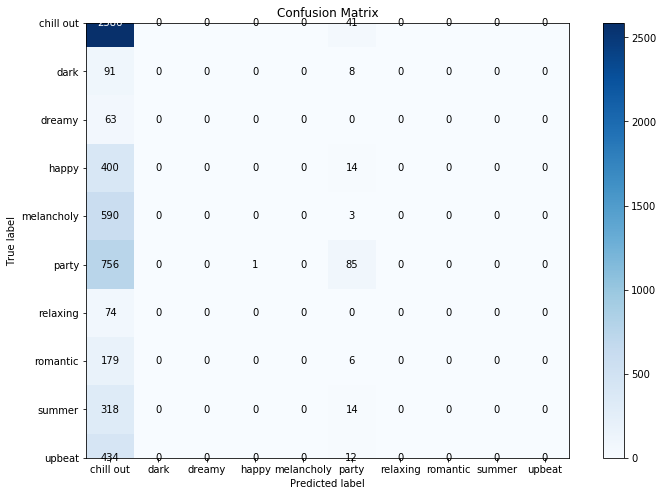

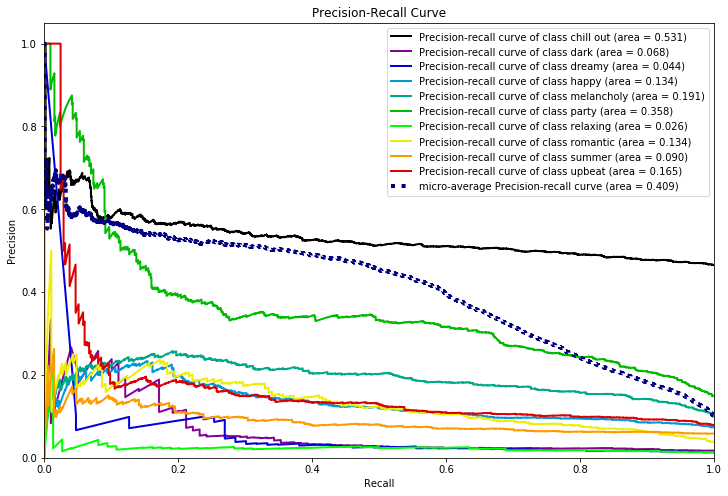

In [187]:

def evaluate_features(X, y, clf=None):
    """General helper function for evaluating effectiveness of passed features in ML model
    
    Prints out Log loss, accuracy, and confusion matrix with 3-fold stratified cross-validation
    
    Args:
        X (array-like): Features array. Shape (n_samples, n_features)
        
        y (array-like): Labels array. Shape (n_samples,)
        
        clf: Classifier to use. If None, default Log reg is use.
    """
    if clf is None:
        clf = LogisticRegression()
    
    probas = cross_val_predict(clf, X, y, cv=StratifiedKFold(random_state=8), 
                              n_jobs=-1, method='predict_proba', verbose=2)
    pred_indices = np.argmax(probas, axis=1)
    classes = np.unique(y)
    preds = classes[pred_indices]
    print('Log loss: {}'.format(log_loss(y, probas)))
    print('Accuracy: {}'.format(accuracy_score(y, preds)))
    skplt.metrics.plot_confusion_matrix(y, preds, figsize=(12,8))
    skplt.metrics.plot_precision_recall_curve(y, probas, figsize=(12,8))
    plt.show()


evaluate_features(truncated_tfidf, cleaned_lyrics_labels_train['mood'].values.ravel())


/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:629: FutureWarning: The default value of n_split will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(NSPLIT_WARNING, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   14.7s finished
/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/utils/deprecation.py:85: DeprecationWarning: Function plot_precision_recall_curve is deprecated; This will be removed in v0.5.0. Please use scikitplot.metrics.plot_precision_recall instead.
  warnings.warn(msg, category=DeprecationWarning)


Log loss: 1.0156958842484436
Accuracy: 0.7129515418502202


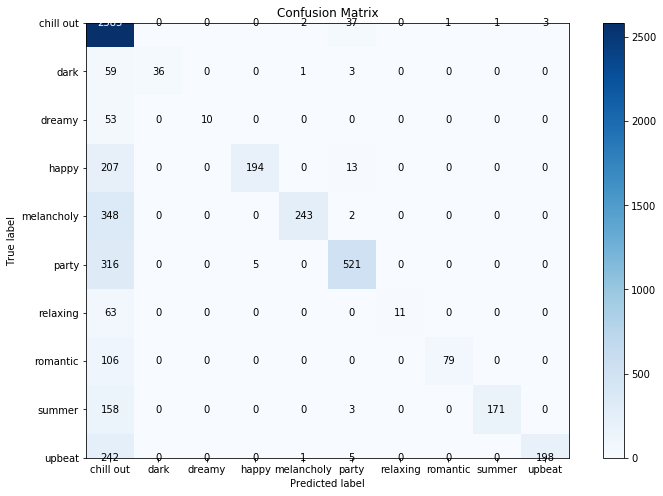

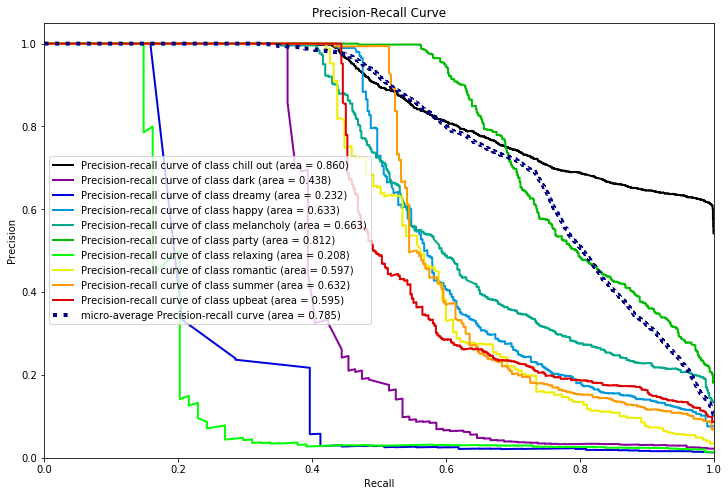

In [202]:
evaluate_features(truncated_tfidf, cleaned_lyrics_labels_train['mood'].values.ravel(), 
                  RandomForestClassifier(n_estimators=1000, max_depth=25, verbose=1))

From the confusion matrix, we can see that the class labels are unweighted. So we try to fix this problem by using boosting method. While by using Adaboost method, the cross validation accuracy is slightly lower than the randomforest classifier. It doesn't really fix the problem. So we stick to the original randomforest classifier for the lyrics training.

/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:629: FutureWarning: The default value of n_split will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(NSPLIT_WARNING, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:  1.0min finished
/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/utils/deprecation.py:85: DeprecationWarning: Function plot_precision_recall_curve is deprecated; This will be removed in v0.5.0. Please use scikitplot.metrics.plot_precision_recall instead.
  warnings.warn(msg, category=DeprecationWarning)


Log loss: 1.312700092037899
Accuracy: 0.7115418502202643


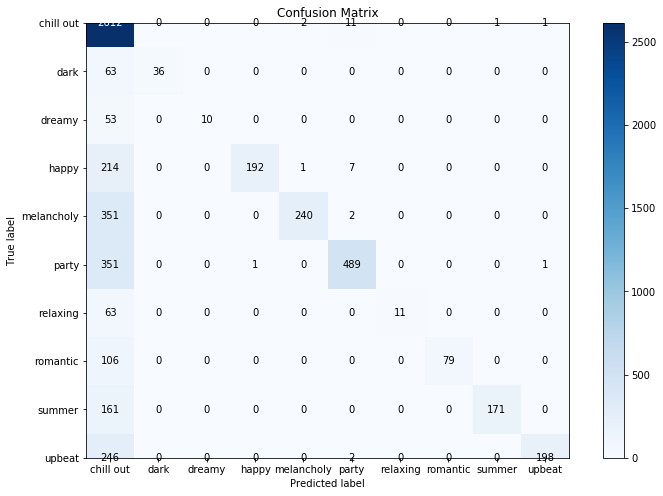

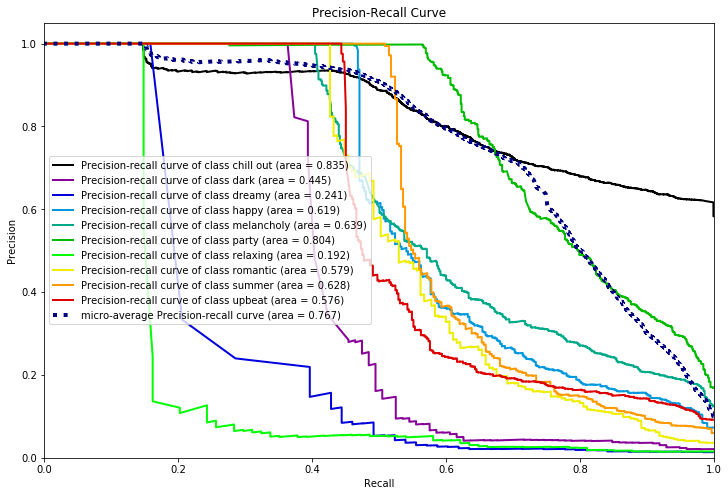

In [198]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier

evaluate_features(truncated_tfidf, cleaned_lyrics_labels_train['mood'].values.ravel(), 
                  AdaBoostClassifier(algorithm='SAMME.R', base_estimator=DecisionTreeClassifier(max_depth=25),
        learning_rate=1.0, n_estimators=1000, random_state=209))

/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:629: FutureWarning: The default value of n_split will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(NSPLIT_WARNING, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:  1.0min finished
/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/utils/deprecation.py:85: DeprecationWarning: Function plot_precision_recall_curve is deprecated; This will be removed in v0.5.0. Please use scikitplot.metrics.plot_precision_recall instead.
  warnings.warn(msg, category=DeprecationWarning)


Log loss: 1.1731944088968267
Accuracy: 0.6597356828193832


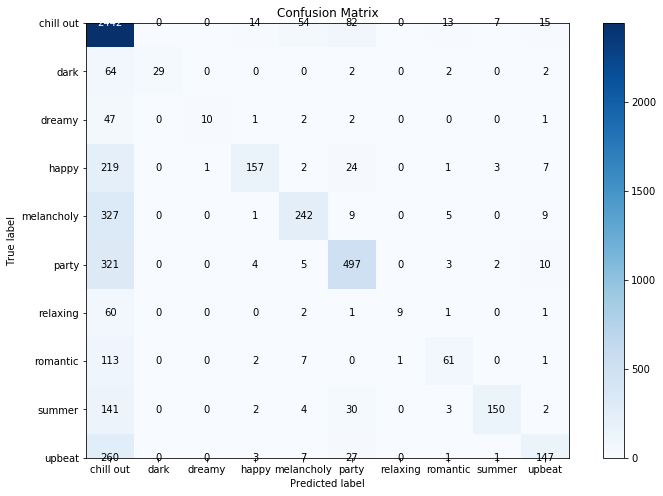

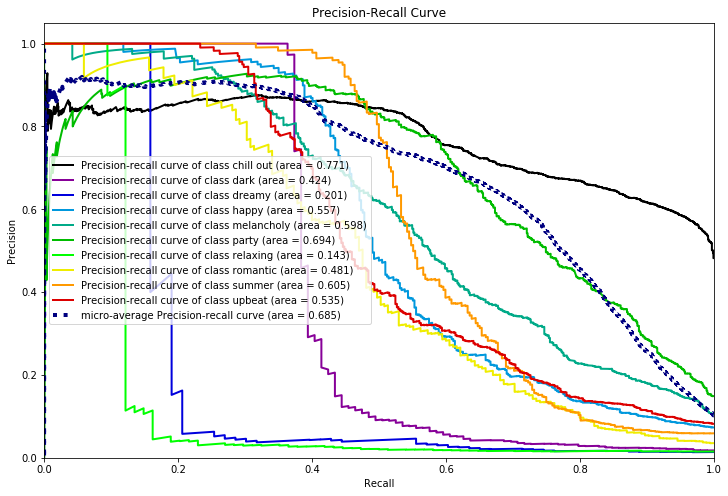

In [191]:
evaluate_features(tfidf, cleaned_lyrics_labels_train['mood'].values.ravel(), 
                  SVC(kernel='linear', probability=True))

Try using word2vec for training moods of lyrics

In [203]:
df_train, df_test = train_test_split(cleaned_lyrics_labels, test_size=0.2, random_state=8, stratify=cleaned_lyrics_labels['mood'])
df_train.shape

(5675, 4)

In [204]:
class MySentences(object):

    def __init__(self, *arrays):
        self.arrays = arrays
 
    def __iter__(self):
        for array in self.arrays:
            for document in array:
                for sent in nltk.sent_tokenize(document):
                    yield nltk.word_tokenize(sent)

def get_word2vec(sentences, location):

    if os.path.exists(location):
        print('Found {}'.format(location))
        model = gensim.models.Word2Vec.load(location)
        return model
    
    print('{} not found. training model'.format(location))
    model = gensim.models.Word2Vec(sentences, size=100, window=5, min_count=5, workers=4)
    print('Model done training. Saving to disk')
    model.save(location)
    return model

In [205]:
w2vec = get_word2vec(
    MySentences(
        df_train['Lyrics'].values, 
        #df_test['Lyrics'].values  
    ),
    'w2vmodel'
)

w2vmodel not found. training model
Model done training. Saving to disk


In [206]:
class MyTokenizer:
    def __init__(self):
        pass
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
        for document in X:
            tokenized_doc = []
            for sent in nltk.sent_tokenize(document):
                tokenized_doc += nltk.word_tokenize(sent)
            transformed_X.append(np.array(tokenized_doc))
        return np.array(transformed_X)
    
    def fit_transform(self, X, y=None):
        return self.transform(X)

class MeanEmbeddingVectorizer(object):
    def __init__(self, word2vec):
        self.word2vec = word2vec
        # if a text is empty we should return a vector of zeros
        # with the same dimensionality as all the other vectors
        self.dim = len(word2vec.wv.syn0[0])

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X = MyTokenizer().fit_transform(X)
        
        return np.array([
            np.mean([self.word2vec.wv[w] for w in words if w in self.word2vec.wv]
                    or [np.zeros(self.dim)], axis=0)
            for words in X
        ])
    
    def fit_transform(self, X, y=None):
        return self.transform(X)

In [207]:
mean_embedding_vectorizer = MeanEmbeddingVectorizer(w2vec)
mean_embedded = mean_embedding_vectorizer.fit_transform(df_train['Lyrics'])

/Users/weiruchen/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:25: DeprecationWarning: Call to deprecated `syn0` (Attribute will be removed in 4.0.0, use self.vectors instead).


/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:629: FutureWarning: The default value of n_split will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(NSPLIT_WARNING, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    2.7s finished
/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/utils/deprecation.py:85: DeprecationWarning: Function plot_precision_recall_curve is deprecated; This will be removed in v0.5.0. Please use scikitplot.metrics.plot_precision_recall instead.
  warnings.warn(msg, category=DeprecationWarning)


Log loss: 1.5487165970989094
Accuracy: 0.47559471365638767


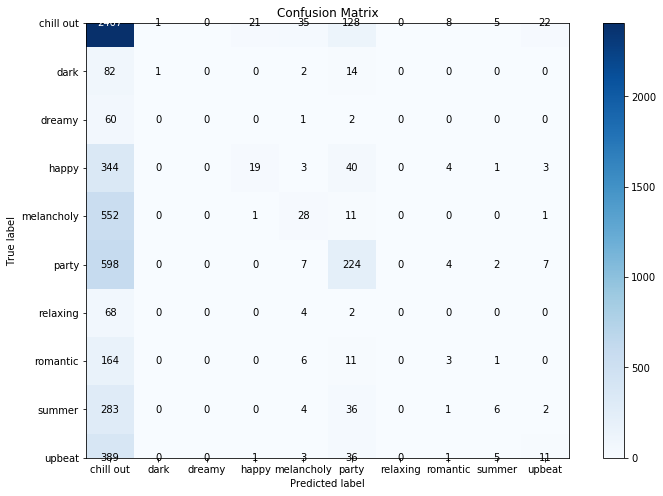

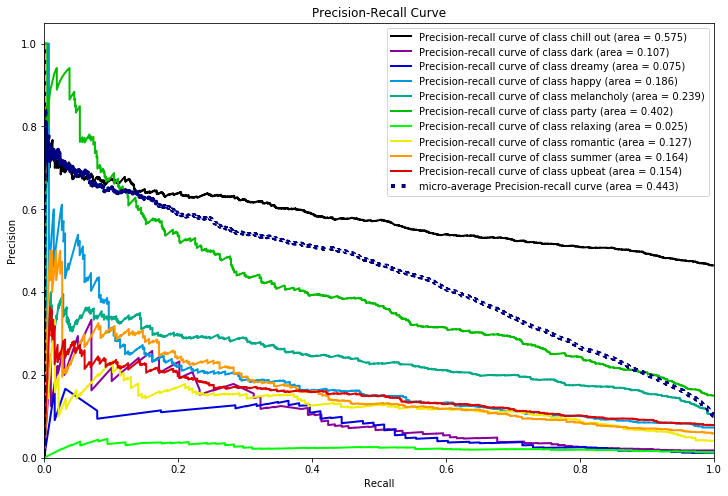

In [208]:
evaluate_features(mean_embedded, df_train['mood'].values.ravel())

/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:629: FutureWarning: The default value of n_split will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(NSPLIT_WARNING, FutureWarning)
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   26.9s finished
/Users/weiruchen/anaconda3/lib/python3.7/site-packages/sklearn/utils/deprecation.py:85: DeprecationWarning: Function plot_precision_recall_curve is deprecated; This will be removed in v0.5.0. Please use scikitplot.metrics.plot_precision_recall instead.
  warnings.warn(msg, category=DeprecationWarning)


Log loss: 1.010811282798153
Accuracy: 0.7161233480176211


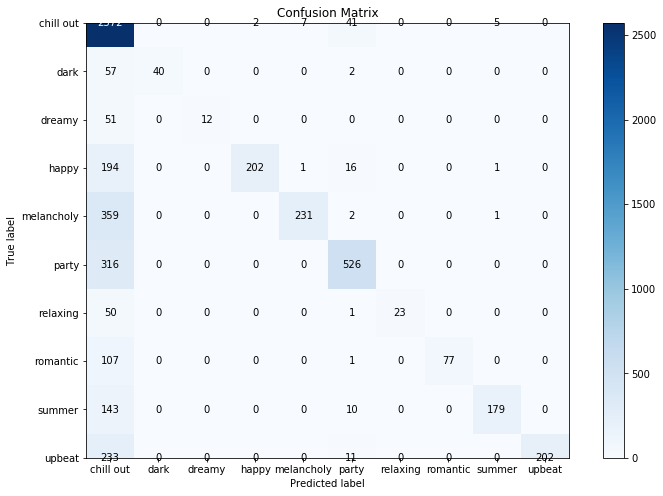

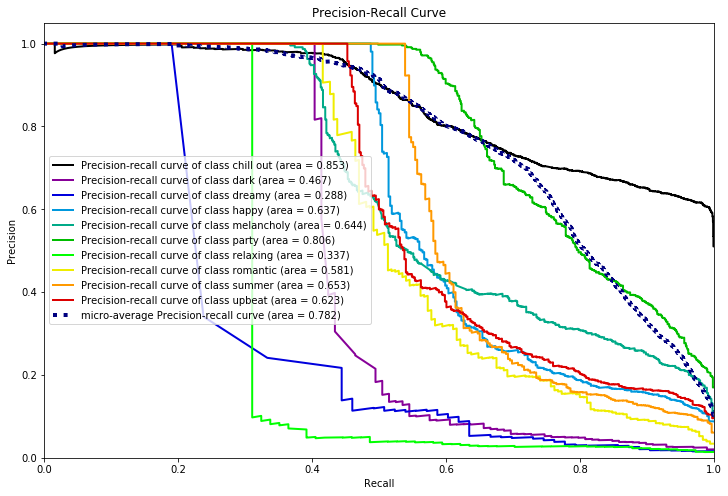

In [209]:
evaluate_features(mean_embedded, df_train['mood'].values.ravel(),
                  RandomForestClassifier(n_estimators=1000, max_depth=20, verbose=1))

Random Sampling 10 Songs for Each Mood as Base Recommendation

In [210]:
df1 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "chill out"]
df2 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "melancholy"]
df3 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "happy"]
df4 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "romantic"]
df5 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "upbeat"]
df6 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "dark"]
df7 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "dreamy"]
df8 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "party"]
df9 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "relaxing"]
df10 = cleaned_lyrics_labels[cleaned_lyrics_labels['mood'] == "summer"]

In [213]:
songs_chill_out = df1.sample(n=10, random_state=1)
songs_melancholy = df2.sample(n=10, random_state=1)
songs_happy = df3.sample(n=10, random_state=1)
songs_romantic = df4.sample(n=10, random_state=1)
songs_upbeat = df5.sample(n=10, random_state=1)
songs_dark = df6.sample(n=10, random_state=1)
songs_dreamy = df7.sample(n=10, random_state=1)
songs_party = df8.sample(n=10, random_state=1)
songs_relaxing = df9.sample(n=10, random_state=1)
songs_summer = df10.sample(n=10, random_state=1)

In [215]:
songs_melancholy.head()

,Title,Artist,Lyrics,mood
2744,Everything You Want,Vertical Horizon,Somewhere there's speaking It's already com...,melancholy
3763,On My Own,Three Days Grace,I walk alone think of home Memories of long...,melancholy
5189,1-800-273-8255,Logic,I've been on the low I been taking my time ...,melancholy
4862,Save Me,XXXTENTACION,Up there (Yeah) Who do I have? Heaven and h...,melancholy
7002,My Everything,Ariana Grande,I cried enough tears to see my own reflecti...,melancholy
